## This notebook is purely made to conduct analyses in. The code is commented, but, in general, explanation, conclusions and context is given in the report that belongs to this notebook.

In [1]:
# Import required Python packages and modules
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import random
# Set the random seed
seed = 44
random.seed(seed)
np.random.seed(seed)

# Loading data

In [2]:
refugeeorigin_worldrisk = pd.read_csv('refugeeorigin_worldrisk.csv')
refugeedestination_worldrisk = pd.read_csv('refugeedestination_worldrisk.csv')

In [3]:
refugeedestination_worldrisk

,Code,Year,#refugees_destination,Country,W,E,V,S,C,A,...,AI_04a_Norm,AI_04a_Base,AI_04b_Norm,AI_04b_Base,AI_04c_Norm,AI_04c_Base,AI_05a_Norm,AI_05a_Base,AI_05b_Norm,AI_05b_Base
0,AFG,2003,24,Afghanistan,4.22,0.25,71.17,62.53,74.70,77.17,...,77.27,41,83.88,41,92.14,6,69.97,252.88,86.91,35.7
1,AFG,2004,31,Afghanistan,4.20,0.25,70.48,63.15,73.40,75.53,...,72.62,50,71.58,50,100.00,2,73.91,184.09,77.87,16.4
2,AFG,2005,31,Afghanistan,4.12,0.25,67.94,62.22,69.49,72.54,...,71.87,58,71.73,58,100.00,9,73.35,203.37,67.55,10.6
3,AFG,2006,34,Afghanistan,4.14,0.25,68.48,61.59,75.41,69.13,...,71.07,58,71.09,58,86.07,18,77.87,179.24,56.41,6.8
4,AFG,2007,43,Afghanistan,4.17,0.25,69.62,61.97,76.98,70.73,...,70.00,63,69.70,63,100.00,4,77.87,200.60,62.88,8.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3092,ZWE,2018,7795,Zimbabwe,2.50,0.20,31.27,30.67,15.24,65.41,...,44.93,89,43.43,89,45.21,78,81.55,271.45,70.58,10.6
3093,ZWE,2019,8956,Zimbabwe,2.55,0.20,32.58,32.41,15.45,69.09,...,43.26,90,41.92,90,51.49,75,82.72,245.70,93.27,255.3
3094,ZWE,2020,9261,Zimbabwe,2.54,0.20,32.23,31.81,15.39,68.36,...,44.29,86,43.58,86,49.38,74,84.04,210.90,92.64,557.2
3095,ZWE,2021,9483,Zimbabwe,2.53,0.20,32.04,31.69,15.34,67.64,...,43.86,86,43.35,86,48.28,74,82.72,288.13,89.84,98.5


In [4]:
refugeeorigin_worldrisk.columns

Index(['Country', 'Code', 'Year', '#refugees_origin', 'W', 'E', 'V', 'S', 'C',
       'A',
       ...
       'AI_04a_Norm', 'AI_04a_Base', 'AI_04b_Norm', 'AI_04b_Base',
       'AI_04c_Norm', 'AI_04c_Base', 'AI_05a_Norm', 'AI_05a_Base',
       'AI_05b_Norm', 'AI_05b_Base'],
      dtype='object', length=248)

In [5]:
refugeedestination_worldrisk.columns

Index(['Code', 'Year', '#refugees_destination', 'Country', 'W', 'E', 'V', 'S',
       'C', 'A',
       ...
       'AI_04a_Norm', 'AI_04a_Base', 'AI_04b_Norm', 'AI_04b_Base',
       'AI_04c_Norm', 'AI_04c_Base', 'AI_05a_Norm', 'AI_05a_Base',
       'AI_05b_Norm', 'AI_05b_Base'],
      dtype='object', length=248)

# Correlation matrix analysis

Start with Pearson correlation

Giving the abstract variable codes, names:

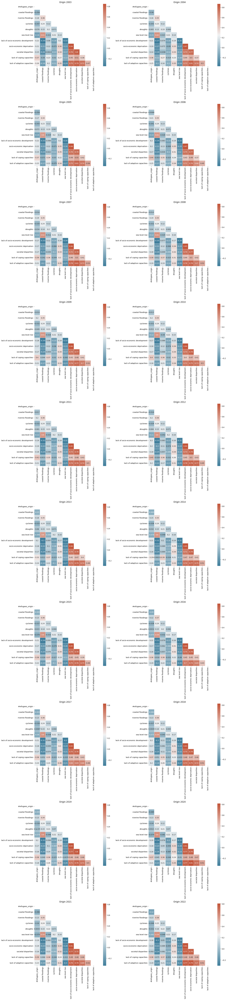

In [6]:
# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Filter data
refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate correlation matrix
    corr_matrix_origin = data_origin_year.corr(method='pearson')
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
    axes[row, col].set_title(f'Origin {year}')
    
# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

With only significant coefficients now.

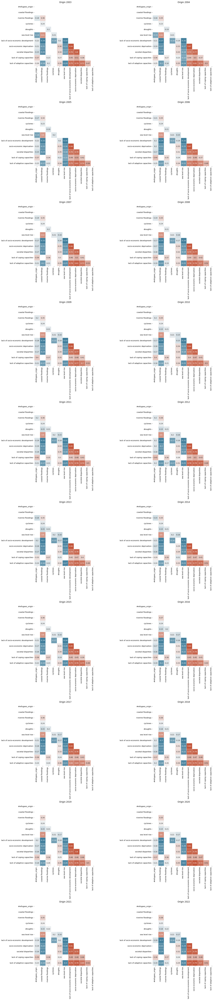

In [7]:
from scipy.stats import pearsonr

# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframe
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin (ensure 'coastal floodings' is included)
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Pearson correlation matrix and p-values
    corr_matrix_origin = data_origin_year.corr(method='pearson')
    p_values = np.zeros_like(corr_matrix_origin)

    for j in range(len(columns_of_interest_origin)):
        for k in range(j + 1, len(columns_of_interest_origin)):
            corr, p_value = pearsonr(data_origin_year[columns_of_interest_origin[j]], data_origin_year[columns_of_interest_origin[k]])
            #print(year, corr, p_value)
            p_values[j, k] = p_value
            p_values[k, j] = p_value
    
    # Create a mask to hide non-significant correlations (p >= 0.05)
    sig_mask = p_values < 0.05
    corr_matrix_origin[~sig_mask] = np.nan
    
    # Create a mask to hide the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col], cbar=False)
    axes[row, col].set_title(f'Origin {year}')
    
    # Set x and y tick labels
    axes[row, col].set_xticklabels(columns_of_interest_origin, rotation=90, ha='right')
    axes[row, col].set_yticklabels(columns_of_interest_origin, rotation=0)

# Hide any empty subplots and adjust layout
for j in range(len(years), 10 * 2):
    fig.delaxes(axes.flatten()[j])

plt.tight_layout()
plt.show()

Spearman correlation below

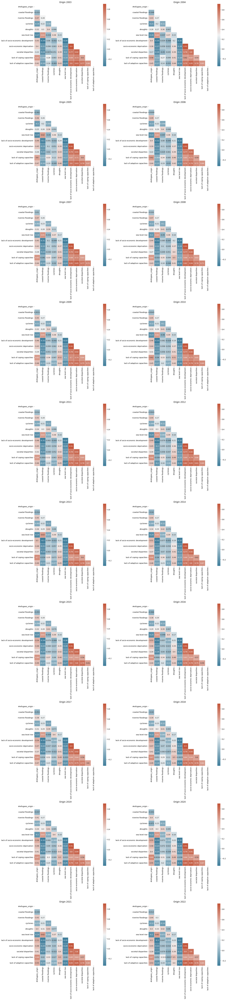

In [8]:
# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Filter data
refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Spearman correlation matrix
    corr_matrix_origin = data_origin_year.corr(method='spearman')
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
    axes[row, col].set_title(f'Origin {year}')
    
# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Only showing significant coefficients

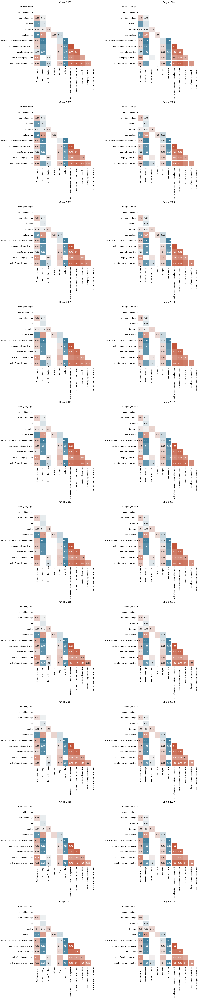

In [9]:
from scipy.stats import spearmanr

# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Filter data
refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Spearman correlation matrix
    corr_matrix_origin = data_origin_year.corr(method='spearman')
    
    # Compute p-values
    p_values = np.zeros_like(corr_matrix_origin)
    for row in range(corr_matrix_origin.shape[0]):
        for col in range(corr_matrix_origin.shape[1]):
            if row != col:
                corr, p_values[row, col] = spearmanr(data_origin_year.iloc[:, row], data_origin_year.iloc[:, col])
                #print(year, corr, p_values[row, col])
            else:
                p_values[row, col] = 1  # Diagonal elements are not shown

    # Mask non-significant correlations
    sig_mask = p_values < 0.05
    corr_matrix_origin[~sig_mask] = np.nan

    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))

    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)

    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[i//2, i%2], cbar=False)
    axes[i//2, i%2].set_title(f'Origin {year}')
    axes[i//2, i%2].tick_params(axis='x', rotation=90)
    axes[i//2, i%2].tick_params(axis='y', rotation=0)

# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Kendall correlation below

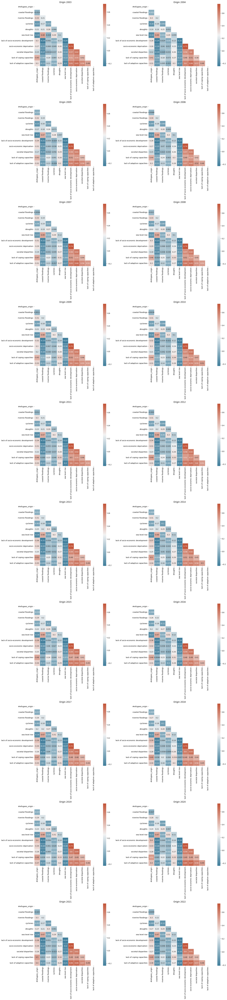

In [10]:
# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Filter data
refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Spearman correlation matrix
    corr_matrix_origin = data_origin_year.corr(method='kendall')
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
    axes[row, col].set_title(f'Origin {year}')
    
# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Only showing significant coefficients

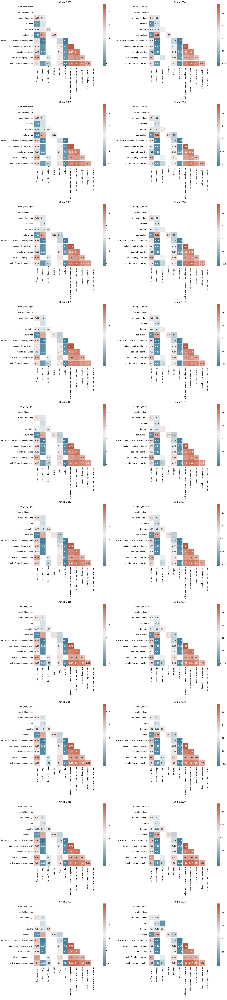

In [11]:
from scipy.stats import kendalltau

# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Filter data
refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Kendall correlation matrix
    corr_matrix_origin = data_origin_year.corr(method='kendall')
    #print(corr_matrix_origin)
    
    # Compute p-values
    p_values = np.zeros_like(corr_matrix_origin)
    for row_idx in range(corr_matrix_origin.shape[0]):
        for col_idx in range(corr_matrix_origin.shape[1]):
            if row_idx != col_idx:
                corr, p_values[row_idx, col_idx] = kendalltau(data_origin_year.iloc[:, row_idx], data_origin_year.iloc[:, col_idx])
                #print(year, corr, p_values[row_idx, col_idx])
            else:
                p_values[row_idx, col_idx] = 1  # Diagonal elements are not shown

    # Mask non-significant correlations
    sig_mask = p_values < 0.05
    corr_matrix_origin[~sig_mask] = np.nan

    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))

    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)

    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[i//2, i%2], cbar=True)
    axes[i//2, i%2].set_title(f'Origin {year}')
    axes[i//2, i%2].tick_params(axis='x', rotation=90)
    axes[i//2, i%2].tick_params(axis='y', rotation=0)

# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()

# Save the figure
#plt.savefig('origin_kendall_corr.png', dpi=300)

# Show the plot
plt.show()

Below, distance based correlation

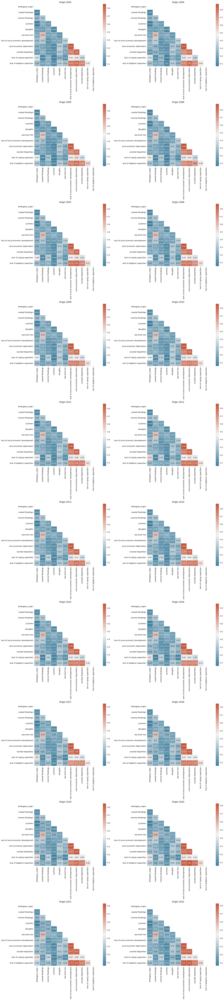

In [12]:
from sklearn.preprocessing import StandardScaler
from dcor import distance_correlation

# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Filter data
refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Standardize data
    scaler = StandardScaler()
    data_origin_year_scaled = scaler.fit_transform(data_origin_year)
    data_origin_year_scaled = pd.DataFrame(data_origin_year_scaled, columns=data_origin_year.columns)
    
    # Calculate distance correlation matrix
    corr_matrix_origin = data_origin_year_scaled.corr(method=lambda x, y: distance_correlation(x, y))
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
    axes[row, col].set_title(f'Origin {year}')
    
# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Same result below, but with another package, because dsor lib does not provide significance option.

In [13]:
# Run time of code below is good, correct, but very long.

In [14]:
# from sklearn.preprocessing import StandardScaler
# import pingouin as pg

# # Define new column names for origin
# column_name_mapping_origin = {
#     '#refugees_origin': '#refugees_origin',
#     'EI_03': 'coastal floodings',
#     'EI_04': 'riverine floodings',
#     'EI_05': 'cyclones',
#     'EI_06': 'droughts',
#     'EI_07': 'sea level rise',
#     'S_01': 'lack of socio-economic development',
#     'S_02': 'socio-economic deprivation',
#     'S_03': 'societal disparities',
#     'C': 'lack of coping capacities',
#     'A': 'lack of adaptive capacities'
# }

# # Rename columns in the dataframes
# refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# # Columns of interest for origin
# columns_of_interest_origin = list(column_name_mapping_origin.values())

# # Filter data
# refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# # Split data by year
# years = sorted(refugeeorigin_worldrisk['Year'].unique())

# # Create a figure to hold all subplots for origin, 10 rows and 2 columns
# fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
# fig.set_tight_layout(True)

# # Iterate over each year and create correlation plots for origin
# for i, year in enumerate(years):
#     # Determine the position in the grid
#     row = i // 2
#     col = i % 2
    
#     # Filter data for the specific year
#     data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
#     # Standardize data
#     scaler = StandardScaler()
#     data_origin_year_scaled = scaler.fit_transform(data_origin_year)
#     data_origin_year_scaled = pd.DataFrame(data_origin_year_scaled, columns=data_origin_year.columns)
    
#     # Calculate distance correlation matrix
#     corr_matrix_origin = data_origin_year_scaled.corr(method=lambda x, y: pg.distance_corr(x, y)[0])
    
#     # Create upper triangular matrix to mask the upper triangular part of the heatmap
#     corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))
    
#     # Generate a custom diverging colormap
#     corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
#     # Plot correlation matrix for origin
#     sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col], cbar=False)
#     axes[row, col].set_title(f'Origin {year}')
#     axes[row, col].tick_params(axis='x', rotation=90)
#     axes[row, col].tick_params(axis='y', rotation=0)

# # Hide any empty subplots
# for j in range(i+1, 20):
#     fig.delaxes(axes.flatten()[j])

# # Adjust layout
# plt.tight_layout()
# plt.show()

Only with significant coefficient, but with another package, because dsor lib does not provide this significance option.

In [15]:
# Run time of code below is good, correct, but very long.

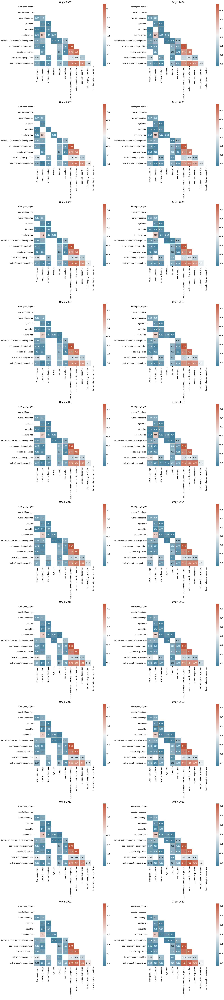

In [16]:
from sklearn.preprocessing import StandardScaler
import pingouin as pg

# Define new column names for origin
column_name_mapping_origin = {
    '#refugees_origin': '#refugees_origin',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeeorigin_worldrisk = refugeeorigin_worldrisk.rename(columns=column_name_mapping_origin)

# Columns of interest for origin
columns_of_interest_origin = list(column_name_mapping_origin.values())

# Filter data
refugeeorigin_worldrisk = refugeeorigin_worldrisk[['Year'] + columns_of_interest_origin]

# Split data by year
years = sorted(refugeeorigin_worldrisk['Year'].unique())

# Create a figure to hold all subplots for origin, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for origin
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_origin_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Standardize data
    scaler = StandardScaler()
    data_origin_year_scaled = scaler.fit_transform(data_origin_year)
    data_origin_year_scaled = pd.DataFrame(data_origin_year_scaled, columns=data_origin_year.columns)
    
    # Calculate distance correlation matrix and p-values
    corr_matrix_origin = data_origin_year_scaled.corr(method=lambda x, y: pg.distance_corr(x, y)[0])
    p_values = data_origin_year_scaled.corr(method=lambda x, y: pg.distance_corr(x, y)[1])
    
    # Mask non-significant correlations
    sig_mask = p_values < 0.05
    corr_matrix_origin[~sig_mask] = np.nan
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_origin, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for origin
    sns.heatmap(corr_matrix_origin, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col], cbar=True)
    axes[row, col].set_title(f'Origin {year}')
    axes[row, col].tick_params(axis='x', rotation=90)
    axes[row, col].tick_params(axis='y', rotation=0)

# Hide any empty subplots
for j in range(i + 1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Now for destination data below

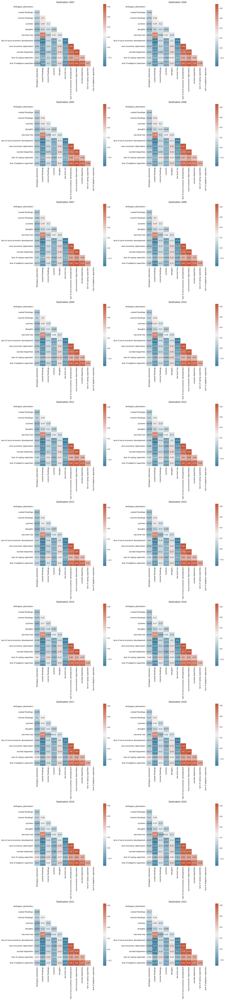

In [17]:
# Define new column names for destination
column_name_mapping_destination = {
    '#refugees_destination': '#refugees_destination',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# Columns of interest for destination
columns_of_interest_destination = list(column_name_mapping_destination.values())

# Filter data
refugeedestination_worldrisk = refugeedestination_worldrisk[['Year'] + columns_of_interest_destination]

# Split data by year
years = sorted(refugeedestination_worldrisk['Year'].unique())

# Create a figure to hold all subplots for destination, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for destination
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate correlation matrix
    corr_matrix_destination = data_destination_year.corr(method='pearson')
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for destination
    sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
    axes[row, col].set_title(f'Destination {year}')
    
# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Only with significant coefficients

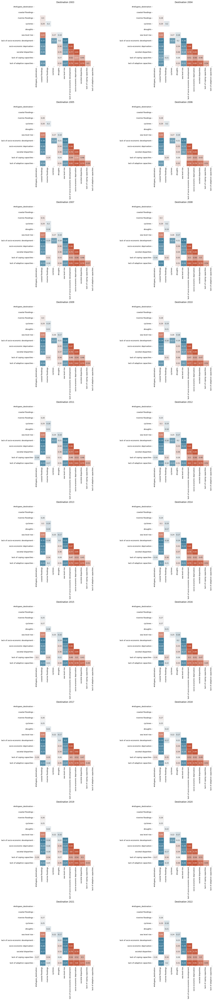

In [18]:
from scipy.stats import pearsonr

# Define new column names for destination
column_name_mapping_destination = {
    '#refugees_destination': '#refugees_destination',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframe
refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# Columns of interest for destination (ensure 'coastal floodings' is included)
columns_of_interest_destination = list(column_name_mapping_destination.values())

# Split data by year
years = sorted(refugeedestination_worldrisk['Year'].unique())

# Create a figure to hold all subplots for destination, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))

# Iterate over each year and create correlation plots for destination
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Pearson correlation matrix and p-values
    corr_matrix_destination = data_destination_year.corr(method='pearson')
    p_values = np.zeros_like(corr_matrix_destination)

    for j in range(len(columns_of_interest_destination)):
        for k in range(j + 1, len(columns_of_interest_destination)):
            corr, p_value = pearsonr(data_destination_year[columns_of_interest_destination[j]], data_destination_year[columns_of_interest_destination[k]])
            #print(year, corr, p_value)
            p_values[j, k] = p_value
            p_values[k, j] = p_value
    
    # Create a mask to hide non-significant correlations (p >= 0.05)
    sig_mask = p_values < 0.05
    corr_matrix_destination[~sig_mask] = np.nan
    
    # Create a mask to hide the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for destination
    sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col], cbar=False)
    axes[row, col].set_title(f'Destination {year}')
    
    # Set x and y tick labels
    axes[row, col].set_xticklabels(columns_of_interest_destination, rotation=90, ha='right')
    axes[row, col].set_yticklabels(columns_of_interest_destination, rotation=0)

# Hide any empty subplots and adjust layout
for j in range(len(years), 10 * 2):
    fig.delaxes(axes.flatten()[j])

plt.tight_layout()
plt.show()

Spearman correlation below

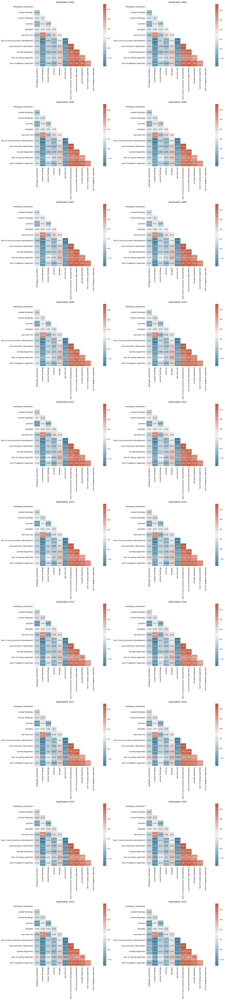

In [19]:
# Define new column names for destination
column_name_mapping_destination = {
    '#refugees_destination': '#refugees_destination',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# Columns of interest for destination
columns_of_interest_destination = list(column_name_mapping_destination.values())

# Filter data
refugeedestination_worldrisk = refugeedestination_worldrisk[['Year'] + columns_of_interest_destination]

# Split data by year
years = sorted(refugeedestination_worldrisk['Year'].unique())

# Create a figure to hold all subplots for destination, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for destination
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate correlation matrix
    corr_matrix_destination = data_destination_year.corr(method='spearman')
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for destination
    sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
    axes[row, col].set_title(f'Destination {year}')
    
# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Only with significant coefficients

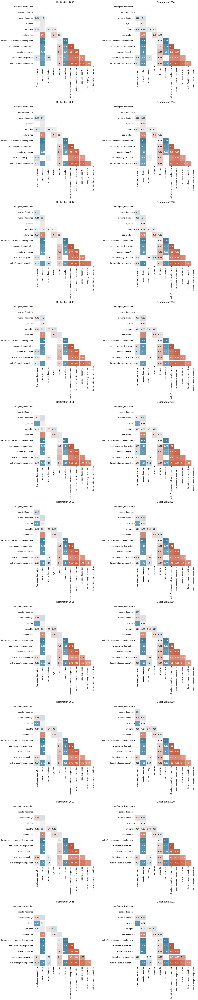

In [20]:
from scipy.stats import spearmanr

# Define new column names for destination
column_name_mapping_destination = {
    '#refugees_destination': '#refugees_destination',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframe
refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# Columns of interest for destination
columns_of_interest_destination = list(column_name_mapping_destination.values())

# Filter data
refugeedestination_worldrisk = refugeedestination_worldrisk[['Year'] + columns_of_interest_destination]

# Split data by year
years = sorted(refugeedestination_worldrisk['Year'].unique())

# Create a figure to hold all subplots for destination, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for destination
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Spearman correlation matrix
    corr_matrix_destination = data_destination_year.corr(method='spearman')
    
    # Compute p-values
    p_values = np.zeros_like(corr_matrix_destination)
    for row_idx in range(corr_matrix_destination.shape[0]):
        for col_idx in range(corr_matrix_destination.shape[1]):
            if row_idx != col_idx:
                corr, p_values[row_idx, col_idx] = spearmanr(data_destination_year.iloc[:, row_idx], data_destination_year.iloc[:, col_idx])
            else:
                p_values[row_idx, col_idx] = 1  # Diagonal elements are not shown

    # Mask non-significant correlations
    sig_mask = p_values < 0.05
    corr_matrix_destination[~sig_mask] = np.nan

    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))

    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)

    # Plot correlation matrix for destination
    sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col], cbar=False)
    axes[row, col].set_title(f'Destination {year}')
    axes[row, col].tick_params(axis='x', rotation=90)
    axes[row, col].tick_params(axis='y', rotation=0)

# Hide any empty subplots
for j in range(i + 1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Kendall correlation below

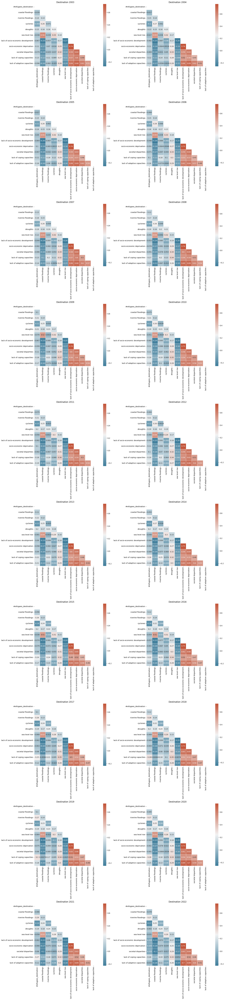

In [21]:
# Define new column names for destination
column_name_mapping_destination = {
    '#refugees_destination': '#refugees_destination',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# Columns of interest for destination
columns_of_interest_destination = list(column_name_mapping_destination.values())

# Filter data
refugeedestination_worldrisk = refugeedestination_worldrisk[['Year'] + columns_of_interest_destination]

# Split data by year
years = sorted(refugeedestination_worldrisk['Year'].unique())

# Create a figure to hold all subplots for destination, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for destination
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate correlation matrix
    corr_matrix_destination = data_destination_year.corr(method='kendall')
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for destination
    sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
    axes[row, col].set_title(f'Destination {year}')
    
# Hide any empty subplots
for j in range(i+1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Only with significant coefficients

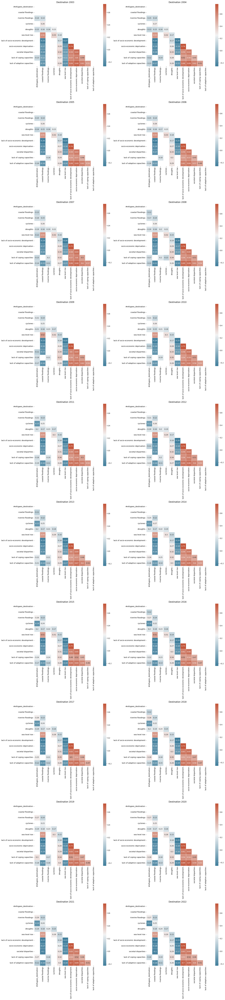

In [22]:
from scipy.stats import kendalltau

# Define new column names for destination
column_name_mapping_destination = {
    '#refugees_destination': '#refugees_destination',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframe
refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# Columns of interest for destination
columns_of_interest_destination = list(column_name_mapping_destination.values())

# Filter data
refugeedestination_worldrisk = refugeedestination_worldrisk[['Year'] + columns_of_interest_destination]

# Split data by year
years = sorted(refugeedestination_worldrisk['Year'].unique())

# Create a figure to hold all subplots for destination, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for destination
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate Kendall correlation matrix
    corr_matrix_destination = data_destination_year.corr(method='kendall')
    
    # Compute p-values
    p_values = np.zeros_like(corr_matrix_destination)
    for row_idx in range(corr_matrix_destination.shape[0]):
        for col_idx in range(corr_matrix_destination.shape[1]):
            if row_idx != col_idx:
                corr, p_values[row_idx, col_idx] = kendalltau(data_destination_year.iloc[:, row_idx], data_destination_year.iloc[:, col_idx])
            else:
                p_values[row_idx, col_idx] = 1  # Diagonal elements are not shown

    # Mask non-significant correlations
    sig_mask = p_values < 0.05
    corr_matrix_destination[~sig_mask] = np.nan

    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))

    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)

    # Plot correlation matrix for destination
    sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col], cbar=True)
    axes[row, col].set_title(f'Destination {year}')
    axes[row, col].tick_params(axis='x', rotation=90)
    axes[row, col].tick_params(axis='y', rotation=0)

# Hide any empty subplots
for j in range(i + 1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Update distance based correlation below

In [23]:
# Run time of code below is good, correct, but very long.

In [24]:
# from sklearn.preprocessing import StandardScaler
# from dcor import distance_correlation

# # Define new column names for destination
# column_name_mapping_destination = {
#     '#refugees_destination': '#refugees_destination',
#     'EI_03': 'coastal floodings',
#     'EI_04': 'riverine floodings',
#     'EI_05': 'cyclones',
#     'EI_06': 'droughts',
#     'EI_07': 'sea level rise',
#     'S_01': 'lack of socio-economic development',
#     'S_02': 'socio-economic deprivation',
#     'S_03': 'societal disparities',
#     'C': 'lack of coping capacities',
#     'A': 'lack of adaptive capacities'
# }

# # Rename columns in the dataframe
# refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# # Columns of interest for destination
# columns_of_interest_destination = list(column_name_mapping_destination.values())

# # Filter data
# refugeedestination_worldrisk = refugeedestination_worldrisk[['Year'] + columns_of_interest_destination]

# # Split data by year
# years = sorted(refugeedestination_worldrisk['Year'].unique())

# # Create a figure to hold all subplots for destination, 10 rows and 2 columns
# fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
# fig.set_tight_layout(True)

# # Iterate over each year and create correlation plots for destination
# for i, year in enumerate(years):
#     # Determine the position in the grid
#     row = i // 2
#     col = i % 2
    
#     # Filter data for the specific year
#     data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
#     # Standardize data
#     scaler = StandardScaler()
#     data_destination_year_scaled = scaler.fit_transform(data_destination_year)
#     data_destination_year_scaled = pd.DataFrame(data_destination_year_scaled, columns=data_destination_year.columns)
    
#     # Calculate distance correlation matrix
#     corr_matrix_destination = data_destination_year_scaled.corr(method=lambda x, y: distance_correlation(x, y))
    
#     # Create upper triangular matrix to mask the upper triangular part of the heatmap
#     corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))
    
#     # Generate a custom diverging colormap
#     corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
#     # Plot correlation matrix for destination
#     sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col])
#     axes[row, col].set_title(f'Destination {year}')
    
# # Hide any empty subplots
# for j in range(i + 1, 20):
#     fig.delaxes(axes.flatten()[j])

# # Adjust layout
# plt.tight_layout()
# plt.show()

Now only with significant coefficients.

In [25]:
# Code below is good, correct, but very long run time.

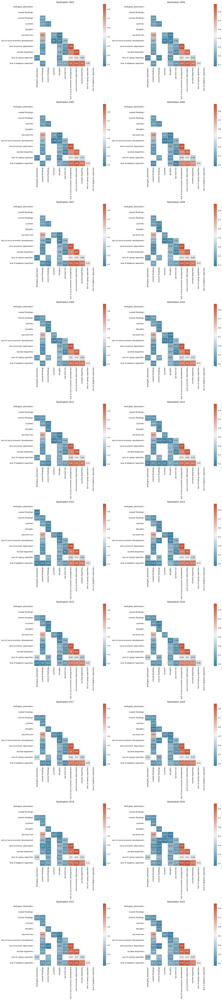

In [26]:
from sklearn.preprocessing import StandardScaler
import pingouin as pg

# Define new column names for destination
column_name_mapping_destination = {
    '#refugees_destination': '#refugees_destination',
    'EI_03': 'coastal floodings',
    'EI_04': 'riverine floodings',
    'EI_05': 'cyclones',
    'EI_06': 'droughts',
    'EI_07': 'sea level rise',
    'S_01': 'lack of socio-economic development',
    'S_02': 'socio-economic deprivation',
    'S_03': 'societal disparities',
    'C': 'lack of coping capacities',
    'A': 'lack of adaptive capacities'
}

# Rename columns in the dataframes
refugeedestination_worldrisk = refugeedestination_worldrisk.rename(columns=column_name_mapping_destination)

# Columns of interest for destination
columns_of_interest_destination = list(column_name_mapping_destination.values())

# Filter data
refugeedestination_worldrisk = refugeedestination_worldrisk[['Year'] + columns_of_interest_destination]

# Split data by year
years = sorted(refugeedestination_worldrisk['Year'].unique())

# Create a figure to hold all subplots for destination, 10 rows and 2 columns
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 80))
fig.set_tight_layout(True)

# Iterate over each year and create correlation plots for destination
for i, year in enumerate(years):
    # Determine the position in the grid
    row = i // 2
    col = i % 2
    
    # Filter data for the specific year
    data_destination_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Standardize data
    scaler = StandardScaler()
    data_destination_year_scaled = scaler.fit_transform(data_destination_year)
    data_destination_year_scaled = pd.DataFrame(data_destination_year_scaled, columns=data_destination_year.columns)
    
    # Calculate distance correlation matrix and p-values
    corr_matrix_destination = data_destination_year_scaled.corr(method=lambda x, y: pg.distance_corr(x, y)[0])
    p_values = data_destination_year_scaled.corr(method=lambda x, y: pg.distance_corr(x, y)[1])
    
    # Mask non-significant correlations
    sig_mask = p_values < 0.05
    corr_matrix_destination[~sig_mask] = np.nan
    
    # Create upper triangular matrix to mask the upper triangular part of the heatmap
    corr_mask = np.triu(np.ones_like(corr_matrix_destination, dtype=bool))
    
    # Generate a custom diverging colormap
    corr_cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    # Plot correlation matrix for destination
    sns.heatmap(corr_matrix_destination, mask=corr_mask, cmap=corr_cmap, annot=True, square=True, linewidths=.5, ax=axes[row, col], cbar=True)
    axes[row, col].set_title(f'Destination {year}')
    axes[row, col].tick_params(axis='x', rotation=90)
    axes[row, col].tick_params(axis='y', rotation=0)

# Hide any empty subplots
for j in range(i + 1, 20):
    fig.delaxes(axes.flatten()[j])

# Adjust layout
plt.tight_layout()
plt.show()

Let's now quanitfy, and use statistics, to interpretet what we can see in the correlation matrices above.

First, check histograms.

In [27]:
refugeedestination_worldrisk[refugeedestination_worldrisk['Year']==2003]

,Year,#refugees_destination,coastal floodings,riverine floodings,cyclones,droughts,sea level rise,lack of socio-economic development,socio-economic deprivation,societal disparities,lack of coping capacities,lack of adaptive capacities
0,2003,24,0.01,46.39,0.01,2.49,0.01,67.49,68.10,71.21,74.70,77.17
20,2003,24,59.66,28.13,0.01,0.18,25.77,51.80,14.10,39.87,47.08,41.69
40,2003,169032,1.68,24.97,0.01,37.18,43.03,48.03,33.63,39.48,52.96,46.51
60,2003,13375,23.41,31.91,0.01,63.23,36.51,60.66,66.09,73.76,60.73,74.42
82,2003,2631,36.45,54.69,0.01,42.02,27.13,38.38,29.99,51.07,11.18,43.72
...,...,...,...,...,...,...,...,...,...,...,...,...
3008,2003,62,47.18,34.43,0.16,30.69,55.41,44.60,34.77,57.98,13.30,55.49
3028,2003,15360,87.41,84.60,3.31,53.17,79.26,51.61,49.28,44.95,13.69,29.97
3037,2003,61876,46.36,22.88,0.01,60.15,25.97,60.50,55.28,81.36,12.92,64.10
3057,2003,226697,0.01,33.89,0.01,44.64,0.01,64.01,68.71,73.84,13.40,67.21


Text(0.5, 1.0, 'Drought numbers for all countries in 2003')

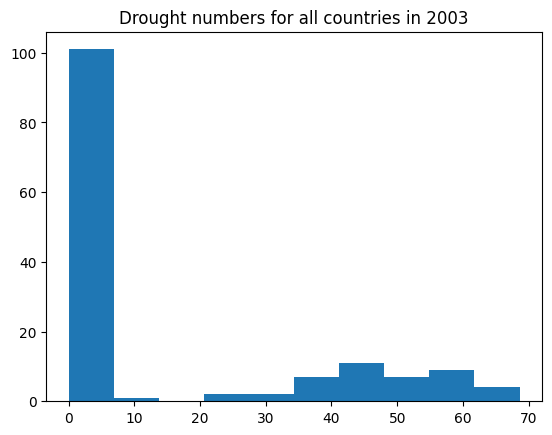

In [28]:
plt.hist(refugeedestination_worldrisk[refugeedestination_worldrisk['Year']==2003]['droughts'])
plt.title('Drought numbers for all countries in 2003')

Text(0.5, 1.0, 'Refugee destination (=fleeing to) numbers for all countries in 2003')

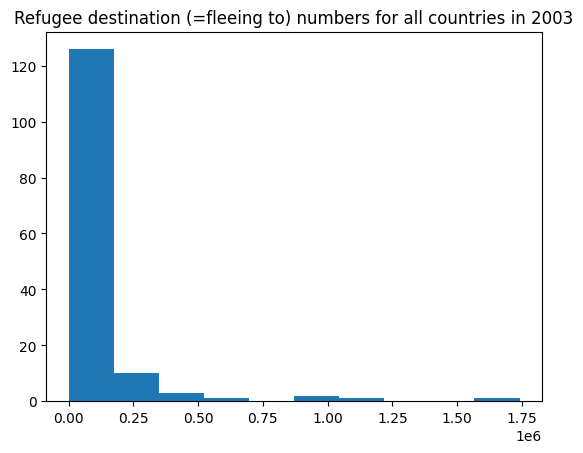

In [29]:
plt.hist(refugeedestination_worldrisk[refugeedestination_worldrisk['Year']==2003]['#refugees_destination'])
plt.title('Refugee destination (=fleeing to) numbers for all countries in 2003')

(array([2215.,   20.,    0.,   40.,   59.,  192.,  188.,  140.,  183.,
          60.]),
 array([1.0000e-02, 7.0670e+00, 1.4124e+01, 2.1181e+01, 2.8238e+01,
        3.5295e+01, 4.2352e+01, 4.9409e+01, 5.6466e+01, 6.3523e+01,
        7.0580e+01]),
 <BarContainer object of 10 artists>)

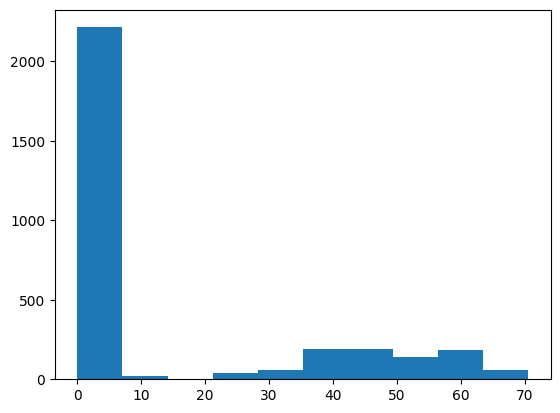

In [30]:
plt.hist(refugeedestination_worldrisk['droughts'])

(array([2886.,   89.,   48.,   27.,   17.,    4.,    8.,    8.,    3.,
           7.]),
 array([5.0000000e+00, 3.7598620e+05, 7.5196740e+05, 1.1279486e+06,
        1.5039298e+06, 1.8799110e+06, 2.2558922e+06, 2.6318734e+06,
        3.0078546e+06, 3.3838358e+06, 3.7598170e+06]),
 <BarContainer object of 10 artists>)

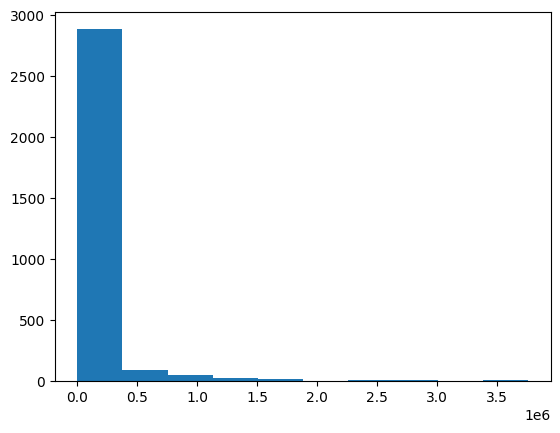

In [31]:
plt.hist(refugeedestination_worldrisk['#refugees_destination'])

(array([2938.,    0.,    0.,    0.,    0.,   22.,   20.,   12.,   65.,
          40.]),
 array([1.0000e-02, 8.9810e+00, 1.7952e+01, 2.6923e+01, 3.5894e+01,
        4.4865e+01, 5.3836e+01, 6.2807e+01, 7.1778e+01, 8.0749e+01,
        8.9720e+01]),
 <BarContainer object of 10 artists>)

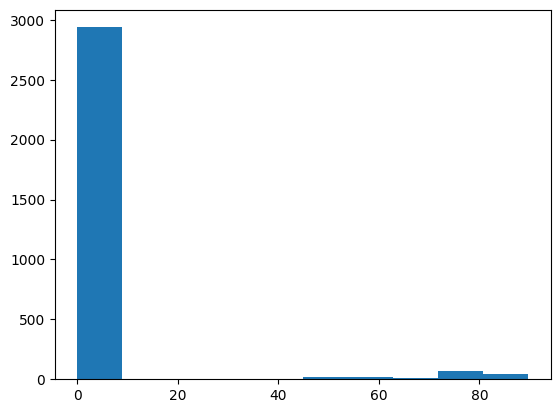

In [32]:
plt.hist(refugeedestination_worldrisk['cyclones'])

(array([3.485e+03, 3.800e+01, 6.000e+00, 2.300e+01, 4.000e+00, 1.000e+00,
        0.000e+00, 1.000e+00, 3.000e+00, 6.000e+00]),
 array([5.000000e+00, 6.848910e+05, 1.369777e+06, 2.054663e+06,
        2.739549e+06, 3.424435e+06, 4.109321e+06, 4.794207e+06,
        5.479093e+06, 6.163979e+06, 6.848865e+06]),
 <BarContainer object of 10 artists>)

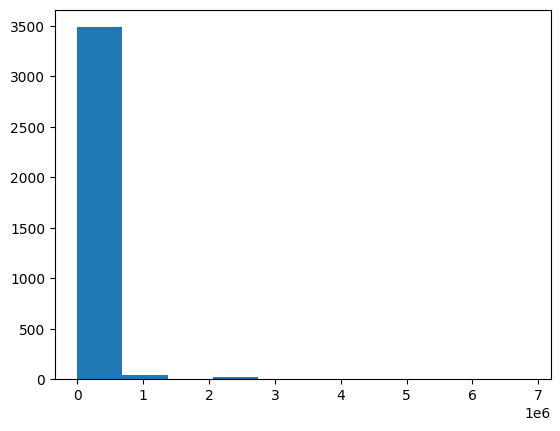

In [33]:
plt.hist(refugeeorigin_worldrisk['#refugees_origin'],bins=10)

Non-normality and outliers, so we cannot use Pearson correlation. Below, we go further with indentifyng trends in the Kendall correlation coefficients over years.

In [34]:
# Initialize a list to store correlation data for origin
correlation_data_origin = []

# Iterate over each year
years = sorted(refugeeorigin_worldrisk['Year'].unique())
for year in years:
    # Filter data for the specific year
    data_year = refugeeorigin_worldrisk[refugeeorigin_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate correlation with '#refugees_origin' for each indicator
    for col in data_year.columns:
        if col != '#refugees_origin':
            corr_coef = data_year['#refugees_origin'].corr(data_year[col], method='kendall')
            correlation_data_origin.append({'Year': year, 'Indicator': col, 'Correlation': corr_coef})
            
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
# Convert list to DataFrame
correlation_df_origin = pd.DataFrame(correlation_data_origin)

# Show or further process correlation_df_origin as needed
correlation_df_origin

,Year,Indicator,Correlation
0,2003,coastal floodings,-0.018749
1,2003,riverine floodings,0.325691
2,2003,cyclones,-0.133529
3,2003,droughts,0.212240
4,2003,sea level rise,-0.185808
...,...,...,...
195,2022,lack of socio-economic development,0.351929
196,2022,socio-economic deprivation,0.312321
197,2022,societal disparities,0.267879
198,2022,lack of coping capacities,0.485899


In [35]:
# Initialize a list to store correlation data for destination
correlation_data_destination = []

# Iterate over each year
years = sorted(refugeedestination_worldrisk['Year'].unique())
for year in years:
    # Filter data for the specific year
    data_year = refugeedestination_worldrisk[refugeedestination_worldrisk['Year'] == year].drop(columns=['Year'])
    
    # Calculate correlation with '#refugees_destination' for each indicator
    for col in data_year.columns:
        if col != '#refugees_destination':
            corr_coef = data_year['#refugees_destination'].corr(data_year[col], method='kendall')
            correlation_data_destination.append({'Year': year, 'Indicator': col, 'Correlation': corr_coef})

pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
# Convert list to DataFrame
correlation_df_destination = pd.DataFrame(correlation_data_destination)

# Show or further process correlation_df_destination as needed
correlation_df_destination

,Year,Indicator,Correlation
0,2003,coastal floodings,0.039367
1,2003,riverine floodings,0.138038
2,2003,cyclones,-0.083334
3,2003,droughts,0.145057
4,2003,sea level rise,0.037566
...,...,...,...
195,2022,lack of socio-economic development,-0.035198
196,2022,socio-economic deprivation,-0.042952
197,2022,societal disparities,-0.034642
198,2022,lack of coping capacities,0.159035


In [36]:
# Group correlations by Indicator for origin and destination
grouped_origin = correlation_df_origin.groupby('Indicator')
grouped_destination = correlation_df_destination.groupby('Indicator')

In [37]:
import matplotlib.pyplot as plt

# Define a function to plot correlation coefficients for each indicator as a scatter plot
def plot_coefficients_by_indicator_scatter(grouped_data, title):
    # Create a figure with subplots for each indicator
    indicators = grouped_data.groups.keys()
    num_indicators = len(indicators)
    if title == 'Correlation Coefficients for Origin Indicators':
        refugee = 'refugees fleeing from a country'
    else:
        refugee = 'refugees fleeing to a country'
    
    fig, axes = plt.subplots(nrows=num_indicators, ncols=1, figsize=(10, 5 * num_indicators))
    if num_indicators == 1:
        axes = [axes]  # Ensure axes is iterable
    
    # Iterate over each indicator group
    for ax, (indicator, group) in zip(axes, grouped_data):
        ax.scatter(group['Year'], group['Correlation'])
        ax.set_title(f'Correlation between {indicator} and {refugee} over time')
        ax.set_xlabel('Year')
        ax.set_ylabel('Correlation Coefficient')
        ax.grid(True)
    
    plt.tight_layout()
    plt.suptitle(title, y=1.02)
    plt.show()

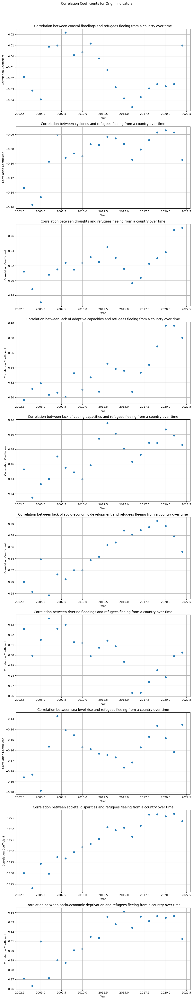

In [38]:
# Plot the coefficients for origin indicators
plot_coefficients_by_indicator_scatter(grouped_origin, 'Correlation Coefficients for Origin Indicators')

Not all relations are not linear and some are also not monotonic.

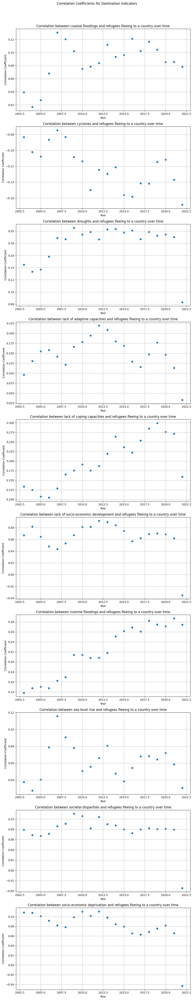

In [39]:
# Plot the coefficients for destination indicators
plot_coefficients_by_indicator_scatter(grouped_destination, 'Correlation Coefficients for Destination Indicators')

In [40]:
correlation_df_destination[correlation_df_destination['Indicator']=='cyclones']['Correlation']

2     -0.083334
12    -0.101990
22    -0.107709
32    -0.086698
42    -0.074751
52    -0.083101
62    -0.108458
72    -0.113662
82    -0.149896
92    -0.124519
102   -0.129318
112   -0.121247
122   -0.155886
132   -0.158221
142   -0.141440
152   -0.141669
162   -0.114592
172   -0.111736
182   -0.137050
192   -0.168230
Name: Correlation, dtype: float64

In [41]:
from statsmodels.stats.stattools import durbin_watson

# Example residuals from a regression model
residuals = correlation_df_destination[correlation_df_origin['Indicator']=='droughts']['Correlation'] - correlation_df_destination[correlation_df_destination['Indicator']=='cyclones']['Correlation'].mean()  # Replace with actual residuals

dw_stat = durbin_watson(residuals)
print('Durbin-Watson statistic:', dw_stat)

Durbin-Watson statistic: 0.007925363218495293


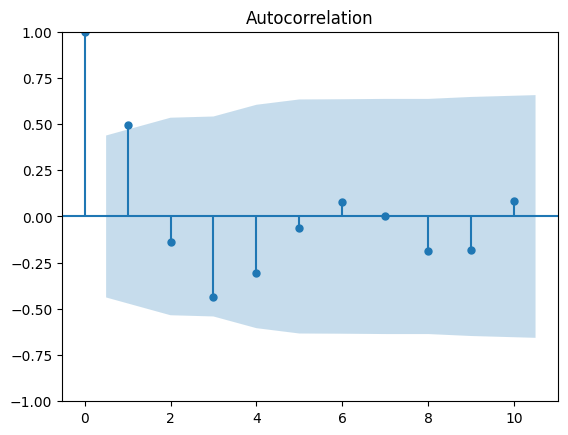

In [42]:
from statsmodels.graphics.tsaplots import plot_acf

# ACF plot
plot_acf(correlation_df_destination[correlation_df_origin['Indicator']=='sea level rise']['Correlation'], lags=10)
plt.show()

In [43]:
import pymannkendall as mk

# Function to calculate Mann-Kendall test and Theil-Sen slope
def calculate_mk_and_theilsen(grouped_data):
    indicator = []
    trend = []
    h_value = []
    mk_statistic = []
    mk_pvalue = []
    tau = []
    ts_slope = []
    mk_s = []
    conclusion = []

    for name, group in grouped_data:
        if name == '#refugees_origin' or name == '#refugees_destination':
            continue  # Skip the main variable itself

        # Perform the original Mann-Kendall test
        result_HamedRao = mk.hamed_rao_modification_test(group['Correlation'])
        
        # Extract Mann-Kendall test results
        #mk_trend = result_original.trend
        mk_h = result_HamedRao.h
        mk_stat = result_HamedRao.z
        mk_pval = result_HamedRao.p
        mk_tau = result_HamedRao.Tau
        slope = result_HamedRao.slope
        s_value = result_HamedRao.s
        
        # Determine trend conclusion based on p-value significance level (5%)
        if mk_pval < 0.05:
            if slope > 0:
                trend_direction = 'Increasing trend'
            elif slope < 0:
                trend_direction = 'Decreasing trend'
            else:
                trend_direction = 'No trend'
            conclusion_text = f"There is a significant {trend_direction}."
        else:
            conclusion_text = "There is no significant trend."

        # Append results to lists
        indicator.append(name)
        #trend.append(mk_trend)
        h_value.append(mk_h)
        mk_statistic.append(mk_stat)
        mk_pvalue.append(mk_pval)
        tau.append(mk_tau)
        ts_slope.append(slope)
        mk_s.append(s_value)
        conclusion.append(conclusion_text)

    # Create dataframe
    results_df = pd.DataFrame({
        'Indicator': indicator,
        #'Trend': trend,
        'H value': h_value,
        'Mann-Kendall Statistic': mk_statistic,
        'Mann-Kendall p-value': mk_pvalue,
        'Kendall Tau': tau,
        'Theil-Sen Slope': ts_slope,
        'S value': mk_s,
        'Conclusion': conclusion
    })

    return results_df

# Assuming grouped_origin and grouped_destination are already defined
# Calculate Mann-Kendall test and Theil-Sen slope for origin dataframe
results_mk_origin_HamedRao = calculate_mk_and_theilsen(grouped_origin)

# Calculate Mann-Kendall test and Theil-Sen slope for destination dataframe
results_mk_destination_HamedRao = calculate_mk_and_theilsen(grouped_destination)

In [44]:
# Display results in separate cells for origin and destination
print("Mann-Kendall Test and Theil-Sen Slope for Origin:")
results_mk_origin_HamedRao

Mann-Kendall Test and Theil-Sen Slope for Origin:


,Indicator,H value,Mann-Kendall Statistic,Mann-Kendall p-value,Kendall Tau,Theil-Sen Slope,S value,Conclusion
0,coastal floodings,False,-0.619898,5.353247e-01,-0.126316,-0.001128,-24.0,There is no significant trend.
1,cyclones,True,2.261477,2.372971e-02,0.484211,0.002976,92.0,There is a significant Increasing trend.
2,droughts,True,2.255700,2.408944e-02,0.494737,0.002762,94.0,There is a significant Increasing trend.
3,lack of adaptive capacities,True,3.860870,1.129841e-04,0.631579,0.003867,120.0,There is a significant Increasing trend.
4,lack of coping capacities,True,4.078826,4.526364e-05,0.536842,0.003763,102.0,There is a significant Increasing trend.
5,lack of socio-economic development,True,3.633054,2.800866e-04,0.705263,0.006585,134.0,There is a significant Increasing trend.
6,riverine floodings,True,-3.082207,2.054719e-03,-0.505263,-0.002415,-96.0,There is a significant Decreasing trend.
7,sea level rise,False,0.772751,4.396695e-01,0.178947,0.001176,34.0,There is no significant trend.
8,societal disparities,True,5.158641,2.487485e-07,0.842105,0.008121,160.0,There is a significant Increasing trend.
9,socio-economic deprivation,True,3.990647,6.589330e-05,0.652632,0.003664,124.0,There is a significant Increasing trend.


In [45]:
# Display results in separate cells for origin and destination
print("Mann-Kendall Test and Theil-Sen Slope for Destination:")
results_mk_destination_HamedRao

Mann-Kendall Test and Theil-Sen Slope for Destination:


,Indicator,H value,Mann-Kendall Statistic,Mann-Kendall p-value,Kendall Tau,Theil-Sen Slope,S value,Conclusion
0,coastal floodings,False,1.070366,2.844546e-01,0.252632,0.002605,48.0,There is no significant trend.
1,cyclones,True,-3.276873,1.049637e-03,-0.536842,-0.003370,-102.0,There is a significant Decreasing trend.
2,droughts,False,0.708987,4.783324e-01,0.189474,0.001058,36.0,There is no significant trend.
3,lack of adaptive capacities,False,-0.206861,8.361181e-01,-0.052632,-0.000602,-10.0,There is no significant trend.
4,lack of coping capacities,True,6.060660,1.355642e-09,0.652632,0.010101,124.0,There is a significant Increasing trend.
5,lack of socio-economic development,False,-0.203180,8.389943e-01,-0.052632,-0.000234,-10.0,There is no significant trend.
6,riverine floodings,True,5.288418,1.233786e-07,0.863158,0.008489,164.0,There is a significant Increasing trend.
7,sea level rise,False,0.000000,1.000000e+00,0.000000,-0.000073,0.0,There is no significant trend.
8,societal disparities,False,-0.408412,6.829710e-01,-0.094737,-0.000351,-18.0,There is no significant trend.
9,socio-economic deprivation,True,-2.374593,1.756830e-02,-0.536842,-0.002455,-102.0,There is a significant Decreasing trend.


In [46]:
import pymannkendall as mk

# Function to calculate Mann-Kendall test and Theil-Sen slope
def calculate_mk_and_theilsen(grouped_data):
    indicator = []
    trend = []
    h_value = []
    mk_statistic = []
    mk_pvalue = []
    tau = []
    ts_slope = []
    mk_s = []
    conclusion = []

    for name, group in grouped_data:
        if name == '#refugees_origin' or name == '#refugees_destination':
            continue  # Skip the main variable itself

        # Perform the original Mann-Kendall test
        result_YueWang = mk.yue_wang_modification_test(group['Correlation'])
        
        # Extract Mann-Kendall test results
        #mk_trend = result_original.trend
        mk_h = result_YueWang.h
        mk_stat = result_YueWang.z
        mk_pval = result_YueWang.p
        mk_tau = result_YueWang.Tau
        slope = result_YueWang.slope
        s_value = result_YueWang.s
        
        # Determine trend conclusion based on p-value significance level (5%)
        if mk_pval < 0.05:
            if slope > 0:
                trend_direction = 'Increasing trend'
            elif slope < 0:
                trend_direction = 'Decreasing trend'
            else:
                trend_direction = 'No trend'
            conclusion_text = f"There is a significant {trend_direction}."
        else:
            conclusion_text = "There is no significant trend."

        # Append results to lists
        indicator.append(name)
        #trend.append(mk_trend)
        h_value.append(mk_h)
        mk_statistic.append(mk_stat)
        mk_pvalue.append(mk_pval)
        tau.append(mk_tau)
        ts_slope.append(slope)
        mk_s.append(s_value)
        conclusion.append(conclusion_text)

    # Create dataframe
    results_df = pd.DataFrame({
        'Indicator': indicator,
        #'Trend': trend,
        'H value': h_value,
        'Mann-Kendall Statistic': mk_statistic,
        'Mann-Kendall p-value': mk_pvalue,
        'Kendall Tau': tau,
        'Theil-Sen Slope': ts_slope,
        'S value': mk_s,
        'Conclusion': conclusion
    })

    return results_df

# Assuming grouped_origin and grouped_destination are already defined
# Calculate Mann-Kendall test and Theil-Sen slope for origin dataframe
results_mk_origin_YueWang = calculate_mk_and_theilsen(grouped_origin)

# Calculate Mann-Kendall test and Theil-Sen slope for destination dataframe
results_mk_destination_YueWang = calculate_mk_and_theilsen(grouped_destination)

In [47]:
# Display results in separate cells for origin and destination
print("Mann-Kendall Test and Theil-Sen Slope for Origin:")
results_mk_origin_YueWang

Mann-Kendall Test and Theil-Sen Slope for Origin:


,Indicator,H value,Mann-Kendall Statistic,Mann-Kendall p-value,Kendall Tau,Theil-Sen Slope,S value,Conclusion
0,coastal floodings,False,-1.223572,2.211139e-01,-0.126316,-0.001128,-24.0,There is no significant trend.
1,cyclones,True,4.521044,6.153541e-06,0.484211,0.002976,92.0,There is a significant Increasing trend.
2,droughts,True,5.465382,4.619102e-08,0.494737,0.002762,94.0,There is a significant Increasing trend.
3,lack of adaptive capacities,True,5.728678,1.012162e-08,0.631579,0.003867,120.0,There is a significant Increasing trend.
4,lack of coping capacities,True,6.702811,2.044476e-11,0.536842,0.003763,102.0,There is a significant Increasing trend.
5,lack of socio-economic development,True,6.934344,4.081180e-12,0.705263,0.006585,134.0,There is a significant Increasing trend.
6,riverine floodings,True,-5.757636,8.530018e-09,-0.505263,-0.002415,-96.0,There is a significant Decreasing trend.
7,sea level rise,True,2.042003,4.115123e-02,0.178947,0.001176,34.0,There is a significant Increasing trend.
8,societal disparities,True,8.664607,0.000000e+00,0.842105,0.008121,160.0,There is a significant Increasing trend.
9,socio-economic deprivation,True,6.068196,1.293549e-09,0.652632,0.003664,124.0,There is a significant Increasing trend.


In [48]:
# Display results in separate cells for origin and destination
print("Mann-Kendall Test and Theil-Sen Slope for Destination:")
results_mk_destination_YueWang

Mann-Kendall Test and Theil-Sen Slope for Destination:


,Indicator,H value,Mann-Kendall Statistic,Mann-Kendall p-value,Kendall Tau,Theil-Sen Slope,S value,Conclusion
0,coastal floodings,True,2.326149,2.001062e-02,0.252632,0.002605,48.0,There is a significant Increasing trend.
1,cyclones,True,-6.314889,2.703555e-10,-0.536842,-0.003370,-102.0,There is a significant Decreasing trend.
2,droughts,False,1.540699,1.233901e-01,0.189474,0.001058,36.0,There is no significant trend.
3,lack of adaptive capacities,False,-0.371694,7.101210e-01,-0.052632,-0.000602,-10.0,There is no significant trend.
4,lack of coping capacities,True,6.330459,2.444331e-10,0.652632,0.010101,124.0,There is a significant Increasing trend.
5,lack of socio-economic development,False,-0.414236,6.787014e-01,-0.052632,-0.000234,-10.0,There is no significant trend.
6,riverine floodings,True,8.324080,0.000000e+00,0.863158,0.008489,164.0,There is a significant Increasing trend.
7,sea level rise,False,0.000000,1.000000e+00,0.000000,-0.000073,0.0,There is no significant trend.
8,societal disparities,False,-0.714612,4.748491e-01,-0.094737,-0.000351,-18.0,There is no significant trend.
9,socio-economic deprivation,True,-4.798608,1.597718e-06,-0.536842,-0.002455,-102.0,There is a significant Decreasing trend.


In [49]:
import pymannkendall as mk

# Function to calculate Mann-Kendall test and Theil-Sen slope
def calculate_mk_and_theilsen(grouped_data):
    indicator = []
    trend = []
    h_value = []
    mk_statistic = []
    mk_pvalue = []
    tau = []
    ts_slope = []
    mk_s = []
    conclusion = []

    for name, group in grouped_data:
        if name == '#refugees_origin' or name == '#refugees_destination':
            continue  # Skip the main variable itself

        # Perform the original Mann-Kendall test
        result_original = mk.original_test(group['Correlation'])
        
        # Extract Mann-Kendall test results
        #mk_trend = result_original.trend
        mk_h = result_original.h
        mk_stat = result_original.z
        mk_pval = result_original.p
        mk_tau = result_original.Tau
        slope = result_original.slope
        s_value = result_original.s
        
        # Determine trend conclusion based on p-value significance level (5%)
        if mk_pval < 0.05:
            if slope > 0:
                trend_direction = 'Increasing trend'
            elif slope < 0:
                trend_direction = 'Decreasing trend'
            else:
                trend_direction = 'No trend'
            conclusion_text = f"There is a significant {trend_direction}."
        else:
            conclusion_text = "There is no significant trend."

        # Append results to lists
        indicator.append(name)
        #trend.append(mk_trend)
        h_value.append(mk_h)
        mk_statistic.append(mk_stat)
        mk_pvalue.append(mk_pval)
        tau.append(mk_tau)
        ts_slope.append(slope)
        mk_s.append(s_value)
        conclusion.append(conclusion_text)

    # Create dataframe
    results_df = pd.DataFrame({
        'Indicator': indicator,
        #'Trend': trend,
        'H value': h_value,
        'Mann-Kendall Statistic': mk_statistic,
        'Mann-Kendall p-value': mk_pvalue,
        'Kendall Tau': tau,
        'Theil-Sen Slope': ts_slope,
        'S value': mk_s,
        'Conclusion': conclusion
    })

    return results_df

# Assuming grouped_origin and grouped_destination are already defined
# Calculate Mann-Kendall test and Theil-Sen slope for origin dataframe
results_mk_origin_original = calculate_mk_and_theilsen(grouped_origin)

# Calculate Mann-Kendall test and Theil-Sen slope for destination dataframe
results_mk_destination_original = calculate_mk_and_theilsen(grouped_destination)

In [50]:
# Display results in separate cells for origin and destination
print("Mann-Kendall Test, Kendall Tau Correaltion and Theil-Sen Slope for Origin Refugee Data:")
results_mk_origin_original

Mann-Kendall Test, Kendall Tau Correaltion and Theil-Sen Slope for Origin Refugee Data:


,Indicator,H value,Mann-Kendall Statistic,Mann-Kendall p-value,Kendall Tau,Theil-Sen Slope,S value,Conclusion
0,coastal floodings,False,-0.746219,4.555354e-01,-0.126316,-0.001128,-24.0,There is no significant trend.
1,cyclones,True,2.952430,3.152837e-03,0.484211,0.002976,92.0,There is a significant Increasing trend.
2,droughts,True,3.017318,2.550218e-03,0.494737,0.002762,94.0,There is a significant Increasing trend.
3,lack of adaptive capacities,True,3.860870,1.129841e-04,0.631579,0.003867,120.0,There is a significant Increasing trend.
4,lack of coping capacities,True,3.276873,1.049637e-03,0.536842,0.003763,102.0,There is a significant Increasing trend.
5,lack of socio-economic development,True,4.315090,1.595380e-05,0.705263,0.006585,134.0,There is a significant Increasing trend.
6,riverine floodings,True,-3.082207,2.054719e-03,-0.505263,-0.002415,-96.0,There is a significant Decreasing trend.
7,sea level rise,False,1.070661,2.843217e-01,0.178947,0.001176,34.0,There is no significant trend.
8,societal disparities,True,5.158641,2.487485e-07,0.842105,0.008121,160.0,There is a significant Increasing trend.
9,socio-economic deprivation,True,3.990647,6.589330e-05,0.652632,0.003664,124.0,There is a significant Increasing trend.


In [51]:
print("\nMann-Kendall Test, Kendall Tau Correaltion and Theil-Sen Slope for Destination Refugee Data:")
results_mk_destination_original


Mann-Kendall Test, Kendall Tau Correaltion and Theil-Sen Slope for Destination Refugee Data:


,Indicator,H value,Mann-Kendall Statistic,Mann-Kendall p-value,Kendall Tau,Theil-Sen Slope,S value,Conclusion
0,coastal floodings,False,1.524881,1.272887e-01,0.252632,0.002605,48.0,There is no significant trend.
1,cyclones,True,-3.276873,1.049637e-03,-0.536842,-0.003370,-102.0,There is a significant Decreasing trend.
2,droughts,False,1.135550,2.561450e-01,0.189474,0.001058,36.0,There is no significant trend.
3,lack of adaptive capacities,False,-0.291999,7.702877e-01,-0.052632,-0.000602,-10.0,There is no significant trend.
4,lack of coping capacities,True,3.990647,6.589330e-05,0.652632,0.010101,124.0,There is a significant Increasing trend.
5,lack of socio-economic development,False,-0.291999,7.702877e-01,-0.052632,-0.000234,-10.0,There is no significant trend.
6,riverine floodings,True,5.288418,1.233786e-07,0.863158,0.008489,164.0,There is a significant Increasing trend.
7,sea level rise,False,0.000000,1.000000e+00,0.000000,-0.000073,0.0,There is no significant trend.
8,societal disparities,False,-0.551553,5.812548e-01,-0.094737,-0.000351,-18.0,There is no significant trend.
9,socio-economic deprivation,True,-3.276873,1.049637e-03,-0.536842,-0.002455,-102.0,There is a significant Decreasing trend.


We find similar things when calculating Theil Sen slopes with other packages.

In [52]:
from scipy.stats import theilslopes

# Function to calculate Theil-Sen slope using scipy
def calculate_theilsen_scipy(grouped_data):
    indicator = []
    ts_slope_scipy = []

    for name, group in grouped_data:
        if name == '#refugees_origin' or name == '#refugees_destination':
            continue  # Skip the main variable itself

        # Calculate Theil-Sen slope using scipy.stats.theilslopes
        slope_scipy, intercept, _, _ = theilslopes(group['Correlation'], group['Year'])
        
        # Append results to lists
        indicator.append(name)
        ts_slope_scipy.append(slope_scipy)

    # Create dataframe
    results_df = pd.DataFrame({
        'Indicator': indicator,
        'Theil-Sen Slope (scipy)': ts_slope_scipy
    })

    return results_df

# Assuming grouped_origin and grouped_destination are already defined
# Calculate Theil-Sen slope using scipy.stats.theilslopes
results_theilsen_scipy = calculate_theilsen_scipy(grouped_origin)
results_theilsen_scipy

,Indicator,Theil-Sen Slope (scipy)
0,coastal floodings,-0.001128
1,cyclones,0.002976
2,droughts,0.002762
3,lack of adaptive capacities,0.003867
4,lack of coping capacities,0.003763
5,lack of socio-economic development,0.006585
6,riverine floodings,-0.002415
7,sea level rise,0.001176
8,societal disparities,0.008121
9,socio-economic deprivation,0.003664


Below follow the same conclusions as in the Kendall Tau column in the Table from line 53. These findings are verified.

So this, below, is about the correlation of the year variable with the correlation between the indicator value and the refugee data.

In [53]:
import warnings

# Suppress DeprecationWarning temporarily
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=DeprecationWarning)

    # Calculate correlation between Year and Correlation coefficients for origin
    correlation_year_origin = correlation_df_origin.groupby('Indicator').apply(lambda x: x['Year'].corr(x['Correlation'], method='kendall')).reset_index(name='Correlation with Year')

    # Display correlation between Year and Correlation coefficients for origin
    print("Correlation between Year and Correlation Coefficients for Origin:")
correlation_year_origin

Correlation between Year and Correlation Coefficients for Origin:


,Indicator,Correlation with Year
0,coastal floodings,-0.126316
1,cyclones,0.484211
2,droughts,0.494737
3,lack of adaptive capacities,0.631579
4,lack of coping capacities,0.536842
5,lack of socio-economic development,0.705263
6,riverine floodings,-0.505263
7,sea level rise,0.178947
8,societal disparities,0.842105
9,socio-economic deprivation,0.652632


In [54]:
# Suppress DeprecationWarning temporarily
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=DeprecationWarning)
    
    # Calculate correlation between Year and Correlation coefficients for destination
    correlation_year_destination = correlation_df_destination.groupby('Indicator').apply(lambda x: x['Year'].corr(x['Correlation'], method='kendall')).reset_index(name='Correlation with Year')

    # Display correlation between Year and Correlation coefficients for destination
    print("Correlation between Year and Correlation Coefficients for Destination:")
correlation_year_destination

Correlation between Year and Correlation Coefficients for Destination:


,Indicator,Correlation with Year
0,coastal floodings,0.252632
1,cyclones,-0.536842
2,droughts,0.189474
3,lack of adaptive capacities,-0.052632
4,lack of coping capacities,0.652632
5,lack of socio-economic development,-0.052632
6,riverine floodings,0.863158
7,sea level rise,0.000000
8,societal disparities,-0.094737
9,socio-economic deprivation,-0.536842


Those numbers look very 'big' and/or significant, but in reality, the correlation coefficient does not change much in those years. But if you correlate the minor difference coefficients with the years, it seems like huge decreases/increases.

Simple linear regression is the parametric counterpart of the Mann-Kendall test and the Theil-Sen Slope.

In [55]:
from sklearn.linear_model import LinearRegression
from scipy.stats import linregress

# Function to calculate linear regression slope and significance
def calculate_linear_regression(grouped_data):
    indicator = []
    slope = []
    p_value = []

    for name, group in grouped_data:
        if name == '#refugees_origin' or name == '#refugees_destination':
            continue  # Skip the main variable itself

        # Fit linear regression model
        model = LinearRegression()
        X = group['Year'].values.reshape(-1, 1)
        y = group['Correlation'].values.reshape(-1, 1)
        model.fit(X, y)

        # Get slope (coefficient) and p-value
        slope_val = model.coef_[0][0]
        _, _, r_value, p_value_val, _ = linregress(group['Year'], group['Correlation'])

        # Append results to lists
        indicator.append(name)
        slope.append(slope_val)
        p_value.append(p_value_val)

    # Determine significance
    significance = [True if p < 0.05 else False for p in p_value]

    # Create dataframe
    results_df = pd.DataFrame({
        'Indicator': indicator,
        'Linear Regression Slope': slope,
        'P-value': p_value,
        'Significant': significance
    })

    return results_df

# Calculate linear regression slope for origin dataframe
results_lr_origin = calculate_linear_regression(grouped_origin)

# Display linear regression slope for origin dataframe
print("\nLinear Regression Slope for Origin:")
results_lr_origin


Linear Regression Slope for Origin:


,Indicator,Linear Regression Slope,P-value,Significant
0,coastal floodings,-0.000942,2.554754e-01,False
1,cyclones,0.003308,1.285444e-03,True
2,droughts,0.002651,1.563778e-03,True
3,lack of adaptive capacities,0.004352,6.829530e-06,True
4,lack of coping capacities,0.003475,1.468359e-04,True
5,lack of socio-economic development,0.005768,1.523599e-06,True
6,riverine floodings,-0.002437,9.132529e-04,True
7,sea level rise,0.001250,7.506794e-02,False
8,societal disparities,0.008102,2.387186e-10,True
9,socio-economic deprivation,0.003429,7.723367e-06,True


In [56]:
# Calculate linear regression slope for destination dataframe
results_lr_destination = calculate_linear_regression(grouped_destination)

# Display linear regression slope for destination dataframe
print("\nLinear Regression Slope for Destination:")
results_lr_destination


Linear Regression Slope for Destination:


,Indicator,Linear Regression Slope,P-value,Significant
0,coastal floodings,0.002440,3.668144e-02,True
1,cyclones,-0.003287,3.538497e-04,True
2,droughts,0.000924,4.680834e-01,False
3,lack of adaptive capacities,-0.001303,4.429535e-01,False
4,lack of coping capacities,0.008556,1.421300e-05,True
5,lack of socio-economic development,-0.001255,2.372815e-01,False
6,riverine floodings,0.008507,9.811557e-12,True
7,sea level rise,-0.000210,8.109949e-01,False
8,societal disparities,-0.001645,1.477439e-01,False
9,socio-economic deprivation,-0.003632,2.150208e-03,True


In [57]:
refugeeorigin_worldrisk

,Year,#refugees_origin,coastal floodings,riverine floodings,cyclones,droughts,sea level rise,lack of socio-economic development,socio-economic deprivation,societal disparities,lack of coping capacities,lack of adaptive capacities
0,2003,2136039,0.01,46.39,0.01,2.49,0.01,67.49,68.10,71.21,74.70,77.17
1,2004,2414460,0.01,46.33,0.01,2.49,0.01,69.39,68.46,73.31,73.40,75.53
2,2005,2166139,0.01,46.33,0.01,2.48,0.01,68.65,67.74,70.31,69.49,72.54
3,2006,2107510,0.01,46.40,0.01,2.48,0.01,70.31,65.89,70.49,75.41,69.13
4,2007,3057655,0.01,46.53,0.01,2.48,0.01,69.70,65.09,73.22,76.98,70.73
...,...,...,...,...,...,...,...,...,...,...,...,...
3562,2018,15618,0.01,23.06,0.15,2.28,0.01,60.08,57.62,68.53,15.24,65.41
3563,2019,10045,0.01,22.71,0.15,2.28,0.01,60.34,58.62,70.02,15.45,69.09
3564,2020,8575,0.01,22.85,0.15,2.27,0.01,61.09,57.64,72.34,15.39,68.36
3565,2021,8115,0.01,22.85,0.15,2.27,0.01,62.08,57.67,72.20,15.34,67.64


In [58]:
refugeedestination_worldrisk['droughts'].max()

70.58

In [59]:
refugeedestination_worldrisk['droughts'].min()

0.01

In [60]:
refugeeorigin_worldrisk['cyclones'].max()

89.72

In [61]:
refugeedestination_worldrisk['cyclones'].min()

0.01

In [62]:
refugeeorigin_worldrisk['sea level rise'].max()

79.26

In [63]:
refugeedestination_worldrisk['sea level rise'].min()

0.01

In [64]:
refugeedestination_worldrisk['coastal floodings'].max()

92.59

In [65]:
refugeedestination_worldrisk['coastal floodings'].min()

0.01

In [66]:
refugeedestination_worldrisk['riverine floodings'].min()

0.01

In [67]:
refugeedestination_worldrisk['riverine floodings'].max()

89.81

In [68]:
refugeedestination_worldrisk['lack of socio-economic development'].max()

77.15

In [69]:
refugeedestination_worldrisk['lack of socio-economic development'].min()

3.08

In [70]:
refugeedestination_worldrisk['socio-economic deprivation'].min()

0.06

In [71]:
refugeeorigin_worldrisk['socio-economic deprivation'].max()

88.85

In [72]:
refugeedestination_worldrisk['lack of coping capacities'].min()

0.12

In [73]:
refugeeorigin_worldrisk['lack of coping capacities'].max()

86.37

In [74]:
refugeedestination_worldrisk['lack of adaptive capacities'].max()

83.69

In [75]:
refugeedestination_worldrisk['lack of adaptive capacities'].min()

2.48

In [76]:
refugeeorigin_worldrisk['societal disparities'].max()

88.93

In [77]:
refugeedestination_worldrisk['societal disparities'].min()

1.58

In [78]:
refugeeorigin_worldrisk['#refugees_origin'].min()

5

In [79]:
refugeeorigin_worldrisk['#refugees_origin'].max()

6848865

In [80]:
refugeeorigin_worldrisk

,Year,#refugees_origin,coastal floodings,riverine floodings,cyclones,droughts,sea level rise,lack of socio-economic development,socio-economic deprivation,societal disparities,lack of coping capacities,lack of adaptive capacities
0,2003,2136039,0.01,46.39,0.01,2.49,0.01,67.49,68.10,71.21,74.70,77.17
1,2004,2414460,0.01,46.33,0.01,2.49,0.01,69.39,68.46,73.31,73.40,75.53
2,2005,2166139,0.01,46.33,0.01,2.48,0.01,68.65,67.74,70.31,69.49,72.54
3,2006,2107510,0.01,46.40,0.01,2.48,0.01,70.31,65.89,70.49,75.41,69.13
4,2007,3057655,0.01,46.53,0.01,2.48,0.01,69.70,65.09,73.22,76.98,70.73
...,...,...,...,...,...,...,...,...,...,...,...,...
3562,2018,15618,0.01,23.06,0.15,2.28,0.01,60.08,57.62,68.53,15.24,65.41
3563,2019,10045,0.01,22.71,0.15,2.28,0.01,60.34,58.62,70.02,15.45,69.09
3564,2020,8575,0.01,22.85,0.15,2.27,0.01,61.09,57.64,72.34,15.39,68.36
3565,2021,8115,0.01,22.85,0.15,2.27,0.01,62.08,57.67,72.20,15.34,67.64


In [81]:
refugeeorigin_worldrisk.columns

Index(['Year', '#refugees_origin', 'coastal floodings', 'riverine floodings',
       'cyclones', 'droughts', 'sea level rise',
       'lack of socio-economic development', 'socio-economic deprivation',
       'societal disparities', 'lack of coping capacities',
       'lack of adaptive capacities'],
      dtype='object')

In [82]:
refugeedestination_worldrisk

,Year,#refugees_destination,coastal floodings,riverine floodings,cyclones,droughts,sea level rise,lack of socio-economic development,socio-economic deprivation,societal disparities,lack of coping capacities,lack of adaptive capacities
0,2003,24,0.01,46.39,0.01,2.49,0.01,67.49,68.10,71.21,74.70,77.17
1,2004,31,0.01,46.33,0.01,2.49,0.01,69.39,68.46,73.31,73.40,75.53
2,2005,31,0.01,46.33,0.01,2.48,0.01,68.65,67.74,70.31,69.49,72.54
3,2006,34,0.01,46.40,0.01,2.48,0.01,70.31,65.89,70.49,75.41,69.13
4,2007,43,0.01,46.53,0.01,2.48,0.01,69.70,65.09,73.22,76.98,70.73
...,...,...,...,...,...,...,...,...,...,...,...,...
3092,2018,7795,0.01,23.06,0.15,2.28,0.01,60.08,57.62,68.53,15.24,65.41
3093,2019,8956,0.01,22.71,0.15,2.28,0.01,60.34,58.62,70.02,15.45,69.09
3094,2020,9261,0.01,22.85,0.15,2.27,0.01,61.09,57.64,72.34,15.39,68.36
3095,2021,9483,0.01,22.85,0.15,2.27,0.01,62.08,57.67,72.20,15.34,67.64


In [83]:
refugeeorigin_worldrisk

,Year,#refugees_origin,coastal floodings,riverine floodings,cyclones,droughts,sea level rise,lack of socio-economic development,socio-economic deprivation,societal disparities,lack of coping capacities,lack of adaptive capacities
0,2003,2136039,0.01,46.39,0.01,2.49,0.01,67.49,68.10,71.21,74.70,77.17
1,2004,2414460,0.01,46.33,0.01,2.49,0.01,69.39,68.46,73.31,73.40,75.53
2,2005,2166139,0.01,46.33,0.01,2.48,0.01,68.65,67.74,70.31,69.49,72.54
3,2006,2107510,0.01,46.40,0.01,2.48,0.01,70.31,65.89,70.49,75.41,69.13
4,2007,3057655,0.01,46.53,0.01,2.48,0.01,69.70,65.09,73.22,76.98,70.73
...,...,...,...,...,...,...,...,...,...,...,...,...
3562,2018,15618,0.01,23.06,0.15,2.28,0.01,60.08,57.62,68.53,15.24,65.41
3563,2019,10045,0.01,22.71,0.15,2.28,0.01,60.34,58.62,70.02,15.45,69.09
3564,2020,8575,0.01,22.85,0.15,2.27,0.01,61.09,57.64,72.34,15.39,68.36
3565,2021,8115,0.01,22.85,0.15,2.27,0.01,62.08,57.67,72.20,15.34,67.64


In [84]:
refugeedestination_worldrisk['#refugees_destination'].min()

5

In [85]:
refugeedestination_worldrisk['#refugees_destination'].max()

3759817

In [86]:
refugeedestination_worldrisk

,Year,#refugees_destination,coastal floodings,riverine floodings,cyclones,droughts,sea level rise,lack of socio-economic development,socio-economic deprivation,societal disparities,lack of coping capacities,lack of adaptive capacities
0,2003,24,0.01,46.39,0.01,2.49,0.01,67.49,68.10,71.21,74.70,77.17
1,2004,31,0.01,46.33,0.01,2.49,0.01,69.39,68.46,73.31,73.40,75.53
2,2005,31,0.01,46.33,0.01,2.48,0.01,68.65,67.74,70.31,69.49,72.54
3,2006,34,0.01,46.40,0.01,2.48,0.01,70.31,65.89,70.49,75.41,69.13
4,2007,43,0.01,46.53,0.01,2.48,0.01,69.70,65.09,73.22,76.98,70.73
...,...,...,...,...,...,...,...,...,...,...,...,...
3092,2018,7795,0.01,23.06,0.15,2.28,0.01,60.08,57.62,68.53,15.24,65.41
3093,2019,8956,0.01,22.71,0.15,2.28,0.01,60.34,58.62,70.02,15.45,69.09
3094,2020,9261,0.01,22.85,0.15,2.27,0.01,61.09,57.64,72.34,15.39,68.36
3095,2021,9483,0.01,22.85,0.15,2.27,0.01,62.08,57.67,72.20,15.34,67.64


Here below multivariate regression.

First, test the assumptions of multivariate linear regression!

Multicollinearity is prevented when we exclude socio-economic deprivation, societal disparities and lack of adaptive capacities. , 'lack of coping capacities'. See # in code below. There you see the variables excluded! If we do not exclude them, we get multicollinearity.

In [87]:
import statsmodels.api as sm
from scipy.stats import shapiro
from statsmodels.stats.diagnostic import het_breuschpagan, linear_rainbow
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.stats.stattools import durbin_watson

def test_assumptions(df, dependent_var, independent_vars):
    results = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = data_year[dependent_var]

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        try:
            model = sm.OLS(y, X).fit()
        except Exception as e:
            results.append({
                'Year': year,
                'Error': f'Error fitting OLS model: {str(e)}'
            })
            continue

        # 1. Linearity check using Rainbow test
        rainbow_statistic, p_rainbow = linear_rainbow(model)
        if p_rainbow < 0.05:
            linearity_conclusion = 'Violates linearity assumption (Rainbow test)'
        else:
            linearity_conclusion = 'Satisfies linearity assumption (Rainbow test)'

        # Linearity check using Actual vs Predicted plot
        y_pred = model.predict(X)

        plt.figure(figsize=(8, 4))
        plt.scatter(y, y_pred)
        plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2)
        plt.xlabel('Actual values')
        plt.ylabel('Predicted values')
        plt.title(f'Actual vs Predicted Values, dependent variable: {dependent_var}, {year}')
        plt.grid(True)
        plt.show()

        # 2. Normality of residuals using Shapiro-Wilk test
        residuals = model.resid
        _, p_shapiro = shapiro(residuals)
        if p_shapiro < 0.05:
            normality_conclusion = 'Residuals are not normally distributed (Shapiro-Wilk)'
        else:
            normality_conclusion = 'Residuals are normally distributed (Shapiro-Wilk)'

        # 3. Homoscedasticity using Breusch-Pagan test
        _, p_breuschpagan, _, _ = het_breuschpagan(residuals, model.model.exog)
        if p_breuschpagan < 0.05:
            homoscedasticity_conclusion = 'Violates homoscedasticity assumption'
        else:
            homoscedasticity_conclusion = 'Satisfies homoscedasticity assumption'

        # 4. Autocorrelation using Durbin-Watson test
        dw_statistic = durbin_watson(residuals)
        if dw_statistic < 1.5:
            autocorrelation_conclusion = 'Positive autocorrelation detected (Durbin-Watson test)'
        elif dw_statistic > 2.5:
            autocorrelation_conclusion = 'Negative autocorrelation detected (Durbin-Watson test)'
        else:
            autocorrelation_conclusion = 'No significant autocorrelation detected (Durbin-Watson test)'

        # 5. Multicollinearity using VIF
        vif_data = data_year[independent_vars]
        vif = pd.DataFrame()
        vif["Variable"] = vif_data.columns
        vif["VIF"] = [variance_inflation_factor(vif_data.values, i) for i in range(vif_data.shape[1])]
        multicollinearity_conclusions = []
        for i, row in vif.iterrows():
            if row['VIF'] > 10:
                multicollinearity_conclusions.append(f"{row['Variable']} has high VIF (> 10), indicating multicollinearity")
            else:
                multicollinearity_conclusions.append(f"{row['Variable']} has VIF <= 10")

        # Append results for the current year
        results.append({
            'Year': year,
            'Linearity': linearity_conclusion,
            'Normality of Residuals': normality_conclusion,
            'Homoscedasticity': homoscedasticity_conclusion,
            'Autocorrelation': autocorrelation_conclusion,
            'Multicollinearity': multicollinearity_conclusions
        })

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    return results_df

# Define independent variables (excluding the dependent variable)
independent_vars = [
    'coastal floodings', 'riverine floodings', 'cyclones', 'droughts', 'sea level rise',
    'lack of socio-economic development',
    'lack of coping capacities',
    #'socio-economic deprivation',
    #'societal disparities',
    #'lack of adaptive capacities'
]

pd.set_option('display.max_colwidth', None)


Testing assumptions for origin:


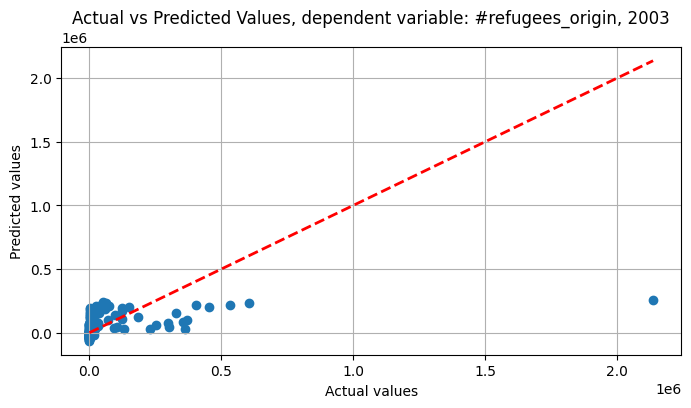

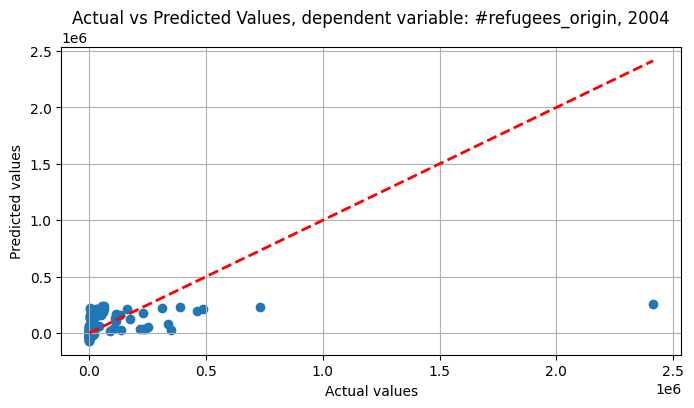

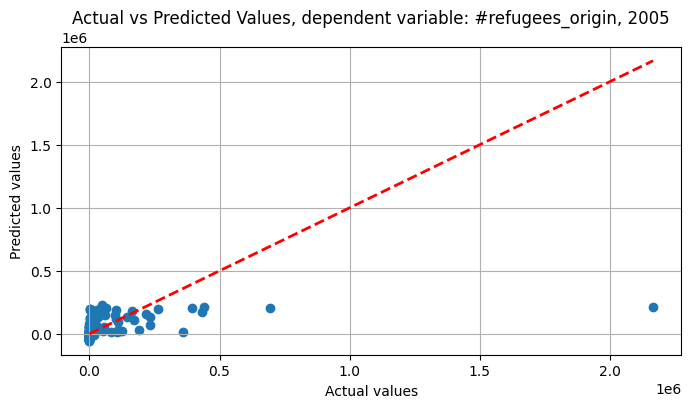

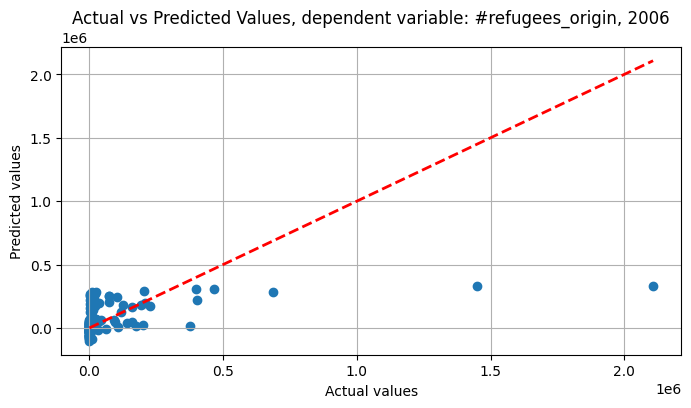

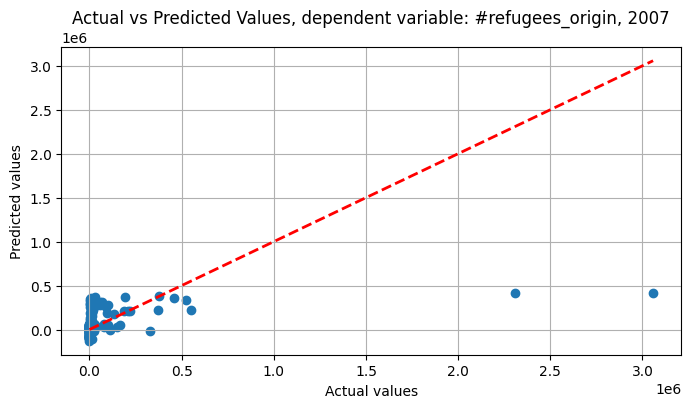

...

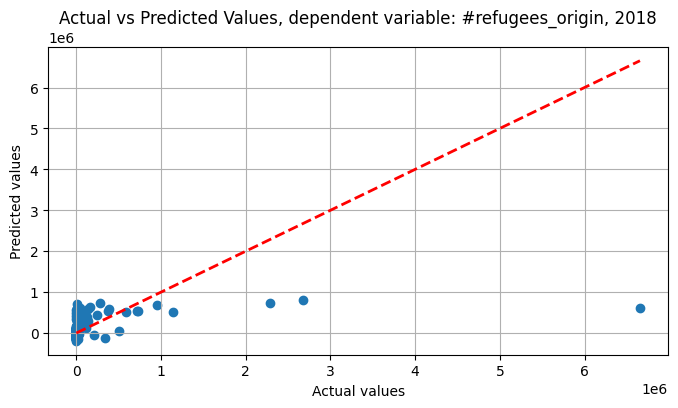

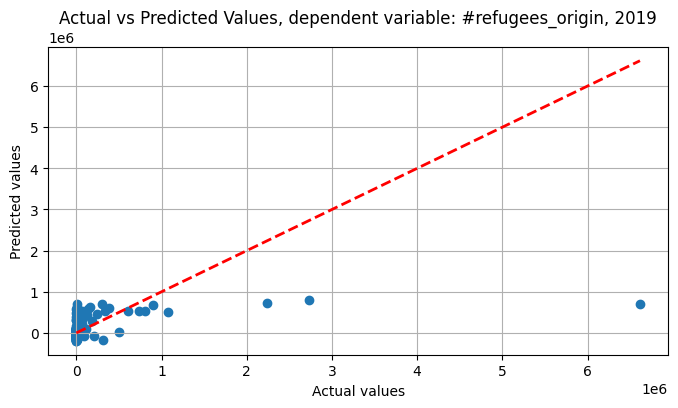

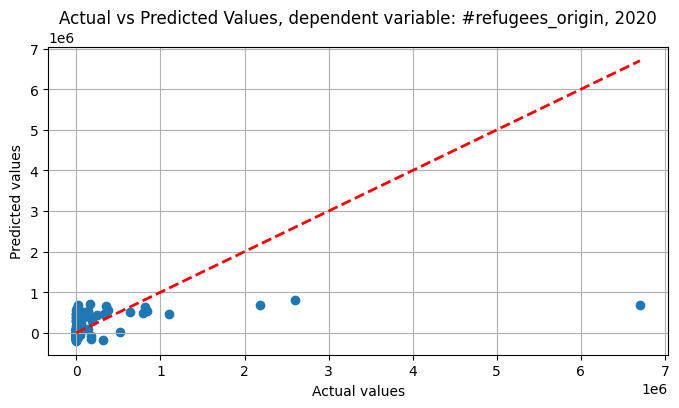

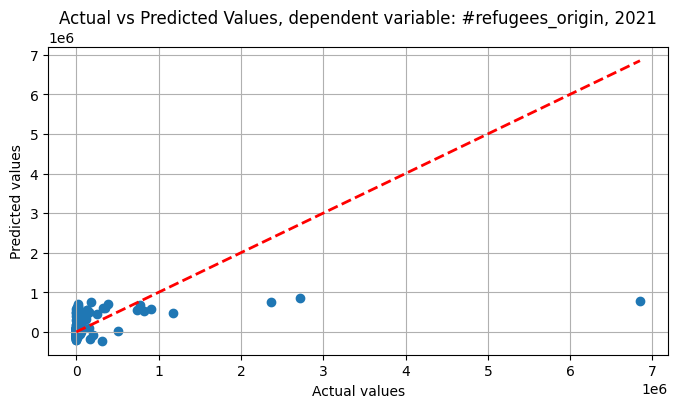

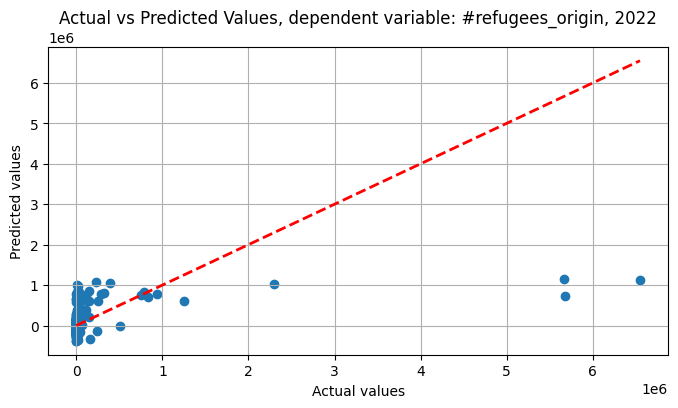

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
1,2004,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
2,2005,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
3,2006,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Violates homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
4,2007,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Violates homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
5,2008,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Violates homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
6,2009,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Violates homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
7,2010,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Violates homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
8,2011,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Violates homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack

In [88]:
print("\nTesting assumptions for origin:")
origin_results = test_assumptions(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
origin_results


Testing assumptions for destination:


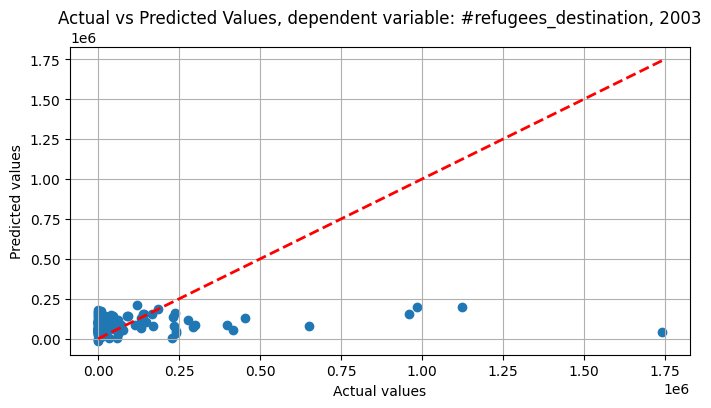

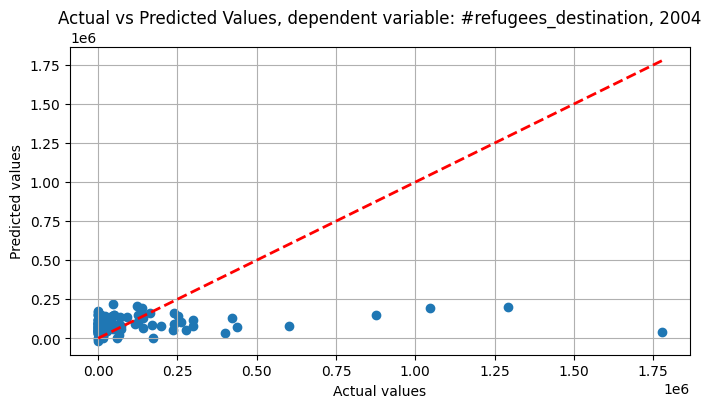

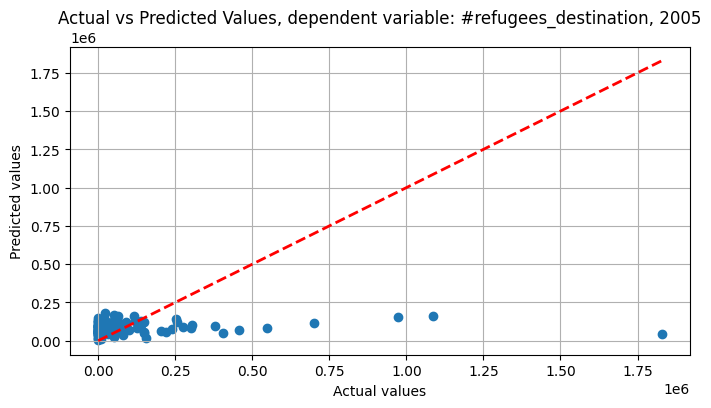

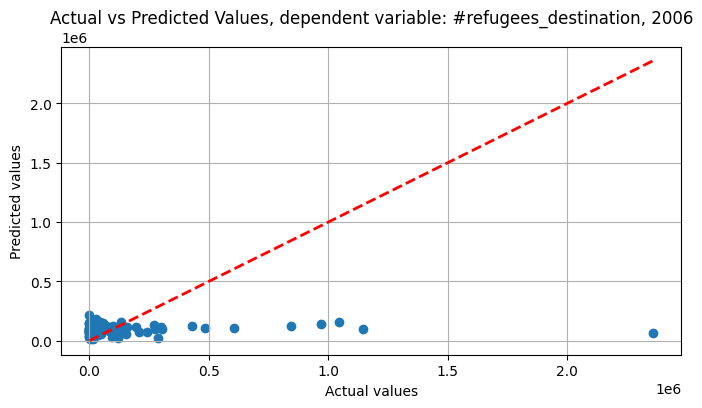

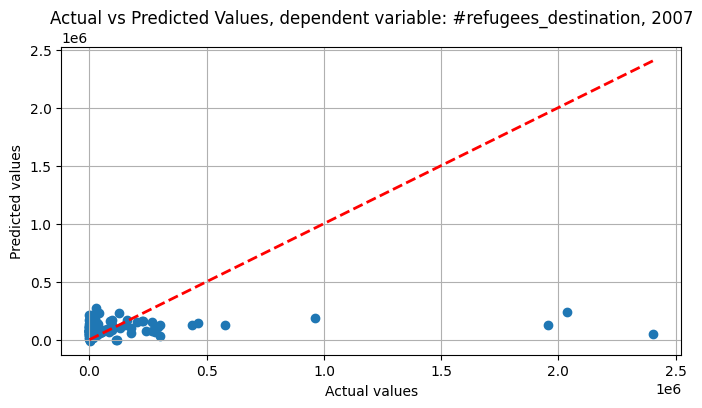

...

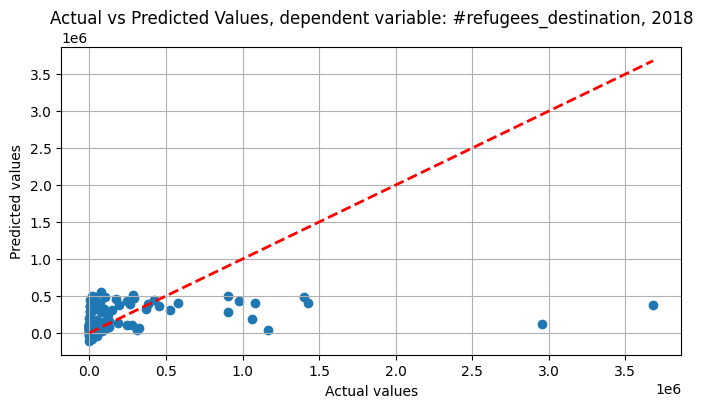

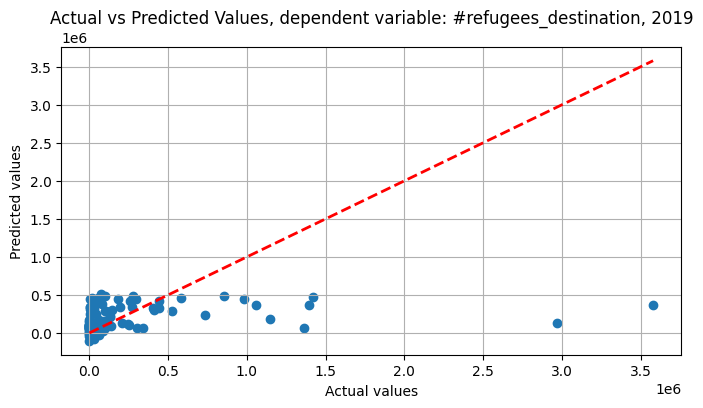

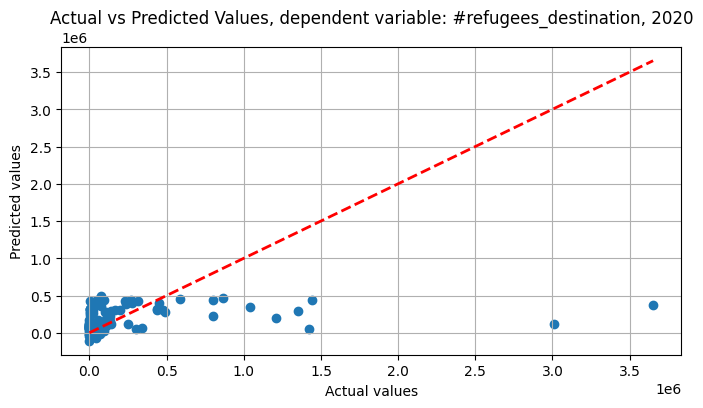

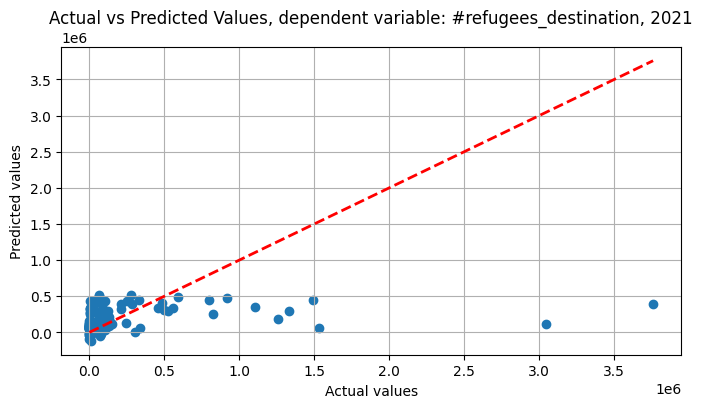

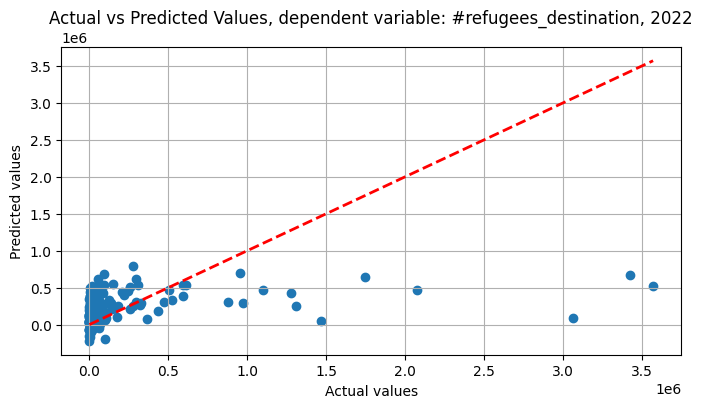

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10]"
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, sea level rise has VIF <= 1

In [89]:
print("\nTesting assumptions for destination:")
destination_results = test_assumptions(refugeedestination_worldrisk, '#refugees_destination', independent_vars)
destination_results

In [90]:
import statsmodels.api as sm
from scipy.stats import shapiro
from statsmodels.stats.diagnostic import het_breuschpagan, linear_rainbow
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.stats.stattools import durbin_watson

def test_assumptions(df, dependent_var, independent_vars):
    results = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = np.log(data_year[independent_vars])
        y = data_year[dependent_var]

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        try:
            model = sm.OLS(y, X).fit()
        except Exception as e:
            results.append({
                'Year': year,
                'Error': f'Error fitting OLS model: {str(e)}'
            })
            continue

        # 1. Linearity check using Rainbow test
        rainbow_statistic, p_rainbow = linear_rainbow(model)
        if p_rainbow < 0.05:
            linearity_conclusion = 'Violates linearity assumption (Rainbow test)'
        else:
            linearity_conclusion = 'Satisfies linearity assumption (Rainbow test)'

        # Linearity check using Actual vs Predicted plot
        y_pred = model.predict(X)

        plt.figure(figsize=(8, 4))
        plt.scatter(y, y_pred)
        plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2)
        plt.xlabel('Actual values')
        plt.ylabel('Predicted values')
        plt.title(f'Actual vs Predicted Values, dependent variable: {dependent_var}, {year}')
        plt.grid(True)
        plt.show()

        # 2. Normality of residuals using Shapiro-Wilk test
        residuals = model.resid
        _, p_shapiro = shapiro(residuals)
        if p_shapiro < 0.05:
            normality_conclusion = 'Residuals are not normally distributed (Shapiro-Wilk)'
        else:
            normality_conclusion = 'Residuals are normally distributed (Shapiro-Wilk)'

        # 3. Homoscedasticity using Breusch-Pagan test
        _, p_breuschpagan, _, _ = het_breuschpagan(residuals, model.model.exog)
        if p_breuschpagan < 0.05:
            homoscedasticity_conclusion = 'Violates homoscedasticity assumption'
        else:
            homoscedasticity_conclusion = 'Satisfies homoscedasticity assumption'

        # 4. Autocorrelation using Durbin-Watson test
        dw_statistic = durbin_watson(residuals)
        if dw_statistic < 1.5:
            autocorrelation_conclusion = 'Positive autocorrelation detected (Durbin-Watson test)'
        elif dw_statistic > 2.5:
            autocorrelation_conclusion = 'Negative autocorrelation detected (Durbin-Watson test)'
        else:
            autocorrelation_conclusion = 'No significant autocorrelation detected (Durbin-Watson test)'

        # 5. Multicollinearity using VIF
        vif_data = data_year[independent_vars]
        vif = pd.DataFrame()
        vif["Variable"] = vif_data.columns
        vif["VIF"] = [variance_inflation_factor(vif_data.values, i) for i in range(vif_data.shape[1])]
        multicollinearity_conclusions = []
        for i, row in vif.iterrows():
            if row['VIF'] > 10:
                multicollinearity_conclusions.append(f"{row['Variable']} has high VIF (> 10), indicating multicollinearity")
            else:
                multicollinearity_conclusions.append(f"{row['Variable']} has VIF <= 10")

        # Append results for the current year
        results.append({
            'Year': year,
            'Linearity': linearity_conclusion,
            'Normality of Residuals': normality_conclusion,
            'Homoscedasticity': homoscedasticity_conclusion,
            'Autocorrelation': autocorrelation_conclusion,
            'Multicollinearity': multicollinearity_conclusions
        })

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    return results_df

# Define independent variables (excluding the dependent variable)
independent_vars = [
    'coastal floodings', 'riverine floodings', 'cyclones', 'droughts', 
    'lack of socio-economic development', 'lack of coping capacities', 'sea level rise'
]

pd.set_option('display.max_colwidth', None)


Testing assumptions for origin:


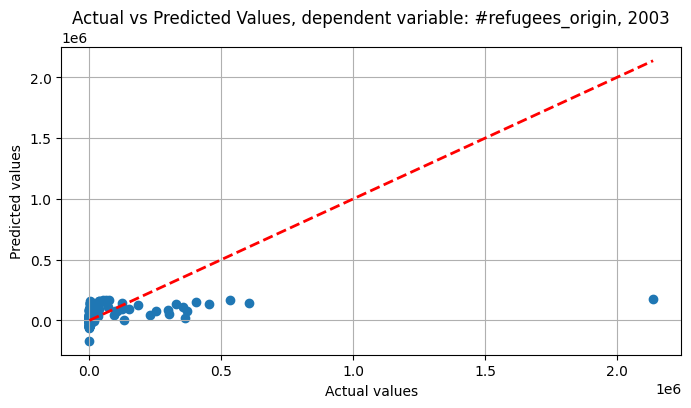

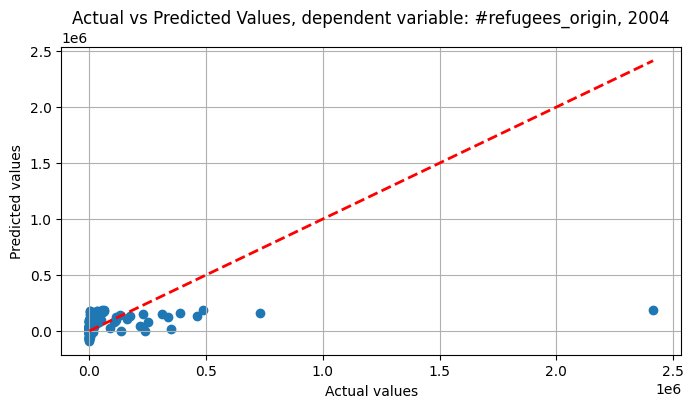

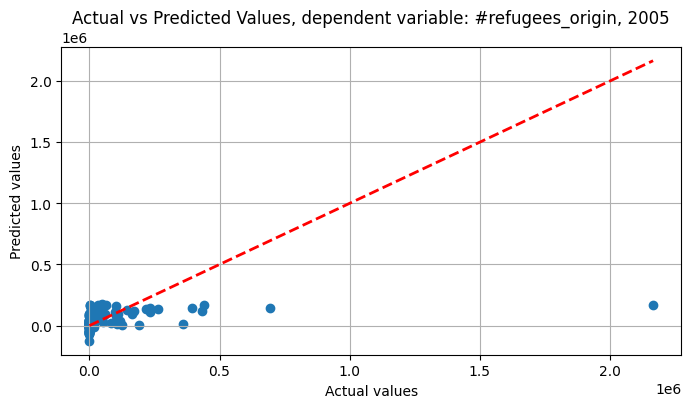

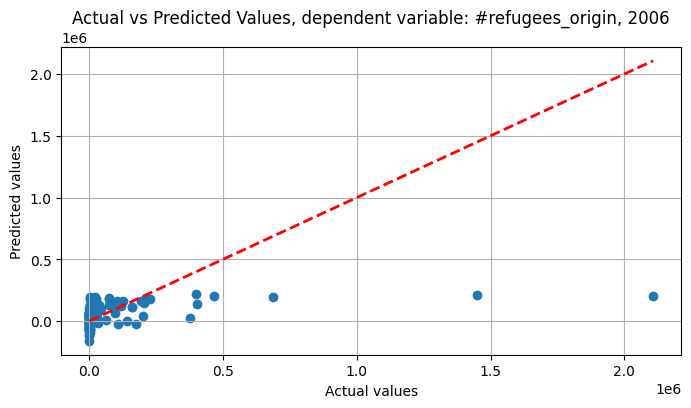

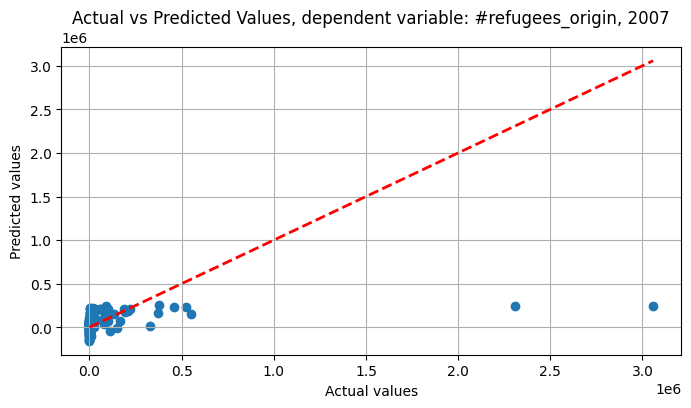

...

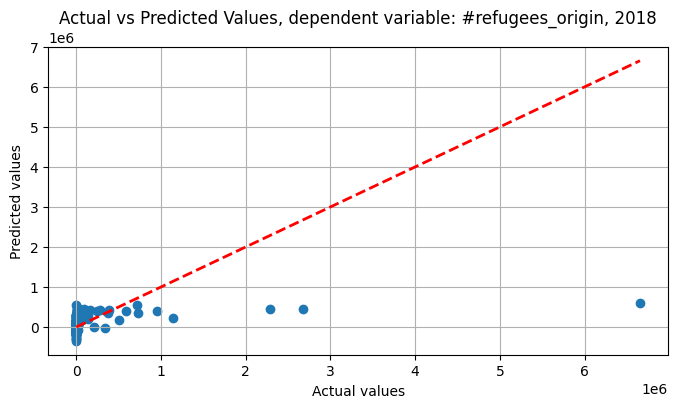

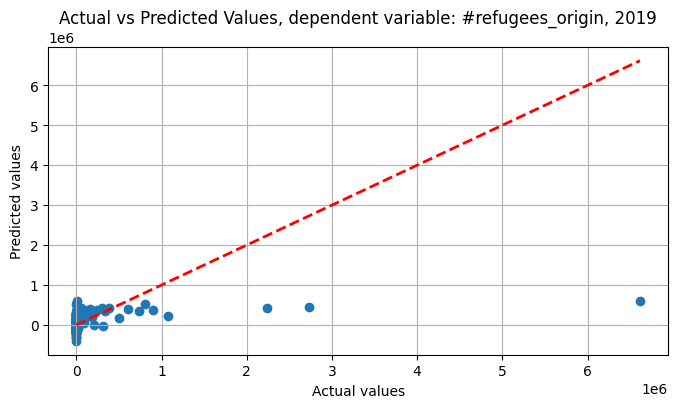

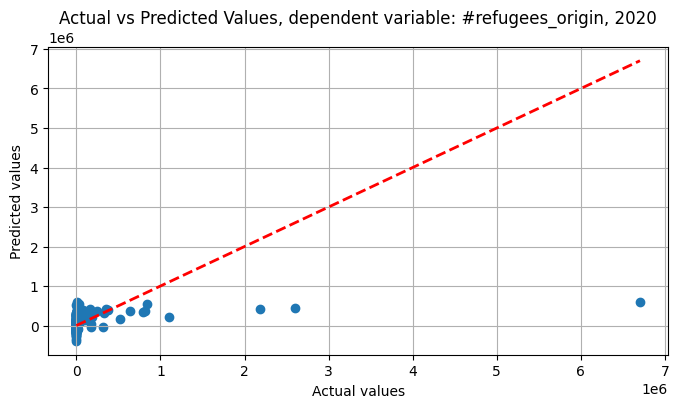

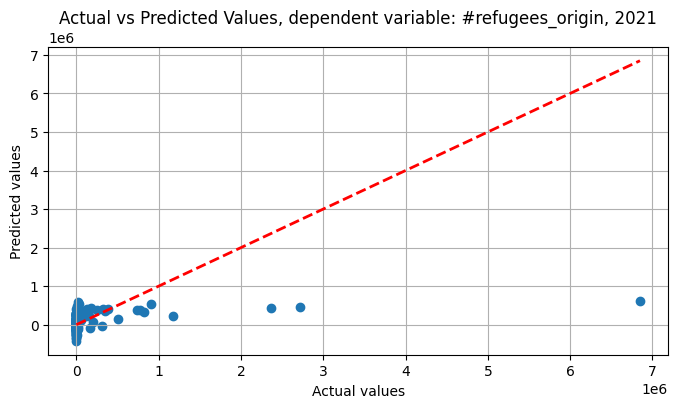

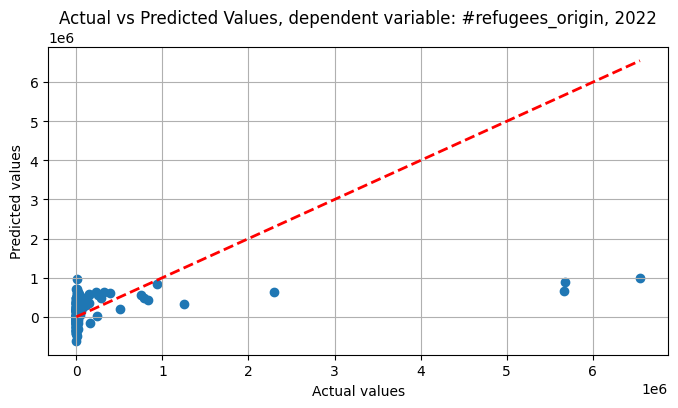

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
1,2004,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
2,2005,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
3,2006,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
4,2007,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
5,2008,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
6,2009,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
7,2010,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
8,2011,Violates linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,Positive autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF 

In [91]:
print("\nTesting assumptions for origin:")
origin_results = test_assumptions(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
origin_results


Testing assumptions for destination:


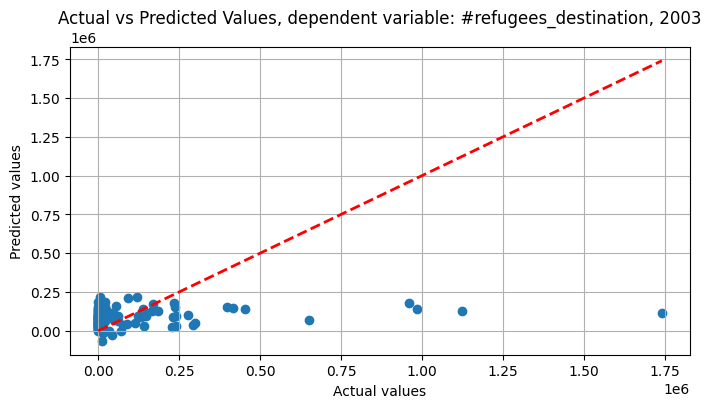

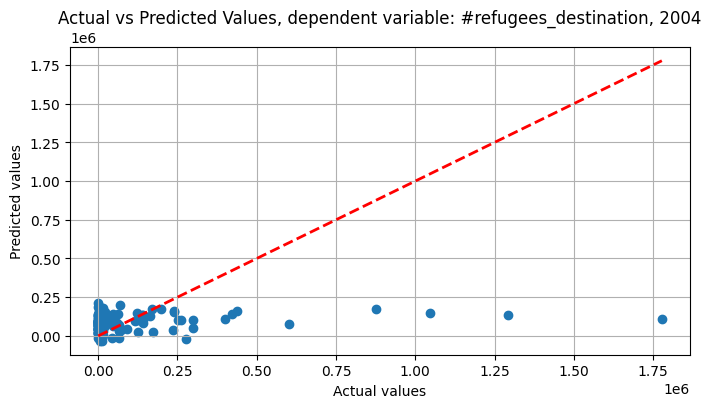

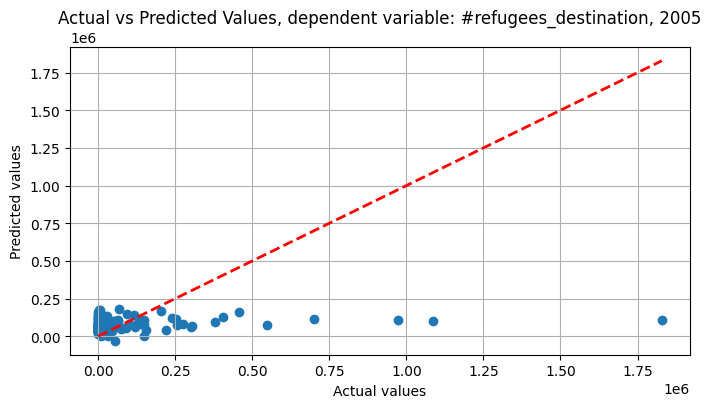

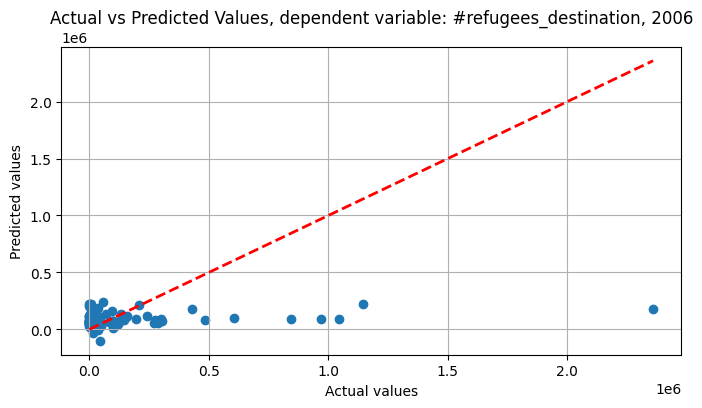

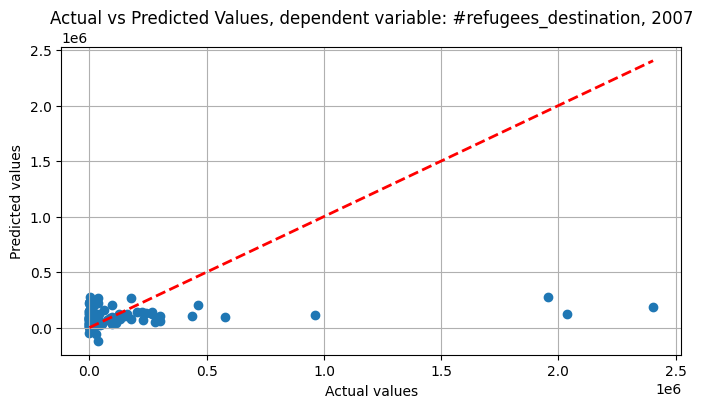

...

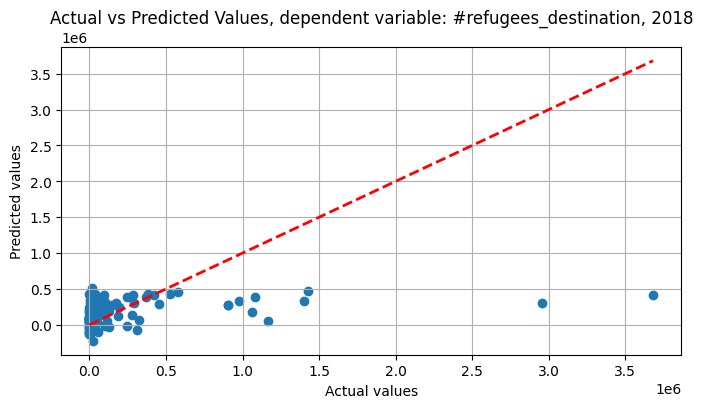

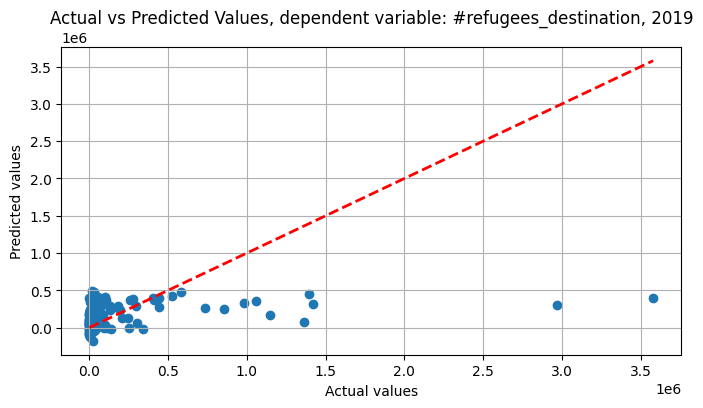

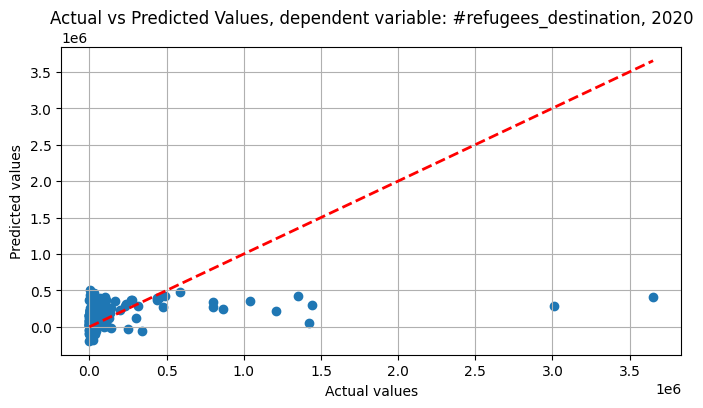

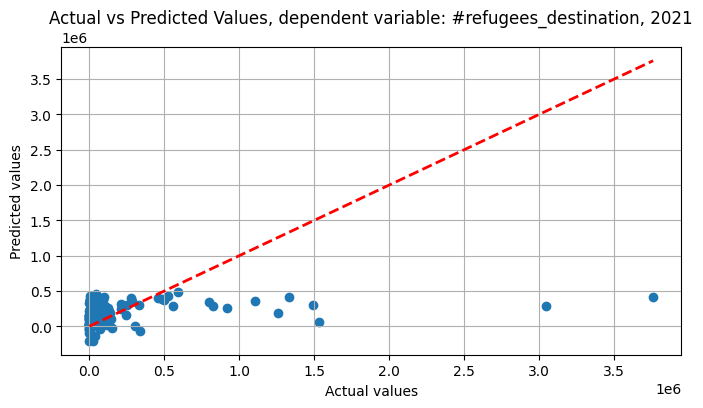

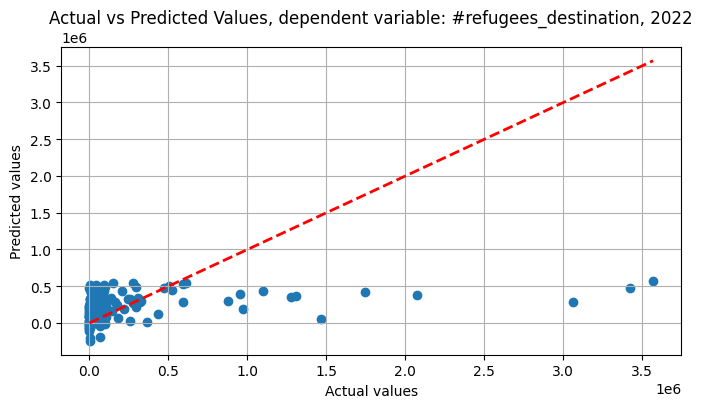

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic deve

In [92]:
print("\nTesting assumptions for destination:")
destination_results = test_assumptions(refugeedestination_worldrisk, '#refugees_destination', independent_vars)
destination_results

In [93]:
import statsmodels.api as sm
from scipy.stats import shapiro
from statsmodels.stats.diagnostic import het_breuschpagan, linear_rainbow
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.stats.stattools import durbin_watson

def test_assumptions(df, dependent_var, independent_vars):
    results = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = np.log(data_year[dependent_var])

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        try:
            model = sm.OLS(y, X).fit()
        except Exception as e:
            results.append({
                'Year': year,
                'Error': f'Error fitting OLS model: {str(e)}'
            })
            continue

        # 1. Linearity check using Rainbow test
        rainbow_statistic, p_rainbow = linear_rainbow(model)
        if p_rainbow < 0.05:
            linearity_conclusion = 'Violates linearity assumption (Rainbow test)'
        else:
            linearity_conclusion = 'Satisfies linearity assumption (Rainbow test)'

        # Linearity check using Actual vs Predicted plot
        y_pred = model.predict(X)

        plt.figure(figsize=(8, 4))
        plt.scatter(y, y_pred)
        plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2)
        plt.xlabel('Actual values')
        plt.ylabel('Predicted values')
        plt.title(f'Actual vs Predicted Values, dependent variable: {dependent_var}, {year}')
        plt.grid(True)
        plt.show()

        # 2. Normality of residuals using Shapiro-Wilk test
        residuals = model.resid
        _, p_shapiro = shapiro(residuals)
        if p_shapiro < 0.05:
            normality_conclusion = 'Residuals are not normally distributed (Shapiro-Wilk)'
        else:
            normality_conclusion = 'Residuals are normally distributed (Shapiro-Wilk)'

        # 3. Homoscedasticity using Breusch-Pagan test
        _, p_breuschpagan, _, _ = het_breuschpagan(residuals, model.model.exog)
        if p_breuschpagan < 0.05:
            homoscedasticity_conclusion = 'Violates homoscedasticity assumption'
        else:
            homoscedasticity_conclusion = 'Satisfies homoscedasticity assumption'

        # 4. Autocorrelation using Durbin-Watson test
        dw_statistic = durbin_watson(residuals)
        if dw_statistic < 1.5:
            autocorrelation_conclusion = 'Positive autocorrelation detected (Durbin-Watson test)'
        elif dw_statistic > 2.5:
            autocorrelation_conclusion = 'Negative autocorrelation detected (Durbin-Watson test)'
        else:
            autocorrelation_conclusion = 'No significant autocorrelation detected (Durbin-Watson test)'

        # 5. Multicollinearity using VIF
        vif_data = data_year[independent_vars]
        vif = pd.DataFrame()
        vif["Variable"] = vif_data.columns
        vif["VIF"] = [variance_inflation_factor(vif_data.values, i) for i in range(vif_data.shape[1])]
        multicollinearity_conclusions = []
        for i, row in vif.iterrows():
            if row['VIF'] > 10:
                multicollinearity_conclusions.append(f"{row['Variable']} has high VIF (> 10), indicating multicollinearity")
            else:
                multicollinearity_conclusions.append(f"{row['Variable']} has VIF <= 10")

        # Append results for the current year
        results.append({
            'Year': year,
            'Linearity': linearity_conclusion,
            'Normality of Residuals': normality_conclusion,
            'Homoscedasticity': homoscedasticity_conclusion,
            'Autocorrelation': autocorrelation_conclusion,
            'Multicollinearity': multicollinearity_conclusions
        })

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    return results_df

# Define independent variables (excluding the dependent variable)
independent_vars = [
    'coastal floodings', 'riverine floodings', 'cyclones', 'droughts', 
    'lack of socio-economic development', 'lack of coping capacities', 'sea level rise'
]

pd.set_option('display.max_colwidth', None)


Testing assumptions for origin:


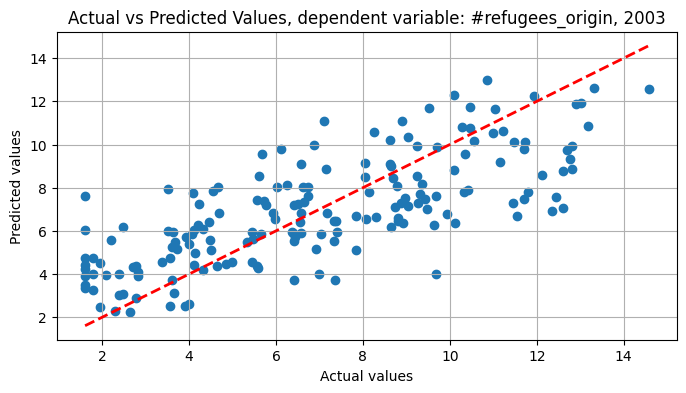

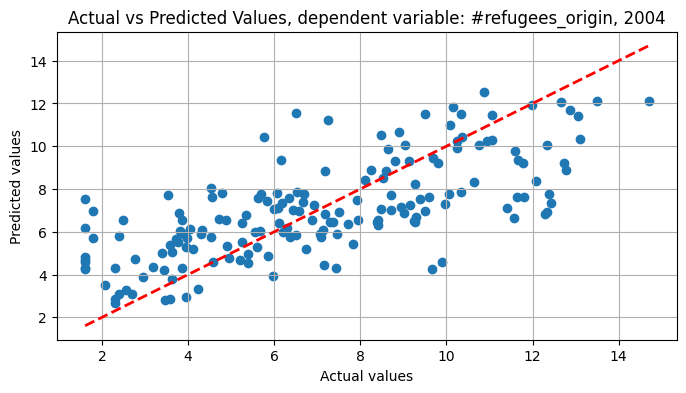

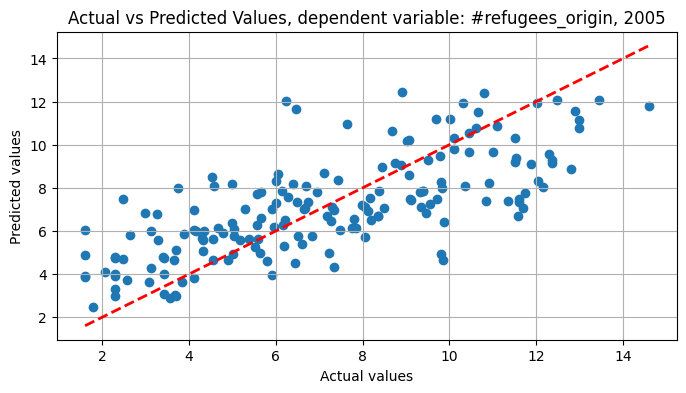

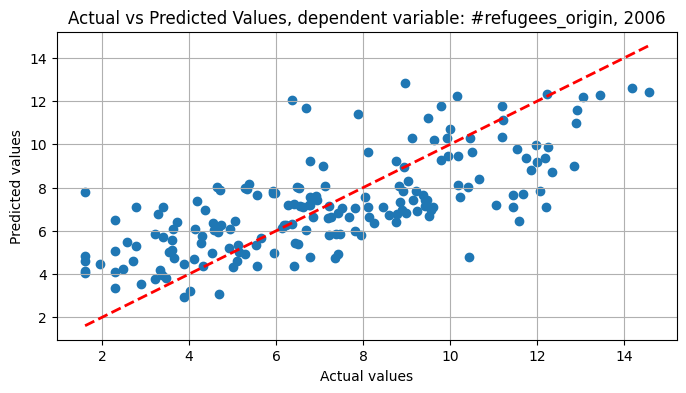

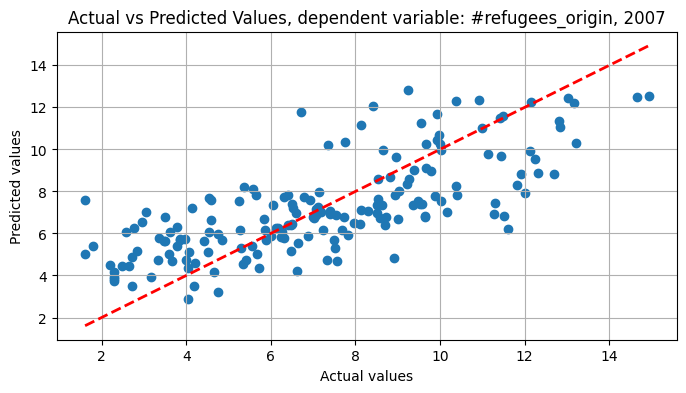

...

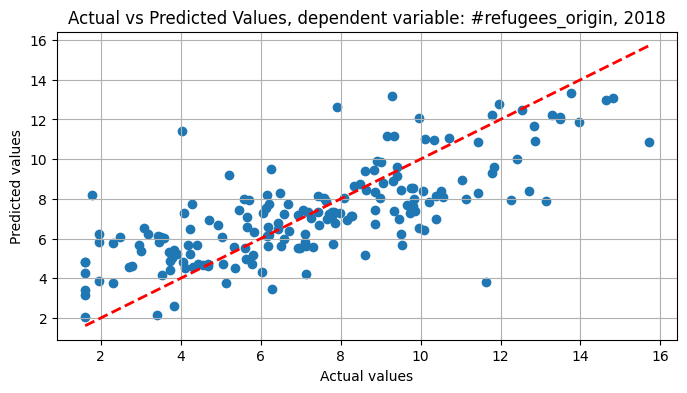

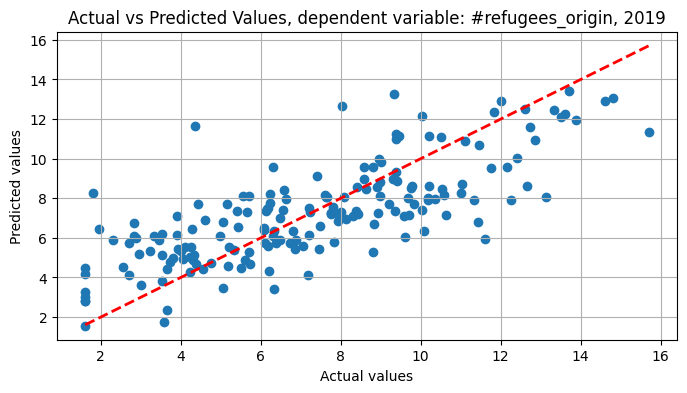

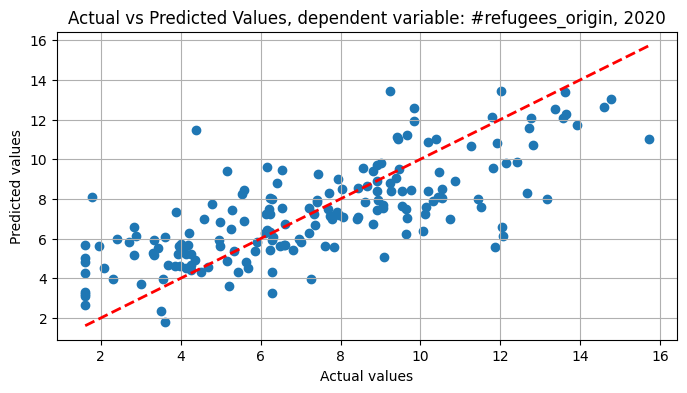

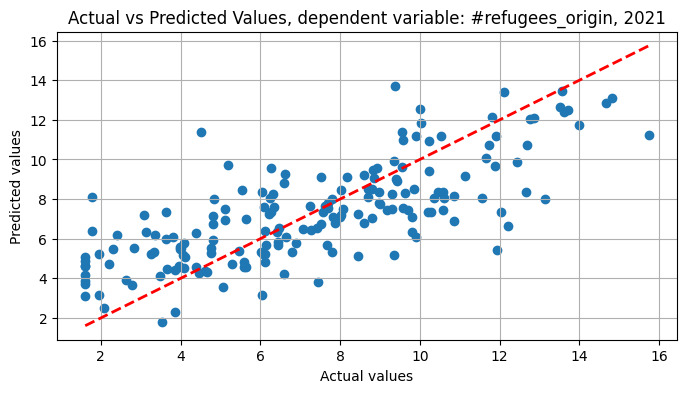

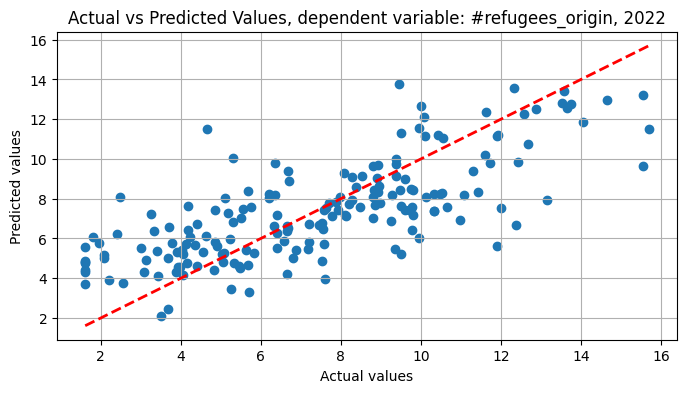

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of copin

In [94]:
print("\nTesting assumptions for origin:")
origin_results = test_assumptions(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
origin_results


Testing assumptions for destination:


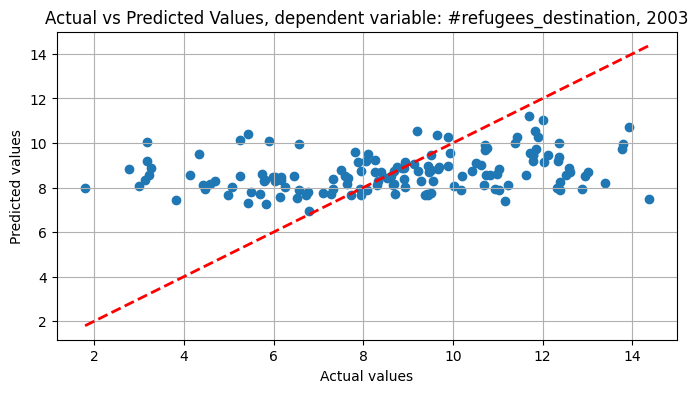

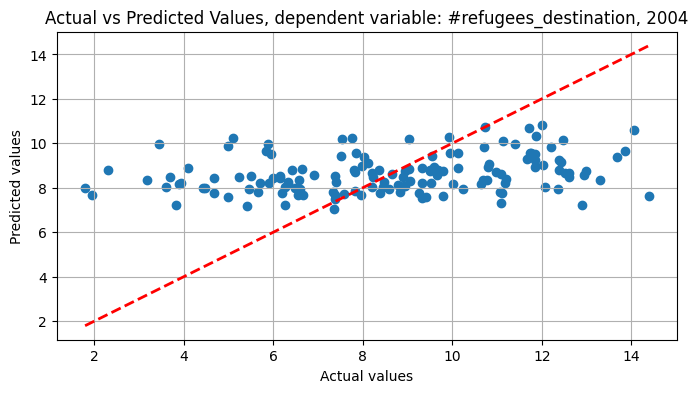

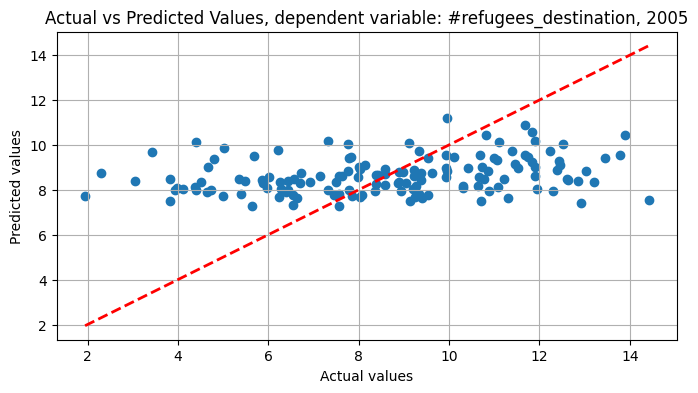

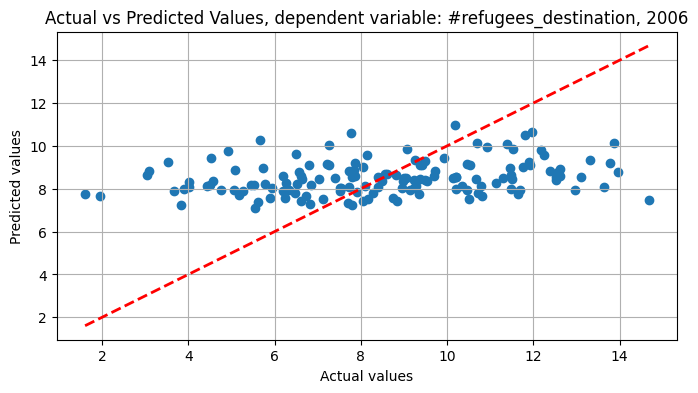

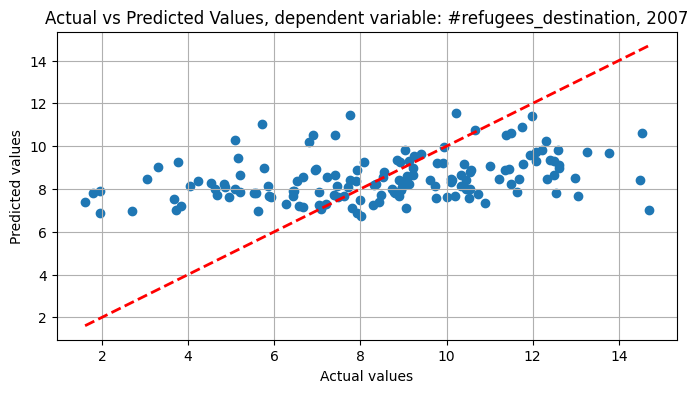

...

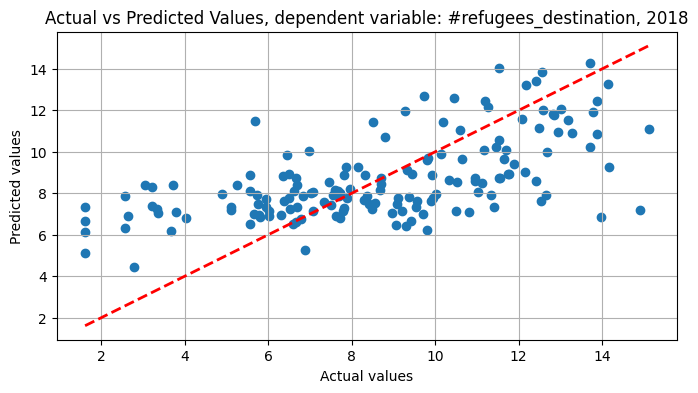

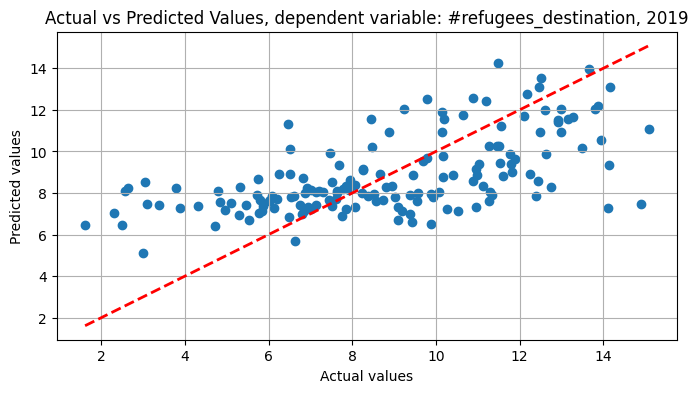

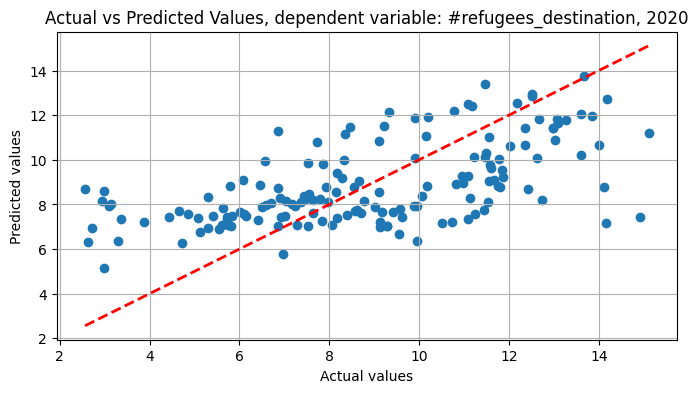

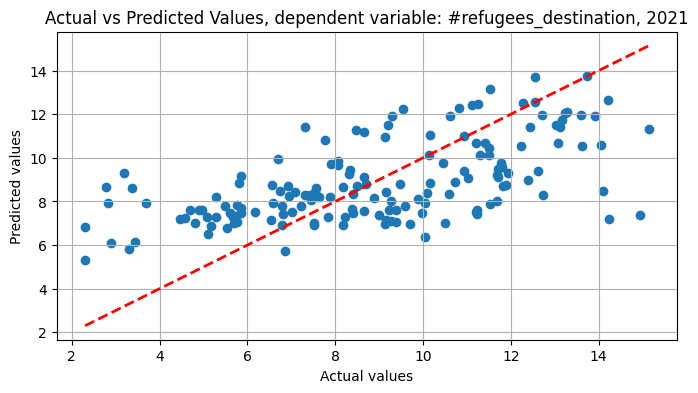

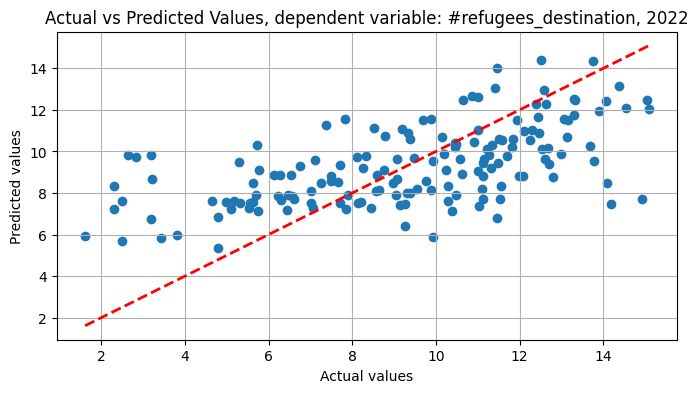

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are not normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of c

In [95]:
print("\nTesting assumptions for destination:")
destination_results = test_assumptions(refugeedestination_worldrisk, '#refugees_destination', independent_vars)
destination_results

With both X and y log scaled

In [96]:
import statsmodels.api as sm
from scipy.stats import shapiro
from statsmodels.stats.diagnostic import het_breuschpagan, linear_rainbow
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.stats.stattools import durbin_watson

def test_assumptions(df, dependent_var, independent_vars):
    results = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = np.log(data_year[independent_vars])
        y = np.log(data_year[dependent_var])

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        try:
            model = sm.OLS(y, X).fit()
        except Exception as e:
            results.append({
                'Year': year,
                'Error': f'Error fitting OLS model: {str(e)}'
            })
            continue

        # 1. Linearity check using Rainbow test
        rainbow_statistic, p_rainbow = linear_rainbow(model)
        if p_rainbow < 0.05:
            linearity_conclusion = 'Violates linearity assumption (Rainbow test)'
        else:
            linearity_conclusion = 'Satisfies linearity assumption (Rainbow test)'

        # Linearity check using Actual vs Predicted plot
        y_pred = model.predict(X)

        plt.figure(figsize=(8, 4))
        plt.scatter(y, y_pred)
        plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2)
        plt.xlabel('Actual values')
        plt.ylabel('Predicted values')
        plt.title(f'Actual vs Predicted Values, dependent variable: {dependent_var}, {year}')
        plt.grid(True)
        plt.show()

        # 2. Normality of residuals using Shapiro-Wilk test
        residuals = model.resid
        _, p_shapiro = shapiro(residuals)
        if p_shapiro < 0.05:
            normality_conclusion = 'Residuals are not normally distributed (Shapiro-Wilk)'
        else:
            normality_conclusion = 'Residuals are normally distributed (Shapiro-Wilk)'

        # 3. Homoscedasticity using Breusch-Pagan test
        _, p_breuschpagan, _, _ = het_breuschpagan(residuals, model.model.exog)
        if p_breuschpagan < 0.05:
            homoscedasticity_conclusion = 'Violates homoscedasticity assumption'
        else:
            homoscedasticity_conclusion = 'Satisfies homoscedasticity assumption'

        # 4. Autocorrelation using Durbin-Watson test
        dw_statistic = durbin_watson(residuals)
        if dw_statistic < 1.5:
            autocorrelation_conclusion = 'Positive autocorrelation detected (Durbin-Watson test)'
        elif dw_statistic > 2.5:
            autocorrelation_conclusion = 'Negative autocorrelation detected (Durbin-Watson test)'
        else:
            autocorrelation_conclusion = 'No significant autocorrelation detected (Durbin-Watson test)'

        # 5. Multicollinearity using VIF
        vif_data = data_year[independent_vars]
        vif = pd.DataFrame()
        vif["Variable"] = vif_data.columns
        vif["VIF"] = [variance_inflation_factor(vif_data.values, i) for i in range(vif_data.shape[1])]
        multicollinearity_conclusions = []
        for i, row in vif.iterrows():
            if row['VIF'] > 10:
                multicollinearity_conclusions.append(f"{row['Variable']} has high VIF (> 10), indicating multicollinearity")
            else:
                multicollinearity_conclusions.append(f"{row['Variable']} has VIF <= 10")

        # Append results for the current year
        results.append({
            'Year': year,
            'Linearity': linearity_conclusion,
            'Normality of Residuals': normality_conclusion,
            'Homoscedasticity': homoscedasticity_conclusion,
            'Autocorrelation': autocorrelation_conclusion,
            'Multicollinearity': multicollinearity_conclusions
        })

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    return results_df

# Define independent variables (excluding the dependent variable)
independent_vars = [
    'coastal floodings', 'riverine floodings', 'cyclones', 'droughts', 
    'lack of socio-economic development', 'lack of coping capacities', 'sea level rise'
]

pd.set_option('display.max_colwidth', None)


Testing assumptions for origin:


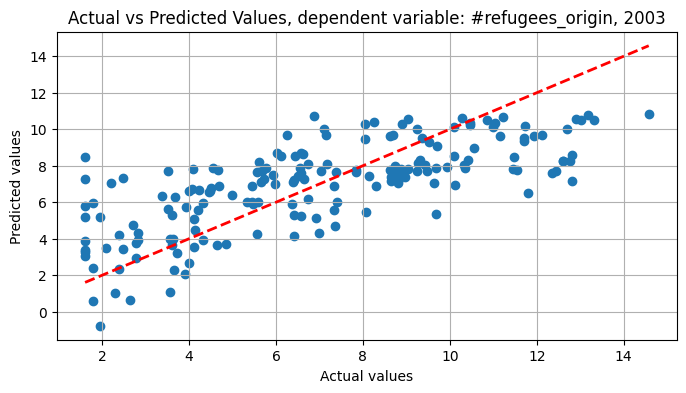

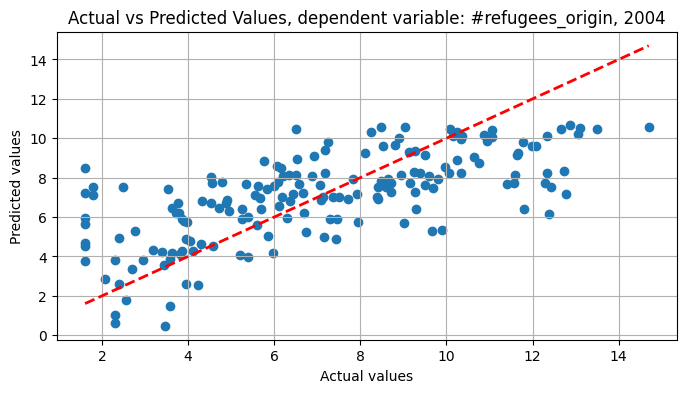

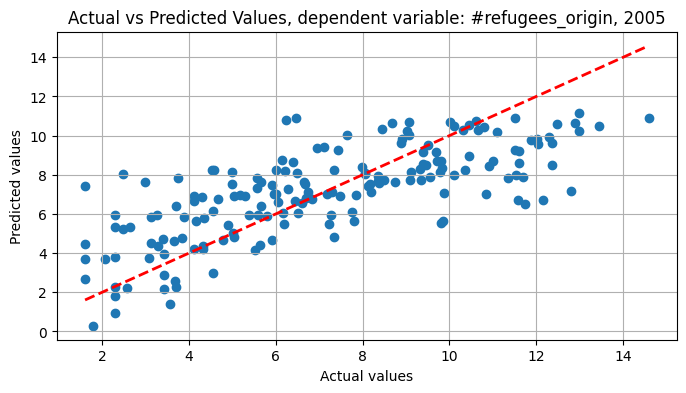

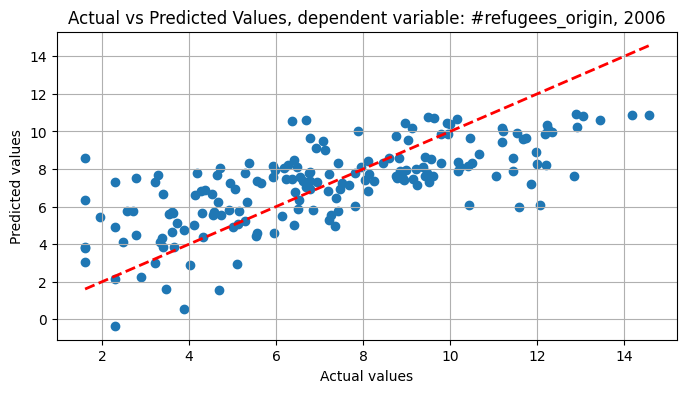

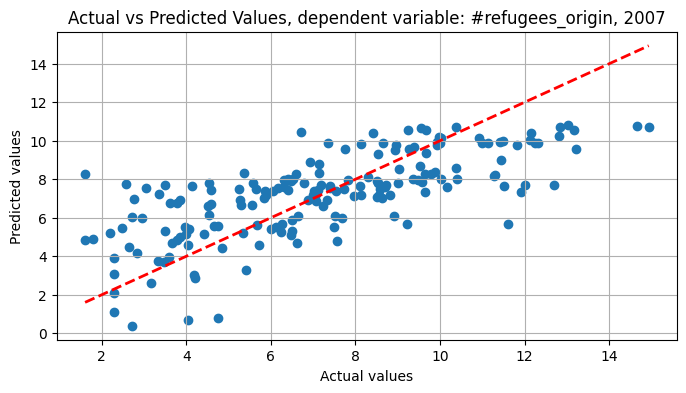

...

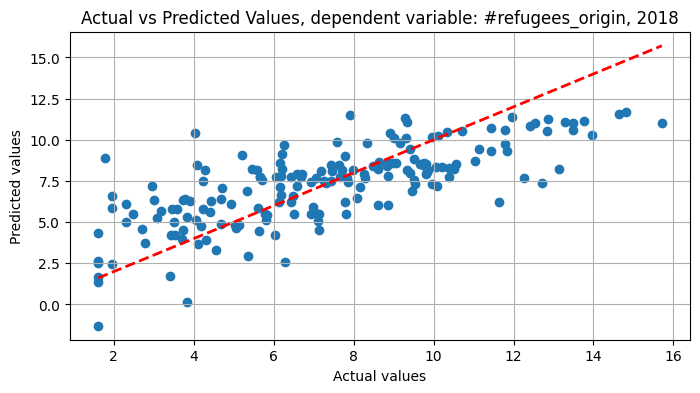

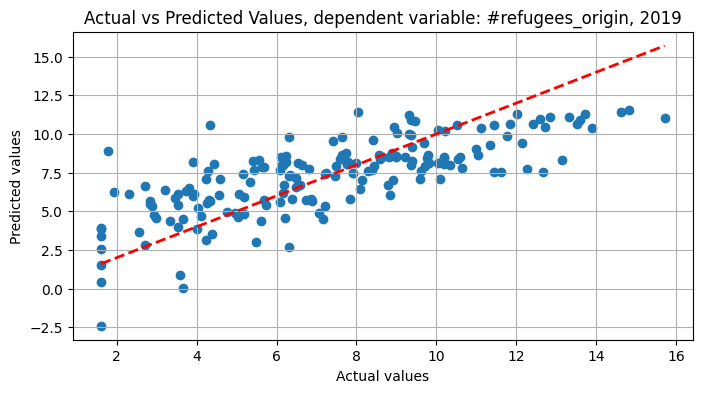

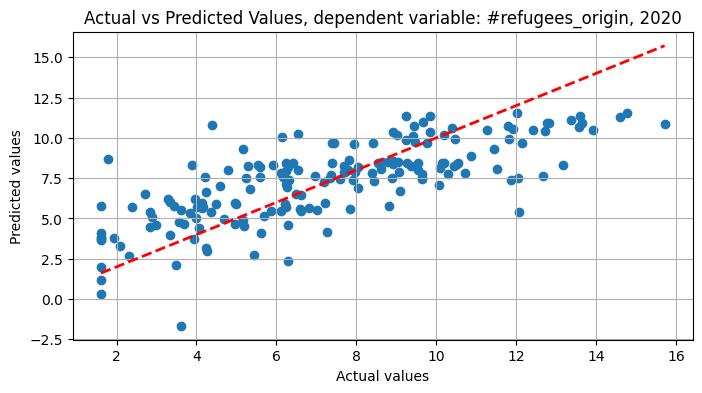

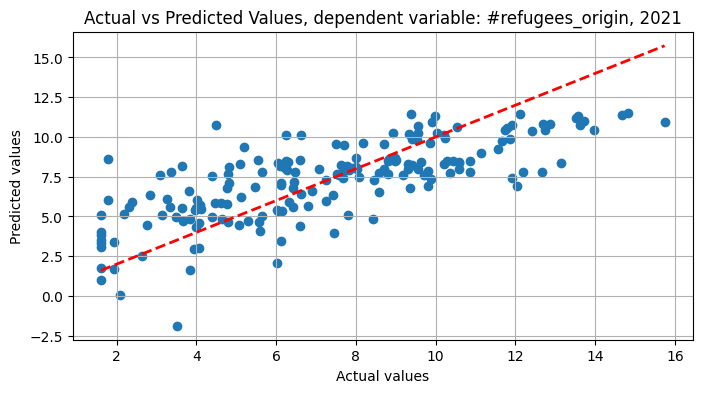

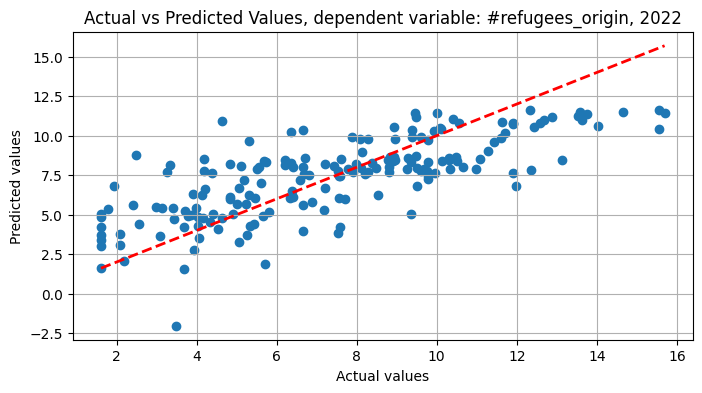

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Violates homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping

In [97]:
print("\nTesting assumptions for origin:")
origin_results = test_assumptions(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
origin_results


Testing assumptions for destination:


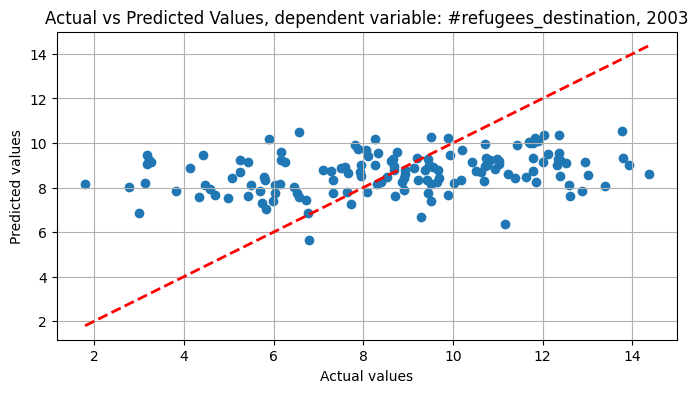

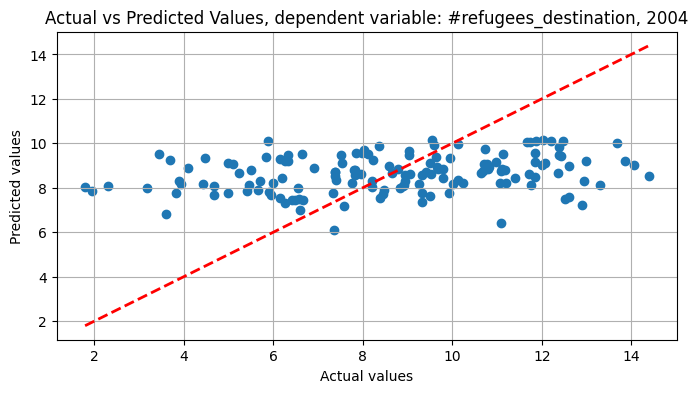

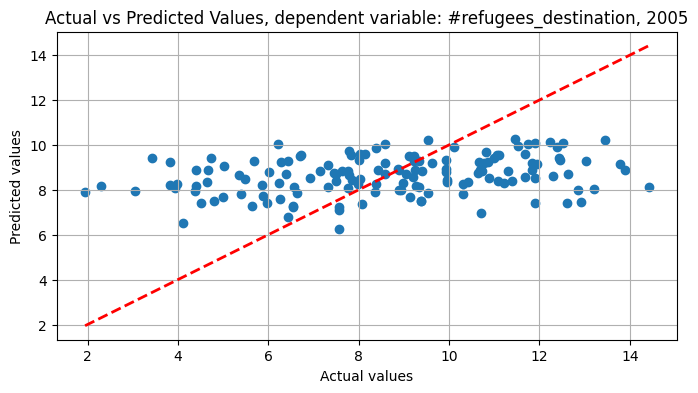

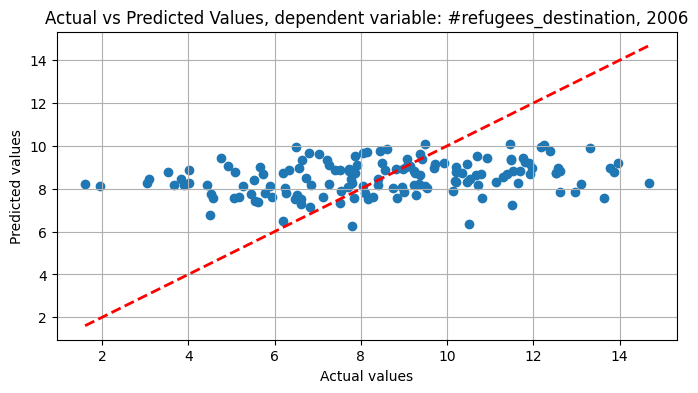

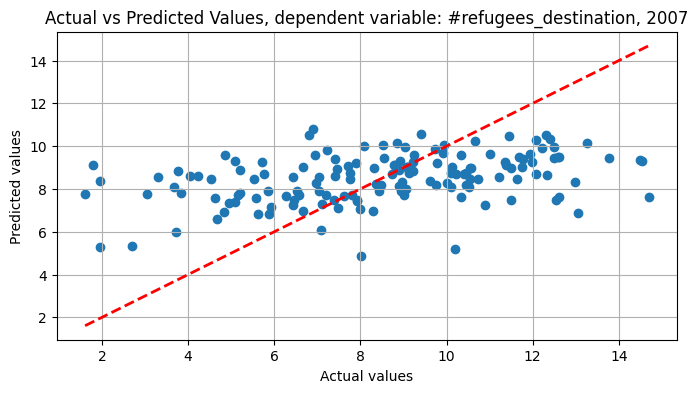

...

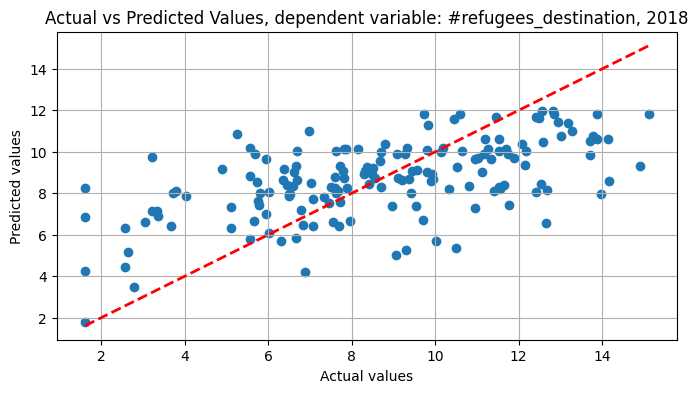

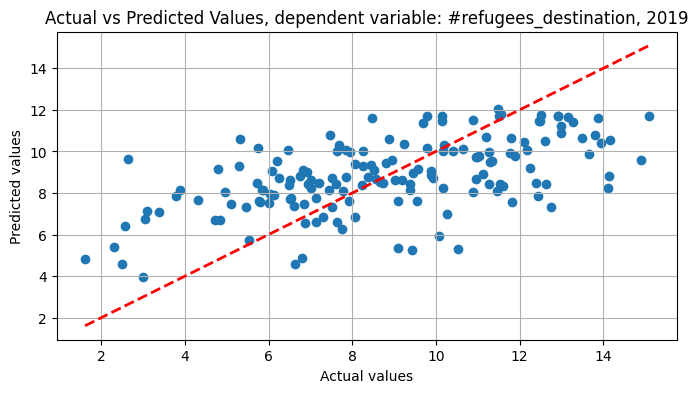

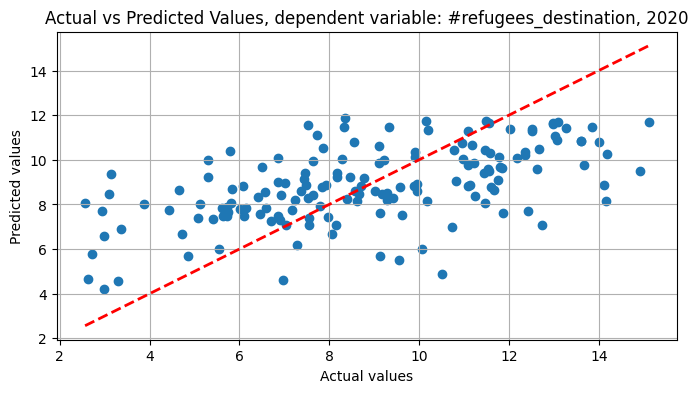

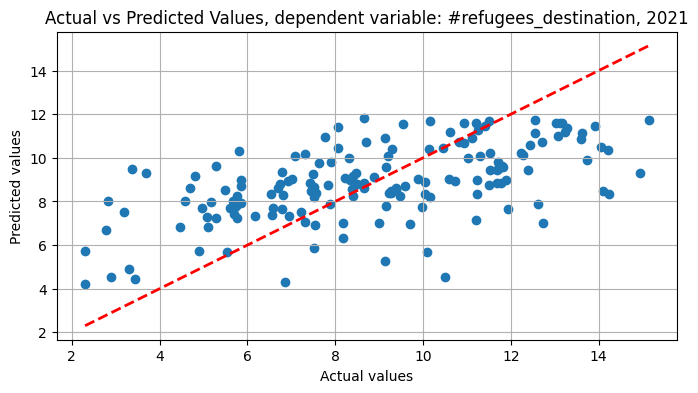

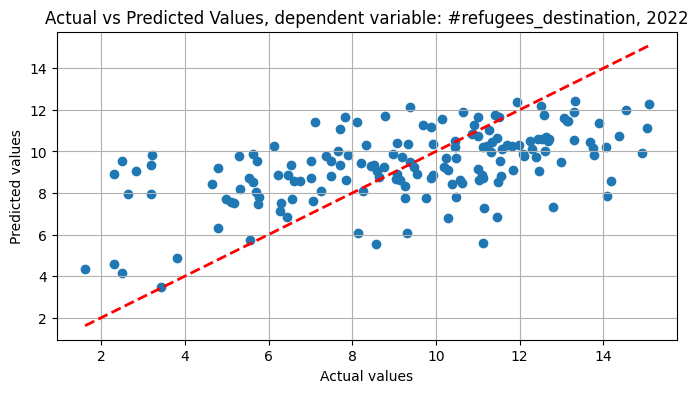

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation,Multicollinearity
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of coping capacities has VIF <= 10, sea level rise has VIF <= 10]"
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test),"[coastal floodings has VIF <= 10, riverine floodings has VIF <= 10, cyclones has VIF <= 10, droughts has VIF <= 10, lack of socio-economic development has VIF <= 10, lack of copin

In [98]:
print("\nTesting assumptions for destination:")
destination_results = test_assumptions(refugeedestination_worldrisk, '#refugees_destination', independent_vars)
destination_results

Testing with higher order terms and interactions.

First, add the new terms to the dataframes.

In [99]:
independent_vars = [
    'coastal floodings', 'riverine floodings', 'cyclones', 'droughts', 
    'lack of socio-economic development', 'lack of coping capacities', 'sea level rise'
]

# Function to add interaction terms
def add_interaction_terms(df, variables):
    for i in range(len(variables)):
        for j in range(i + 1, len(variables)):
            var1 = variables[i]
            var2 = variables[j]
            df[f'{var1} * {var2}'] = df[var1] * df[var2]

# Function to add quadratic terms
def add_quadratic_terms(df, variables):
    for var in variables:
        df[f'{var}^2'] = df[var] ** 2

# Function to add cubic terms
def add_cubic_terms(df, variables):
    for var in variables:
        df[f'{var}^3'] = df[var] ** 3

# Add interaction terms
add_interaction_terms(refugeeorigin_worldrisk, independent_vars)
add_interaction_terms(refugeedestination_worldrisk, independent_vars)

# Add quadratic terms
add_quadratic_terms(refugeeorigin_worldrisk, independent_vars)
add_quadratic_terms(refugeedestination_worldrisk, independent_vars)

# Add cubic terms
add_cubic_terms(refugeeorigin_worldrisk, independent_vars)
add_cubic_terms(refugeedestination_worldrisk, independent_vars)

# Example usage:
print("Example of modified refugeeorigin_worldrisk dataframe:")
refugeeorigin_worldrisk.head() # Display the first few rows to verify changes


Example of modified refugeeorigin_worldrisk dataframe:


,Year,#refugees_origin,coastal floodings,riverine floodings,cyclones,droughts,sea level rise,lack of socio-economic development,socio-economic deprivation,societal disparities,...,lack of socio-economic development^2,lack of coping capacities^2,sea level rise^2,coastal floodings^3,riverine floodings^3,cyclones^3,droughts^3,lack of socio-economic development^3,lack of coping capacities^3,sea level rise^3
0,2003,2136039,0.01,46.39,0.01,2.49,0.01,67.49,68.10,71.21,...,4554.9001,5580.0900,0.0001,0.000001,99832.769119,0.000001,15.438249,307410.207749,416832.723000,0.000001
1,2004,2414460,0.01,46.33,0.01,2.49,0.01,69.39,68.46,73.31,...,4814.9721,5387.5600,0.0001,0.000001,99445.904137,0.000001,15.438249,334110.914019,395446.904000,0.000001
2,2005,2166139,0.01,46.33,0.01,2.48,0.01,68.65,67.74,70.31,...,4712.8225,4828.8601,0.0001,0.000001,99445.904137,0.000001,15.252992,323535.264625,335557.488349,0.000001
3,2006,2107510,0.01,46.40,0.01,2.48,0.01,70.31,65.89,70.49,...,4943.4961,5686.6681,0.0001,0.000001,99897.344000,0.000001,15.252992,347577.210791,428831.641421,0.000001
4,2007,3057655,0.01,46.53,0.01,2.48,0.01,69.70,65.09,73.22,...,4858.0900,5925.9204,0.0001,0.000001,100739.353077,0.000001,15.252992,338608.873000,456177.352392,0.000001


In [100]:
refugeeorigin_worldrisk.columns

Index(['Year', '#refugees_origin', 'coastal floodings', 'riverine floodings',
       'cyclones', 'droughts', 'sea level rise',
       'lack of socio-economic development', 'socio-economic deprivation',
       'societal disparities', 'lack of coping capacities',
       'lack of adaptive capacities', 'coastal floodings * riverine floodings',
       'coastal floodings * cyclones', 'coastal floodings * droughts',
       'coastal floodings * lack of socio-economic development',
       'coastal floodings * lack of coping capacities',
       'coastal floodings * sea level rise', 'riverine floodings * cyclones',
       'riverine floodings * droughts',
       'riverine floodings * lack of socio-economic development',
       'riverine floodings * lack of coping capacities',
       'riverine floodings * sea level rise', 'cyclones * droughts',
       'cyclones * lack of socio-economic development',
       'cyclones * lack of coping capacities', 'cyclones * sea level rise',
       'droughts * lack 

Now do the tests again.

In [101]:
import statsmodels.api as sm
from scipy.stats import shapiro
from statsmodels.stats.diagnostic import het_breuschpagan, linear_rainbow
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.stats.stattools import durbin_watson

def test_assumptions(df, dependent_var, independent_vars):
    results = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = np.log(data_year[dependent_var])

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        try:
            model = sm.OLS(y, X).fit()
        except Exception as e:
            results.append({
                'Year': year,
                'Error': f'Error fitting OLS model: {str(e)}'
            })
            continue

        # 1. Linearity check using Rainbow test
        rainbow_statistic, p_rainbow = linear_rainbow(model)
        if p_rainbow < 0.05:
            linearity_conclusion = 'Violates linearity assumption (Rainbow test)'
        else:
            linearity_conclusion = 'Satisfies linearity assumption (Rainbow test)'

        # Linearity check using Actual vs Predicted plot
        y_pred = model.predict(X)

        plt.figure(figsize=(8, 4))
        plt.scatter(y, y_pred)
        plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2)
        plt.xlabel('Actual values')
        plt.ylabel('Predicted values')
        plt.title(f'Actual vs Predicted Values, dependent variable: {dependent_var}, {year}')
        plt.grid(True)
        plt.show()

        # 2. Normality of residuals using Shapiro-Wilk test
        residuals = model.resid
        _, p_shapiro = shapiro(residuals)
        if p_shapiro < 0.05:
            normality_conclusion = 'Residuals are not normally distributed (Shapiro-Wilk)'
        else:
            normality_conclusion = 'Residuals are normally distributed (Shapiro-Wilk)'

        # 3. Homoscedasticity using Breusch-Pagan test
        _, p_breuschpagan, _, _ = het_breuschpagan(residuals, model.model.exog)
        if p_breuschpagan < 0.05:
            homoscedasticity_conclusion = 'Violates homoscedasticity assumption'
        else:
            homoscedasticity_conclusion = 'Satisfies homoscedasticity assumption'

        # 4. Autocorrelation using Durbin-Watson test
        dw_statistic = durbin_watson(residuals)
        if dw_statistic < 1.5:
            autocorrelation_conclusion = 'Positive autocorrelation detected (Durbin-Watson test)'
        elif dw_statistic > 2.5:
            autocorrelation_conclusion = 'Negative autocorrelation detected (Durbin-Watson test)'
        else:
            autocorrelation_conclusion = 'No significant autocorrelation detected (Durbin-Watson test)'

        # # 5. Multicollinearity using VIF
        # vif_data = data_year[independent_vars]
        # vif = pd.DataFrame()
        # vif["Variable"] = vif_data.columns
        # vif["VIF"] = [variance_inflation_factor(vif_data.values, i) for i in range(vif_data.shape[1])]
        # multicollinearity_conclusions = []
        # for i, row in vif.iterrows():
        #     if row['VIF'] > 10:
        #         multicollinearity_conclusions.append(f"{row['Variable']} has high VIF (> 10), indicating multicollinearity")
        #     else:
        #         multicollinearity_conclusions.append(f"{row['Variable']} has VIF <= 10")

        # Append results for the current year
        results.append({
            'Year': year,
            'Linearity': linearity_conclusion,
            'Normality of Residuals': normality_conclusion,
            'Homoscedasticity': homoscedasticity_conclusion,
            'Autocorrelation': autocorrelation_conclusion,
            #'Multicollinearity': multicollinearity_conclusions
        })

    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    return results_df

# Define independent variables (excluding the dependent variable)
independent_vars = ['coastal floodings', 'riverine floodings',
       'cyclones', 'droughts', 'sea level rise', 'lack of socio-economic development',
       'lack of coping capacities',
       'coastal floodings * riverine floodings',
       'coastal floodings * cyclones', 'coastal floodings * droughts',
       'coastal floodings * lack of socio-economic development',
       'coastal floodings * lack of coping capacities',
       'coastal floodings * sea level rise', 'riverine floodings * cyclones',
       'riverine floodings * droughts',
       'riverine floodings * lack of socio-economic development',
       'riverine floodings * lack of coping capacities',
       'riverine floodings * sea level rise', 'cyclones * droughts',
       'cyclones * lack of socio-economic development',
       'cyclones * lack of coping capacities', 'cyclones * sea level rise',
       'droughts * lack of socio-economic development',
       'droughts * lack of coping capacities', 'droughts * sea level rise',
       'lack of socio-economic development * lack of coping capacities',
       'lack of socio-economic development * sea level rise',
       'lack of coping capacities * sea level rise', 
       'coastal floodings^2',
       'riverine floodings^2', 'cyclones^2', 'droughts^2',
       'lack of socio-economic development^2', 'lack of coping capacities^2',
       'sea level rise^2', 'coastal floodings^3', 'riverine floodings^3',
       'cyclones^3', 'droughts^3', 'lack of socio-economic development^3',
       'lack of coping capacities^3', 'sea level rise^3']

pd.set_option('display.max_colwidth', None)

Testing assumptions for origin:


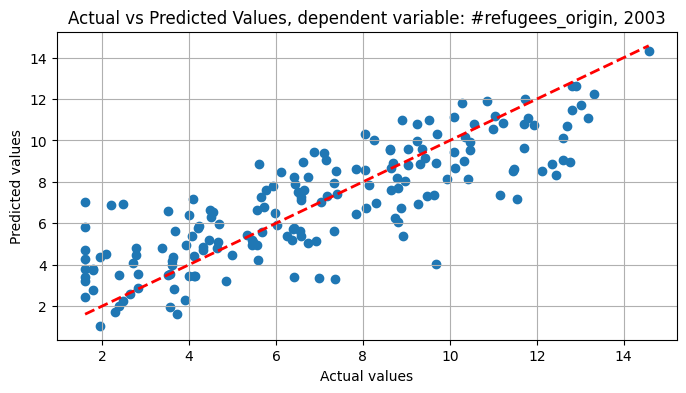

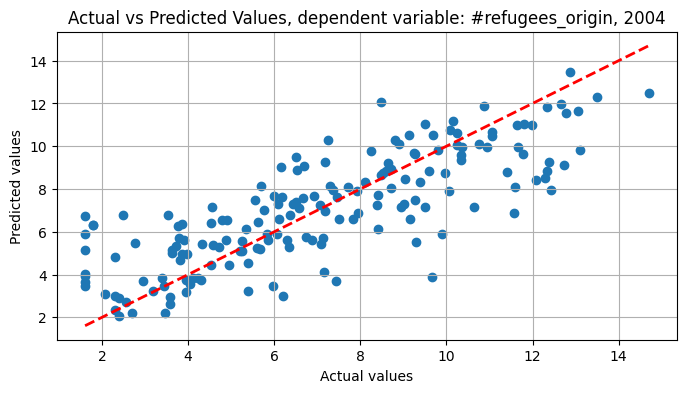

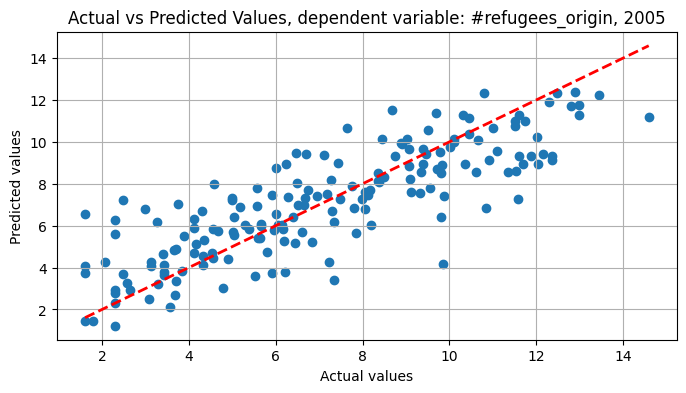

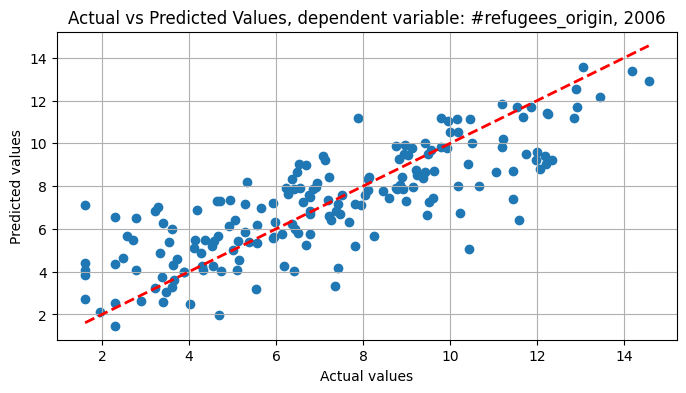

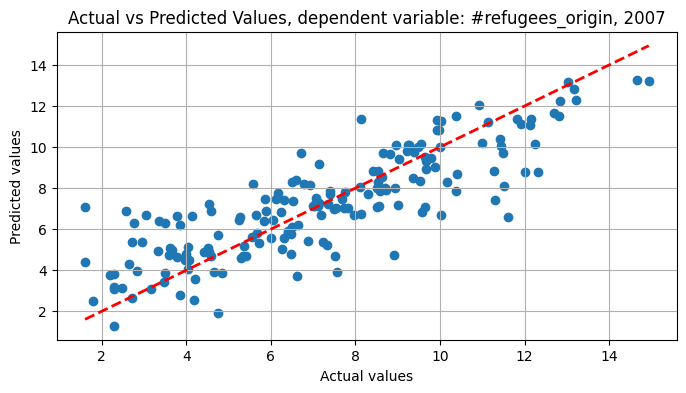

...

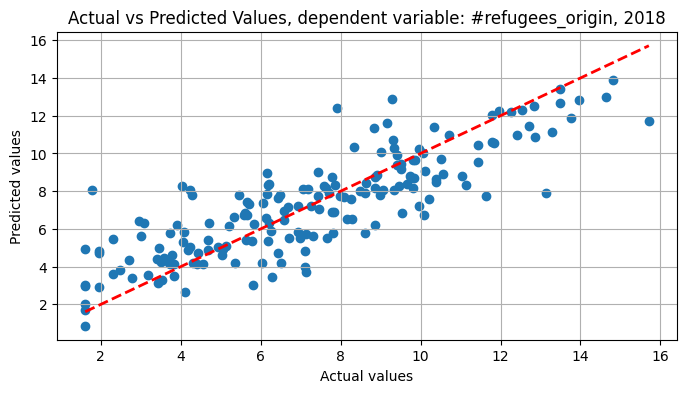

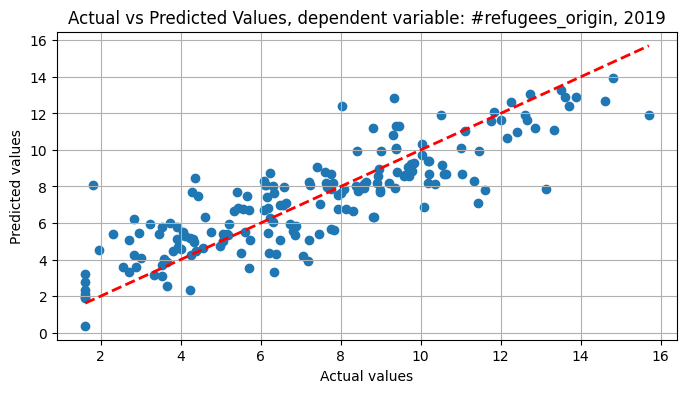

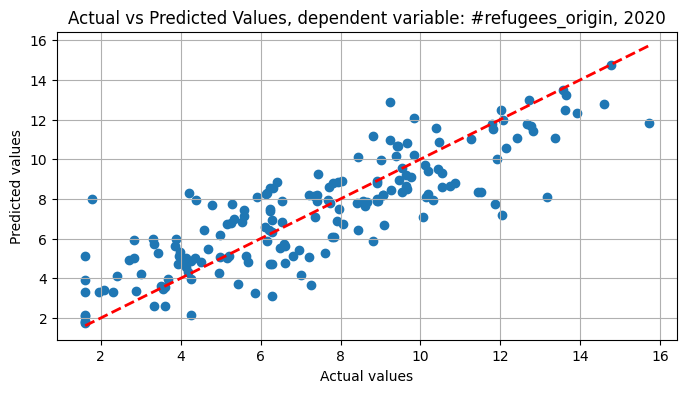

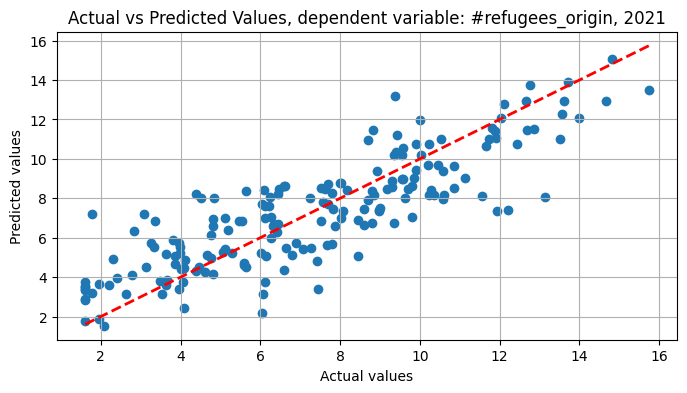

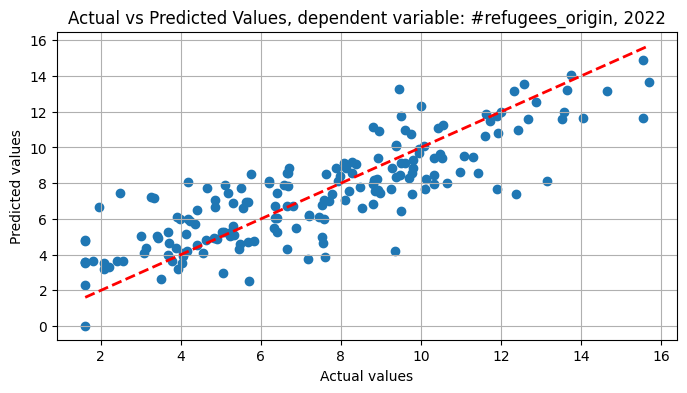

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
9,2012,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)


In [102]:
print("Testing assumptions for origin:")
origin_results = test_assumptions(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
origin_results

Check residuals vs fitted values for indepenence of residuals.

In [103]:
independent_vars

['coastal floodings',
 'riverine floodings',
 'cyclones',
 'droughts',
 'sea level rise',
 'lack of socio-economic development',
 'lack of coping capacities',
 'coastal floodings * riverine floodings',
 'coastal floodings * cyclones',
 'coastal floodings * droughts',
 'coastal floodings * lack of socio-economic development',
 'coastal floodings * lack of coping capacities',
 'coastal floodings * sea level rise',
 'riverine floodings * cyclones',
 'riverine floodings * droughts',
 'riverine floodings * lack of socio-economic development',
 'riverine floodings * lack of coping capacities',
 'riverine floodings * sea level rise',
 'cyclones * droughts',
 'cyclones * lack of socio-economic development',
 'cyclones * lack of coping capacities',
 'cyclones * sea level rise',
 'droughts * lack of socio-economic development',
 'droughts * lack of coping capacities',
 'droughts * sea level rise',
 'lack of socio-economic development * lack of coping capacities',
 'lack of socio-economic develop

In [104]:
independent_vars = ['coastal floodings',
 'riverine floodings',
 'cyclones',
 'droughts',
 'sea level rise',
 'lack of socio-economic development',
 'lack of coping capacities',
 'coastal floodings * riverine floodings',
 'coastal floodings * cyclones',
 'coastal floodings * droughts',
 'coastal floodings * lack of socio-economic development',
 'coastal floodings * lack of coping capacities',
 'coastal floodings * sea level rise',
 'riverine floodings * cyclones',
 'riverine floodings * droughts',
 'riverine floodings * lack of socio-economic development',
 'riverine floodings * lack of coping capacities',
 'riverine floodings * sea level rise',
 'cyclones * droughts',
 'cyclones * lack of socio-economic development',
 'cyclones * lack of coping capacities',
 'cyclones * sea level rise',
 'droughts * lack of socio-economic development',
 'droughts * lack of coping capacities',
 'droughts * sea level rise',
 'lack of socio-economic development * lack of coping capacities',
 'lack of socio-economic development * sea level rise',
 'lack of coping capacities * sea level rise',
 'coastal floodings^2',
 'riverine floodings^2',
 'cyclones^2',
 'droughts^2',
 'lack of socio-economic development^2',
 'lack of coping capacities^2',
 'sea level rise^2',
 'coastal floodings^3',
 'riverine floodings^3',
 'cyclones^3',
 'droughts^3',
 'lack of socio-economic development^3',
 'lack of coping capacities^3',
 'sea level rise^3']

In [105]:
def test_assumption(df, dependent_var, independent_vars):
    results = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = np.log(data_year[dependent_var])

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        try:
            model = sm.OLS(y, X).fit()
        except Exception as e:
            results.append({
                'Year': year,
                'Error': f'Error fitting OLS model: {str(e)}'
            })
            continue

        y_pred = model.predict(X)
        # Plot residuals vs. fitted values
        residuals = model.resid
        plt.figure(figsize=(8, 4))
        plt.scatter(y_pred, residuals)
        plt.axhline(y=0, color='r', linestyle='--', lw=2)
        plt.xlabel('Fitted values')
        plt.ylabel('Residuals')
        plt.title(f'Residuals vs. Fitted Values, dependent variable: {dependent_var}, {year}')
        plt.grid(True)
        plt.show()

Testing assumption for origin:


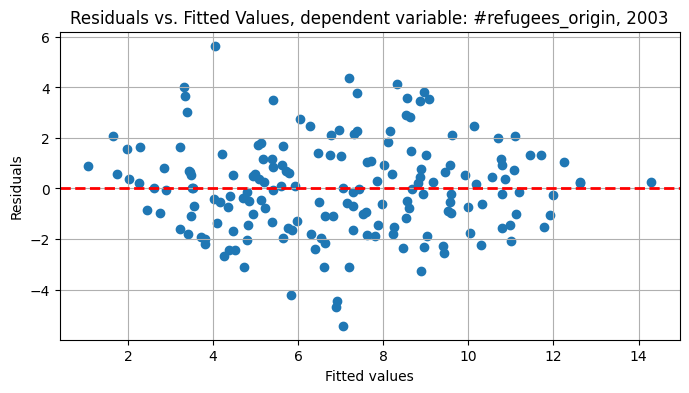

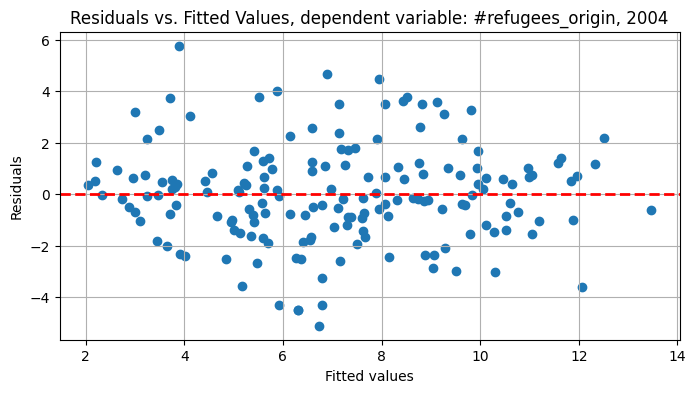

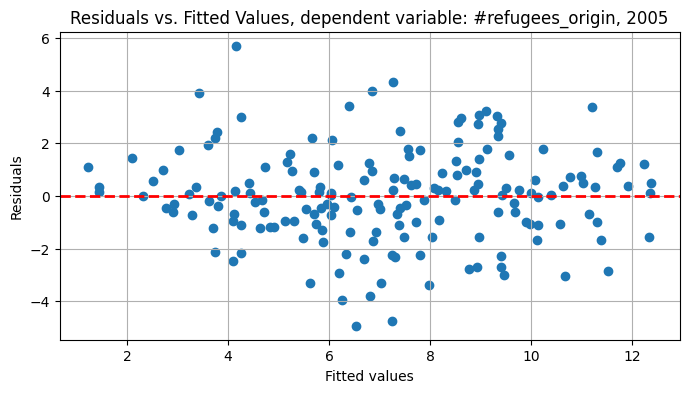

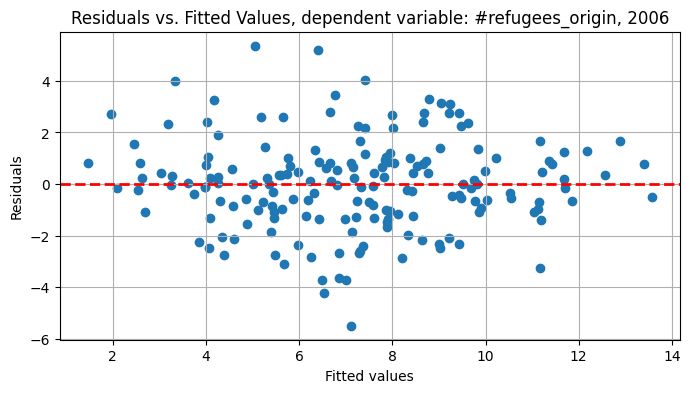

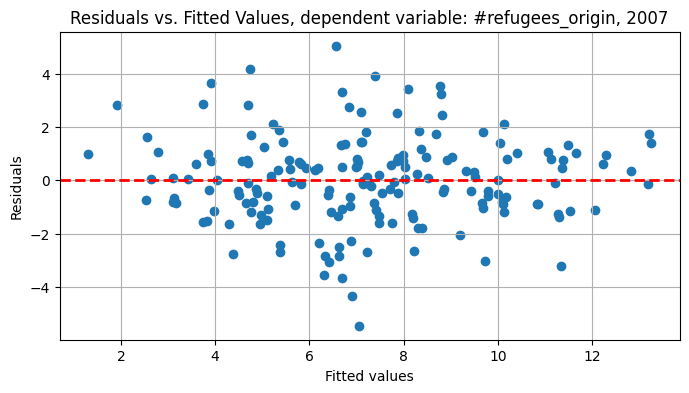

...

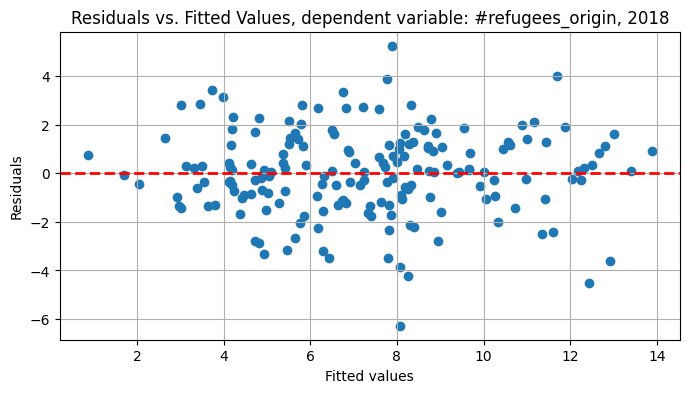

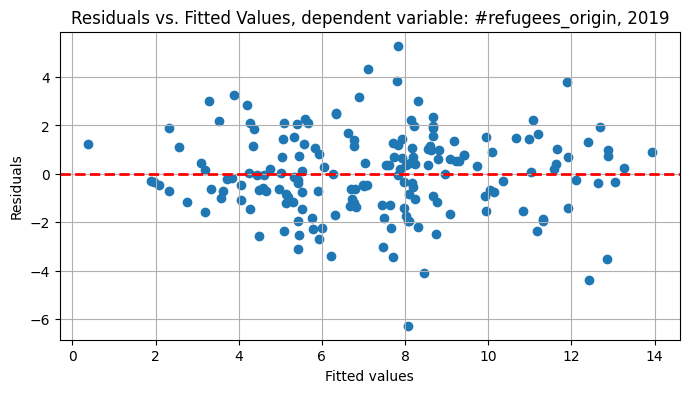

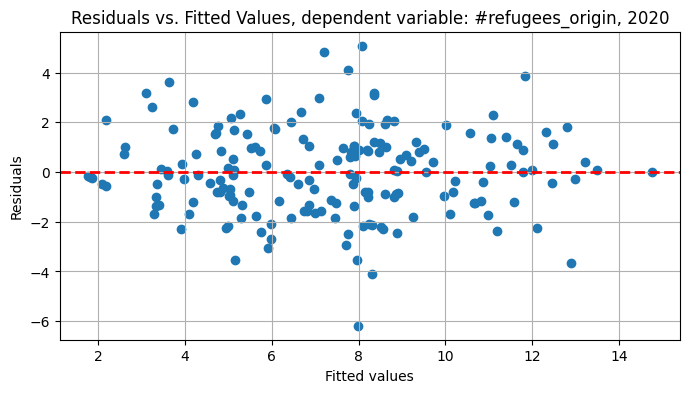

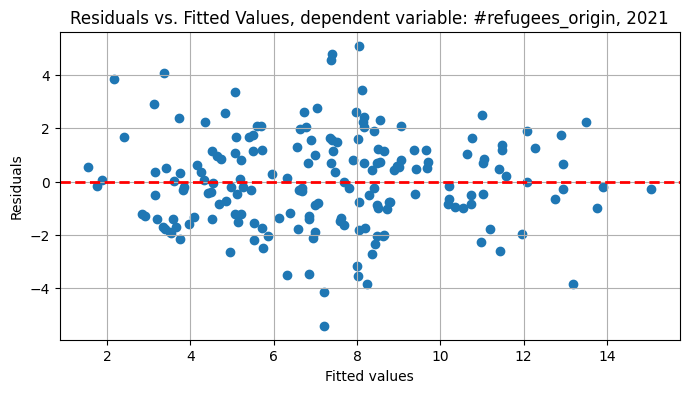

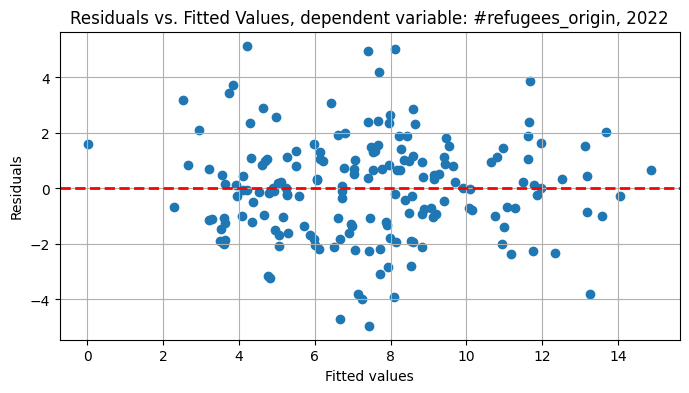

In [106]:
print("Testing assumption for origin:")
origin_test_assumption = test_assumption(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
origin_test_assumption

Below follow results for refugee destinations instead of origin locations as dependent variable.


Testing assumptions for destination:


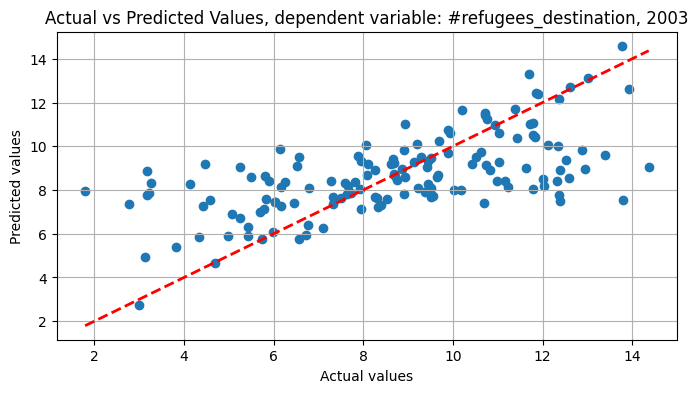

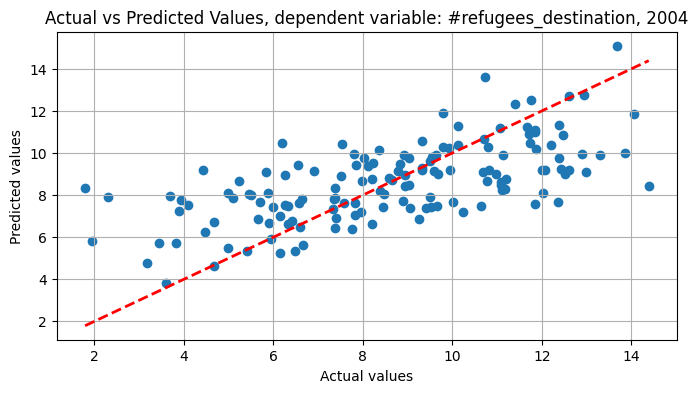

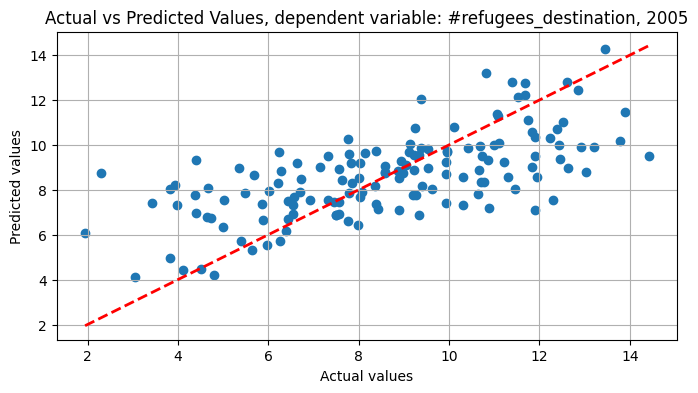

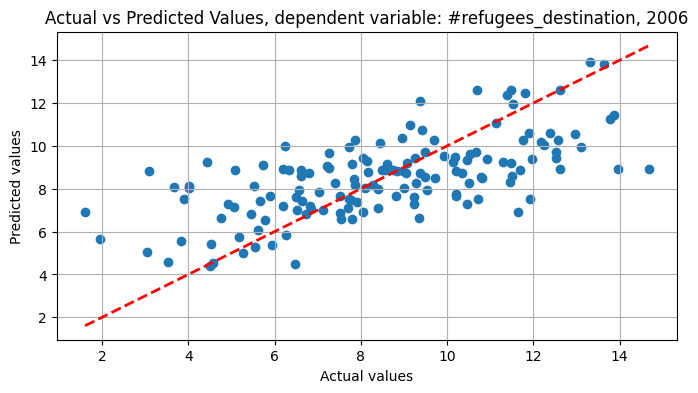

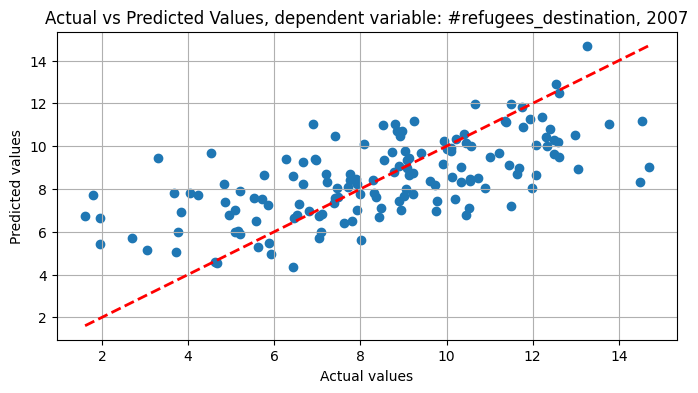

...

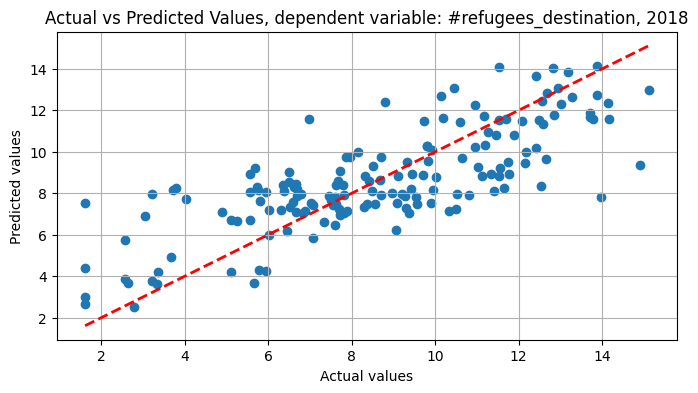

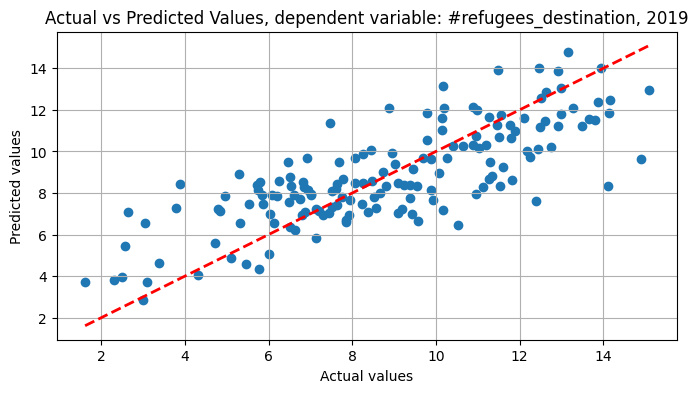

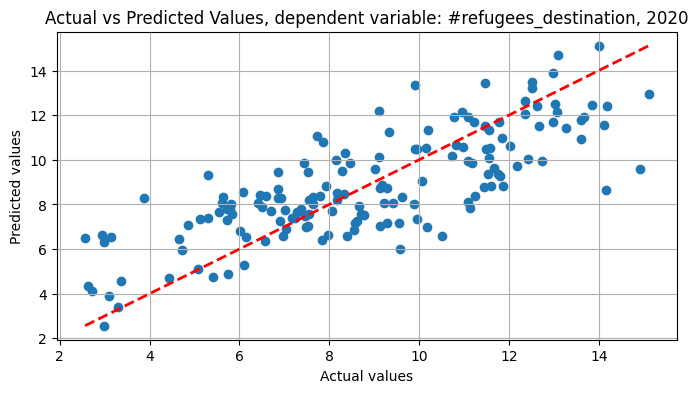

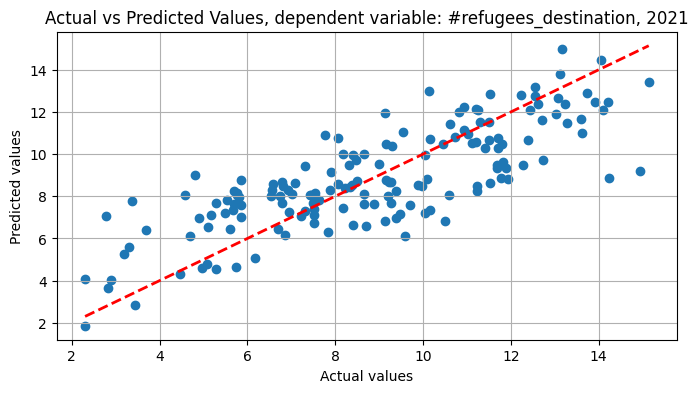

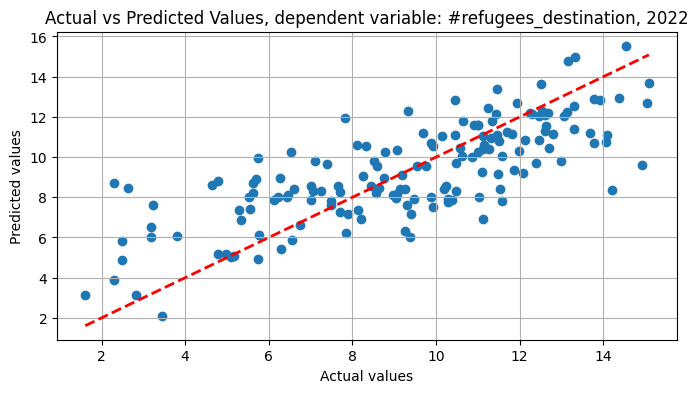

,Year,Linearity,Normality of Residuals,Homoscedasticity,Autocorrelation
0,2003,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
1,2004,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
2,2005,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
3,2006,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
4,2007,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
5,2008,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
6,2009,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
7,2010,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
8,2011,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)
9,2012,Satisfies linearity assumption (Rainbow test),Residuals are normally distributed (Shapiro-Wilk),Satisfies homoscedasticity assumption,No significant autocorrelation detected (Durbin-Watson test)


In [107]:
print("\nTesting assumptions for destination:")
destination_results = test_assumptions(refugeedestination_worldrisk, '#refugees_destination', independent_vars)
destination_results

Testing assumption for destination:


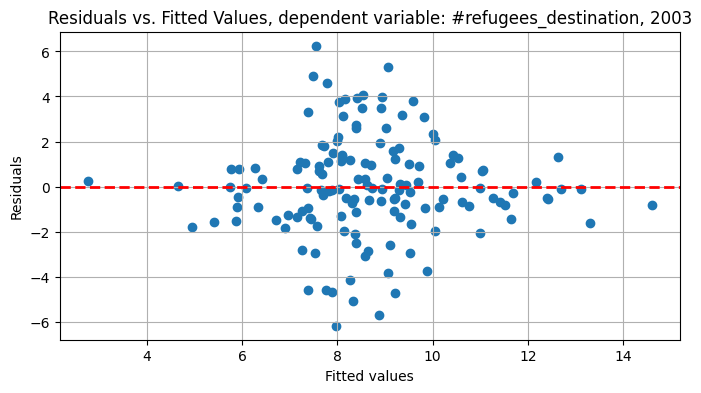

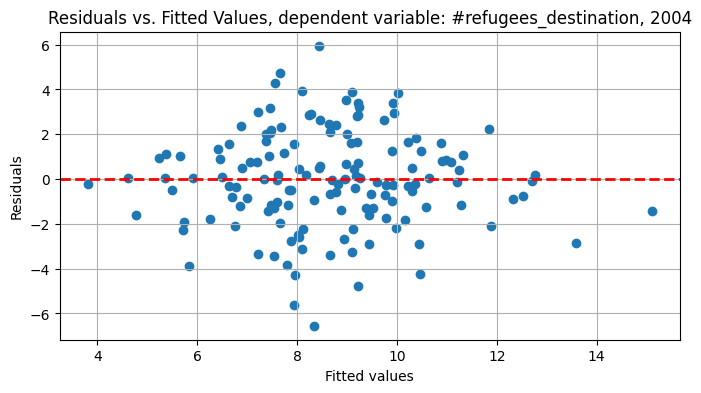

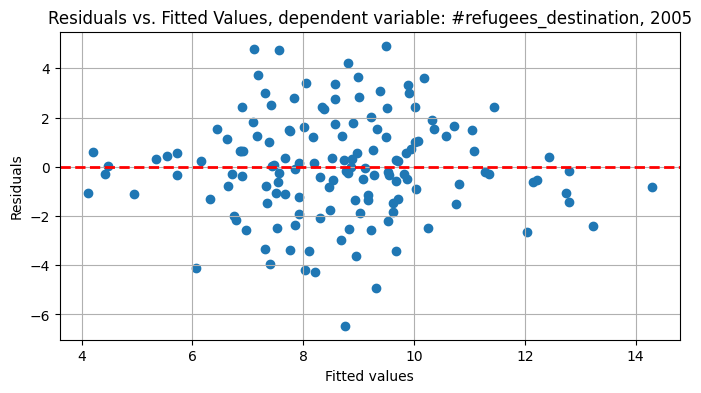

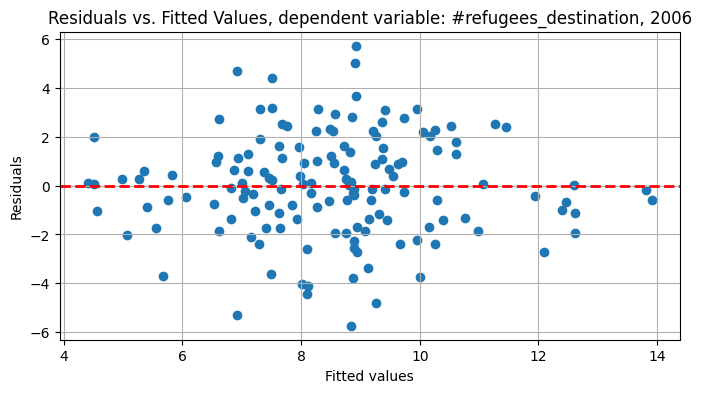

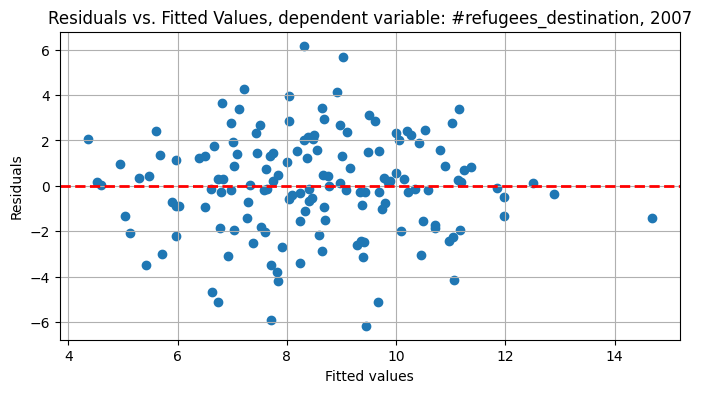

...

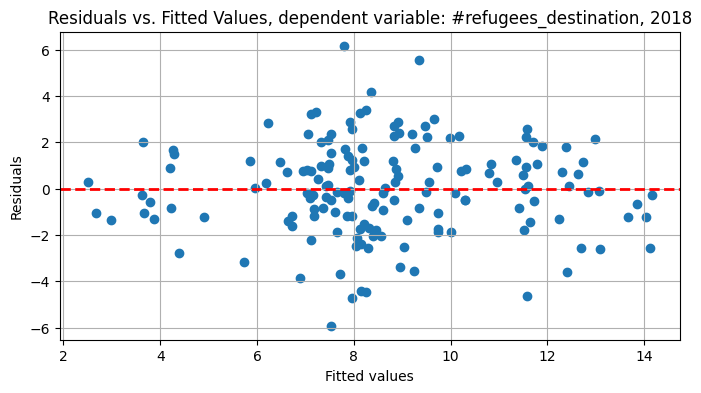

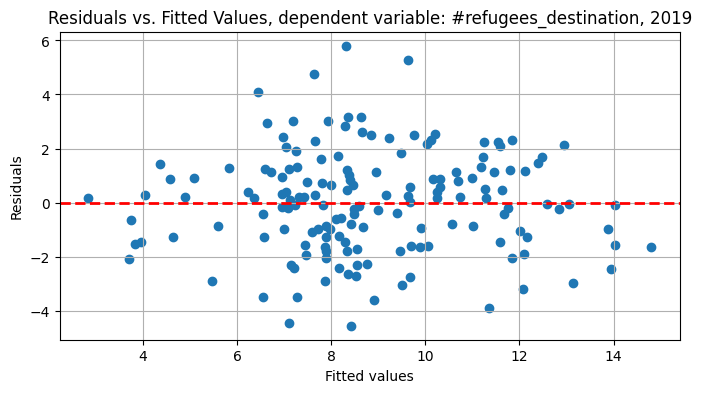

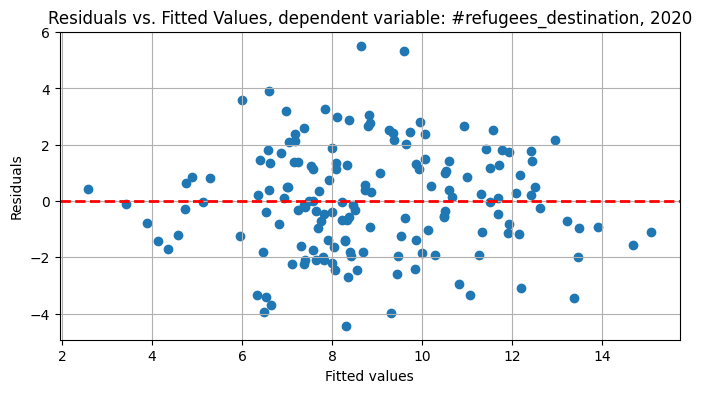

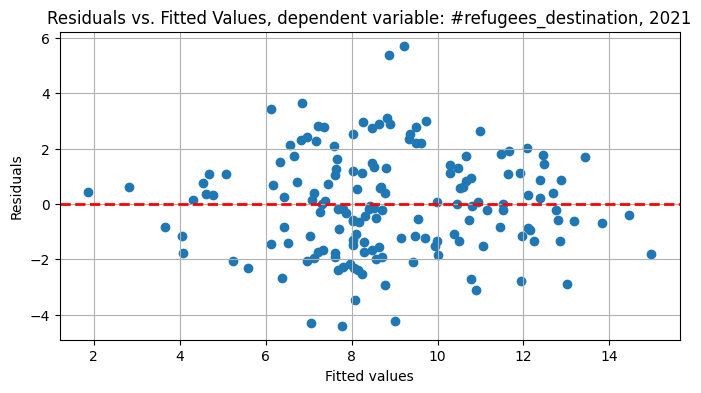

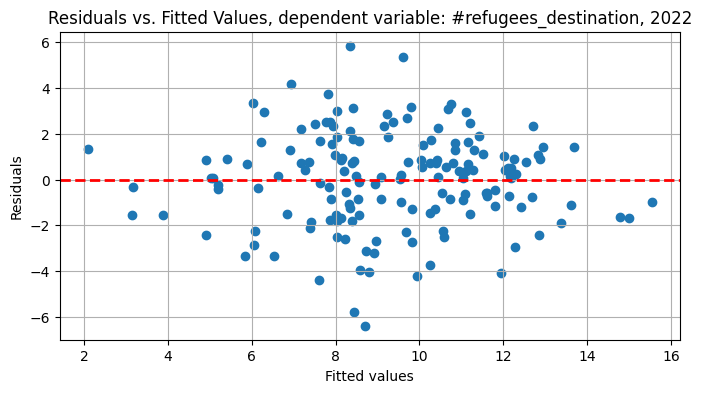

In [108]:
print("Testing assumption for destination:")
destination_test_assumption = test_assumption(refugeedestination_worldrisk, '#refugees_destination', independent_vars)
destination_test_assumption

Do the regression

In [109]:
pd.set_option('display.max_rows', None)  # Show all rows

In [110]:
import statsmodels.api as sm
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error

def run_regression_and_store(df, dependent_var, independent_vars):
    results = []
    performance_metrics = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = np.log(data_year[dependent_var])

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        model = sm.OLS(y, X).fit()
        
        # Predictions
        predictions = model.predict(X)
        
        # Calculate performance metrics
        r_squared = model.rsquared
        adj_r_squared = model.rsquared_adj
        mae = mean_absolute_error(y, predictions)
        mse = mean_squared_error(y, predictions)
        rmse = np.sqrt(mse)
        
        # Store the performance metrics
        performance_metrics.append({
            'Year': year,
            'R_squared': r_squared,
            'Adjusted_R_squared': adj_r_squared,
            'MAE': mae,
            'MSE': mse,
            'RMSE': rmse
        })
        
        # Store the results for the coefficients, including the intercept
        for variable in model.params.index:
            coef = model.params[variable]
            p_value = model.pvalues[variable]
            conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
            direction = 'Positive' if coef > 0 else 'Negative'
            results.append({
                'Year': year, 
                'Variable': variable, 
                'Coefficient': coef, 
                'P-value': p_value, 
                'Conclusion': conclusion,
                'Direction': direction
            })

    return pd.DataFrame(results), pd.DataFrame(performance_metrics)

# Define your independent variables
independent_vars = ['coastal floodings', 'riverine floodings',
       'cyclones', 'droughts', 'sea level rise', 'lack of socio-economic development',
       'lack of coping capacities',
       'coastal floodings * riverine floodings',
       'coastal floodings * cyclones', 'coastal floodings * droughts',
       'coastal floodings * lack of socio-economic development',
       'coastal floodings * lack of coping capacities',
       'coastal floodings * sea level rise', 'riverine floodings * cyclones',
       'riverine floodings * droughts',
       'riverine floodings * lack of socio-economic development',
       'riverine floodings * lack of coping capacities',
       'riverine floodings * sea level rise', 'cyclones * droughts',
       'cyclones * lack of socio-economic development',
       'cyclones * lack of coping capacities', 'cyclones * sea level rise',
       'droughts * lack of socio-economic development',
       'droughts * lack of coping capacities', 'droughts * sea level rise',
       'lack of socio-economic development * lack of coping capacities',
       'lack of socio-economic development * sea level rise',
       'lack of coping capacities * sea level rise', 
       'coastal floodings^2',
       'riverine floodings^2', 'cyclones^2', 'droughts^2',
       'lack of socio-economic development^2', 'lack of coping capacities^2',
       'sea level rise^2', 'coastal floodings^3', 'riverine floodings^3',
       'cyclones^3', 'droughts^3', 'lack of socio-economic development^3',
       'lack of coping capacities^3', 'sea level rise^3']

# Run the function for your datasets
origin_results_df, origin_performance_df = run_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
destination_results_df, destination_performance_df = run_regression_and_store(refugeedestination_worldrisk, '#refugees_destination', independent_vars)

In [111]:
# Display the results
#origin_results_df

In [112]:
origin_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.686729,0.587801,1.457445,3.454409,1.858604
1,2004,0.643681,0.527670,1.474645,3.705929,1.925079
2,2005,0.685981,0.585303,1.348311,3.135123,1.770628
3,2006,0.670294,0.568473,1.361876,3.162676,1.778392
4,2007,0.703982,0.611200,1.256632,2.716373,1.648142
5,2008,0.677694,0.577421,1.355248,3.020099,1.737843
6,2009,0.666303,0.562486,1.401574,3.178459,1.782823
7,2010,0.659133,0.553865,1.418567,3.254862,1.804124
8,2011,0.673696,0.573662,1.391639,3.096122,1.759580
9,2012,0.679753,0.582286,1.378211,3.024342,1.739063


In [113]:
#destination_results_df

In [114]:
destination_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.394717,0.143015,1.655167,4.896560,2.212817
1,2004,0.418886,0.179604,1.686928,4.695085,2.166814
2,2005,0.433484,0.197903,1.612932,4.330550,2.080997
3,2006,0.430922,0.198870,1.645940,4.423322,2.103170
4,2007,0.412562,0.179803,1.725293,4.935515,2.221602
5,2008,0.418768,0.192734,1.728723,4.998173,2.235659
6,2009,0.451691,0.242337,1.701313,4.795688,2.189906
7,2010,0.420191,0.202762,1.744050,4.990077,2.233848
8,2011,0.455736,0.256962,1.777361,4.862101,2.205017
9,2012,0.462511,0.262736,1.763132,4.720009,2.172558


In [115]:
origin_results_df[origin_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
4,2003,droughts,-0.301911,0.046314,Significant,Negative
5,2003,sea level rise,0.234137,0.018888,Significant,Positive
7,2003,lack of coping capacities,0.296414,0.008752,Significant,Positive
33,2003,lack of socio-economic development^2,0.013202,0.022288,Significant,Positive
34,2003,lack of coping capacities^2,-0.006996,0.035165,Significant,Negative
40,2003,lack of socio-economic development^3,-0.000119,0.008080,Significant,Negative
41,2003,lack of coping capacities^3,0.000071,0.016948,Significant,Positive
48,2004,sea level rise,0.256831,0.015509,Significant,Positive
60,2004,riverine floodings * lack of coping capacities,-0.001603,0.030668,Significant,Negative
90,2005,droughts,-0.286163,0.047091,Significant,Negative


In [116]:
destination_results_df[destination_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
16,2003,riverine floodings * lack of socio-economic development,-0.004895,0.001169,Significant,Negative
31,2003,cyclones^2,0.057447,0.028971,Significant,Positive
46,2004,cyclones,-1.138418,0.040807,Significant,Negative
55,2004,coastal floodings * lack of coping capacities,0.001889,0.030726,Significant,Positive
59,2004,riverine floodings * lack of socio-economic development,-0.004782,0.001004,Significant,Negative
74,2004,cyclones^2,0.060312,0.009635,Significant,Positive
81,2004,cyclones^3,-0.000523,0.019547,Significant,Negative
89,2005,cyclones,-1.729249,0.007411,Significant,Negative
95,2005,coastal floodings * cyclones,0.019643,0.006400,Significant,Positive
98,2005,coastal floodings * lack of coping capacities,0.002135,0.014192,Significant,Positive


Run this regression now with standardized data. Then the size/'weights' of the factors can be interpreted easier.

In [117]:
import statsmodels.api as sm
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import StandardScaler

def run_regression_and_store(df, dependent_var, independent_vars):
    results = []
    performance_metrics = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        # Separate the predictors and the response variable
        X = data_year[independent_vars]
        y = np.log(data_year[dependent_var])
        #print('y', y)
        
        # Standardize the predictors
        scaler_X = StandardScaler()
        X_standardized = scaler_X.fit_transform(X)
        
        # Standardize the dependent variable
        scaler_y = StandardScaler()
        y_reshaped = y.values.reshape(-1, 1)  # Reshape y to 2D array
        y_standardized = scaler_y.fit_transform(y_reshaped).flatten()
        #print('standardized', y_standardized)

        # Add a constant to the model (intercept)
        X_standardized = sm.add_constant(X_standardized)

        # Fit the model
        model = sm.OLS(y_standardized, X_standardized).fit()
        
        # Predictions
        predictions = model.predict(X_standardized)
        
        # Calculate performance metrics
        r_squared = model.rsquared
        adj_r_squared = model.rsquared_adj
        mae = mean_absolute_error(y_standardized, predictions)
        mse = mean_squared_error(y_standardized, predictions)
        rmse = np.sqrt(mse)
        
        # Store the performance metrics
        performance_metrics.append({
            'Year': year,
            'R_squared': r_squared,
            'Adjusted_R_squared': adj_r_squared,
            'MAE': mae,
            'MSE': mse,
            'RMSE': rmse
        })
        
        # Store the results for the coefficients
        params = model.params
        pvalues = model.pvalues

        # Ensure params and pvalues are Pandas Series for indexing
        if isinstance(params, np.ndarray):
            params = pd.Series(params, index=['const'] + list(X.columns))
        if isinstance(pvalues, np.ndarray):
            pvalues = pd.Series(pvalues, index=['const'] + list(X.columns))

        for variable in params.index:
            if variable != 'const':
                coef = params[variable]
                p_value = pvalues[variable]
                conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
                direction = 'Positive' if coef > 0 else 'Negative'
                results.append({
                    'Year': year, 
                    'Variable': variable, 
                    'Coefficient': coef, 
                    'P-value': p_value, 
                    'Conclusion': conclusion,
                    'Direction': direction
                })

    return pd.DataFrame(results), pd.DataFrame(performance_metrics)

# List of independent variables
independent_vars = ['coastal floodings', 'riverine floodings',
       'cyclones', 'droughts', 'sea level rise', 'lack of socio-economic development',
       'lack of coping capacities',
       'coastal floodings * riverine floodings',
       'coastal floodings * cyclones', 'coastal floodings * droughts',
       'coastal floodings * lack of socio-economic development',
       'coastal floodings * lack of coping capacities',
       'coastal floodings * sea level rise', 'riverine floodings * cyclones',
       'riverine floodings * droughts',
       'riverine floodings * lack of socio-economic development',
       'riverine floodings * lack of coping capacities',
       'riverine floodings * sea level rise', 'cyclones * droughts',
       'cyclones * lack of socio-economic development',
       'cyclones * lack of coping capacities', 'cyclones * sea level rise',
       'droughts * lack of socio-economic development',
       'droughts * lack of coping capacities', 'droughts * sea level rise',
       'lack of socio-economic development * lack of coping capacities',
       'lack of socio-economic development * sea level rise',
       'lack of coping capacities * sea level rise', 
       'coastal floodings^2',
       'riverine floodings^2', 'cyclones^2', 'droughts^2',
       'lack of socio-economic development^2', 'lack of coping capacities^2',
       'sea level rise^2', 'coastal floodings^3', 'riverine floodings^3',
       'cyclones^3', 'droughts^3', 'lack of socio-economic development^3',
       'lack of coping capacities^3', 'sea level rise^3']

# Assuming refugeeorigin_worldrisk and refugee_destination_worldrisk are defined elsewhere
origin_results_df, origin_performance_df = run_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
destination_results_df, destination_performance_df = run_regression_and_store(refugeedestination_worldrisk, '#refugees_destination', independent_vars)

In [118]:
# Display the results
#origin_results_df

In [119]:
origin_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.686729,0.587801,0.438900,0.313271,0.559706
1,2004,0.643681,0.527670,0.457255,0.356319,0.596925
2,2005,0.685981,0.585303,0.426718,0.314019,0.560374
3,2006,0.670294,0.568473,0.439717,0.329706,0.574200
4,2007,0.703982,0.611200,0.414832,0.296018,0.544075
5,2008,0.677694,0.577421,0.442734,0.322306,0.567720
6,2009,0.666303,0.562486,0.454134,0.333697,0.577665
7,2010,0.659133,0.553865,0.459067,0.340867,0.583838
8,2011,0.673696,0.573662,0.451781,0.326304,0.571230
9,2012,0.679753,0.582286,0.448480,0.320247,0.565904


In [120]:
origin_results_df[origin_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
3,2003,droughts,-1.932704,0.046314,Significant,Negative
4,2003,sea level rise,1.471762,0.018888,Significant,Positive
6,2003,lack of coping capacities,1.861090,0.008752,Significant,Positive
32,2003,lack of socio-economic development^2,5.285590,0.022288,Significant,Positive
33,2003,lack of coping capacities^2,-3.049824,0.035165,Significant,Negative
39,2003,lack of socio-economic development^3,-3.585246,0.008080,Significant,Negative
40,2003,lack of coping capacities^3,2.012864,0.016948,Significant,Positive
46,2004,sea level rise,1.679058,0.015509,Significant,Positive
58,2004,riverine floodings * lack of coping capacities,-0.538960,0.030668,Significant,Negative
87,2005,droughts,-1.941517,0.047091,Significant,Negative


In [121]:
#destination_results_df

In [122]:
destination_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.394717,0.143015,0.581937,0.605283,0.778000
1,2004,0.418886,0.179604,0.593479,0.581114,0.762308
2,2005,0.433484,0.197903,0.583379,0.566516,0.752673
3,2006,0.430922,0.198870,0.590372,0.569078,0.754373
4,2007,0.412562,0.179803,0.595220,0.587438,0.766445
5,2008,0.418768,0.192734,0.589514,0.581232,0.762386
6,2009,0.451691,0.242337,0.575270,0.548309,0.740479
7,2010,0.420191,0.202762,0.594495,0.579809,0.761452
8,2011,0.455736,0.256962,0.594659,0.544264,0.737742
9,2012,0.462511,0.262736,0.594974,0.537489,0.733136


In [123]:
destination_results_df[destination_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
15,2003,riverine floodings * lack of socio-economic development,-1.860141,0.001169,Significant,Negative
30,2003,cyclones^2,24.815492,0.028971,Significant,Positive
44,2004,cyclones,-6.297192,0.040807,Significant,Negative
53,2004,coastal floodings * lack of coping capacities,0.511063,0.030726,Significant,Positive
57,2004,riverine floodings * lack of socio-economic development,-1.830519,0.001004,Significant,Negative
72,2004,cyclones^2,26.002650,0.009635,Significant,Positive
79,2004,cyclones^3,-18.160203,0.019547,Significant,Negative
86,2005,cyclones,-9.867548,0.007411,Significant,Negative
92,2005,coastal floodings * cyclones,6.564078,0.006400,Significant,Positive
95,2005,coastal floodings * lack of coping capacities,0.641455,0.014192,Significant,Positive


In [124]:
pd.reset_option('display.max_rows')

BELOW, WE GO FURTHER WITH RESULTS FOR OTHER REGRESSION MODELS (WITH MORE WORSE RESULTS).

In [125]:
import statsmodels.api as sm
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error

def run_regression_and_store(df, dependent_var, independent_vars):
    results = []
    performance_metrics = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = data_year[dependent_var]

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        model = sm.OLS(y, X).fit()
        
        # Predictions
        predictions = model.predict(X)
        
        # Calculate performance metrics
        r_squared = model.rsquared
        adj_r_squared = model.rsquared_adj
        mae = mean_absolute_error(y, predictions)
        mse = mean_squared_error(y, predictions)
        rmse = np.sqrt(mse)
        
        # Store the performance metrics
        performance_metrics.append({
            'Year': year,
            'R_squared': r_squared,
            'Adjusted_R_squared': adj_r_squared,
            'MAE': mae,
            'MSE': mse,
            'RMSE': rmse
        })
        
        # Store the results for the coefficients
        for variable in model.params.index:
            if variable != 'const':
                coef = model.params[variable]
                p_value = model.pvalues[variable]
                conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
                direction = 'Positive' if coef > 0 else 'Negative'
                results.append({
                    'Year': year, 
                    'Variable': variable, 
                    'Coefficient': coef, 
                    'P-value': p_value, 
                    'Conclusion': conclusion,
                    'Direction': direction
                })

    return pd.DataFrame(results), pd.DataFrame(performance_metrics)

origin_results_df, origin_performance_df = run_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
destination_results_df, destination_performance_df = run_regression_and_store(refugeedestination_worldrisk, '#refugees_destination', independent_vars)

In [126]:
origin_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,-716.789757,0.899442,Not Significant,Negative
1,2003,riverine floodings,892.890588,0.869155,Not Significant,Positive
2,2003,cyclones,-15445.572329,0.514101,Not Significant,Negative
3,2003,droughts,-3229.038222,0.746115,Not Significant,Negative
4,2003,sea level rise,11118.703298,0.091032,Not Significant,Positive
...,...,...,...,...,...,...
835,2022,cyclones^3,12.730416,0.530928,Not Significant,Positive
836,2022,droughts^3,-1.006642,0.945844,Not Significant,Negative
837,2022,lack of socio-economic development^3,-27.134693,0.034241,Significant,Negative
838,2022,lack of coping capacities^3,24.121075,0.000805,Significant,Positive


In [127]:
origin_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.563781,0.426028,72821.733542,1.518623e+10,123232.430232
1,2004,0.538240,0.387900,81689.709767,1.961528e+10,140054.544562
2,2005,0.376389,0.176453,66202.589547,2.127785e+10,145869.307078
3,2006,0.662621,0.558430,71868.342792,1.439831e+10,119992.962888
4,2007,0.612049,0.490452,101875.114637,3.402311e+10,184453.551259
5,2008,0.557338,0.419621,91441.931057,3.077929e+10,175440.281824
6,2009,0.488582,0.329474,91809.218113,3.587903e+10,189417.595899
7,2010,0.483602,0.324126,94937.452810,3.832840e+10,195776.396960
8,2011,0.511349,0.361544,83087.672586,2.980500e+10,172641.240335
9,2012,0.510225,0.361163,77247.097144,2.661303e+10,163134.996566


In [128]:
destination_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,-8153.831400,0.405796,Not Significant,Negative
1,2003,riverine floodings,2705.877638,0.794243,Not Significant,Positive
2,2003,cyclones,-92251.603266,0.054553,Not Significant,Negative
3,2003,droughts,20741.726554,0.203087,Not Significant,Positive
4,2003,sea level rise,10156.836390,0.310772,Not Significant,Positive
...,...,...,...,...,...,...
835,2022,cyclones^3,-25.888097,0.338319,Not Significant,Negative
836,2022,droughts^3,13.225095,0.290082,Not Significant,Positive
837,2022,lack of socio-economic development^3,-5.534999,0.617333,Not Significant,Negative
838,2022,lack of coping capacities^3,-6.610170,0.273101,Not Significant,Negative


In [129]:
destination_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.353232,0.084279,107127.016979,3.150721e+10,177502.705429
1,2004,0.306475,0.020907,101502.311505,3.561494e+10,188719.208602
2,2005,0.312043,0.025962,98802.320165,3.191387e+10,178644.542746
3,2006,0.269618,-0.028208,109052.218582,5.047613e+10,224668.934331
4,2007,0.211754,-0.100569,136954.825452,7.935858e+10,281706.555725
5,2008,0.246424,-0.046634,134757.415090,6.477140e+10,254502.250315
6,2009,0.263450,-0.017778,126065.549137,6.165709e+10,248308.456279
7,2010,0.245352,-0.037642,127687.492890,6.355298e+10,252097.172250
8,2011,0.273932,0.008760,125563.939883,5.404847e+10,232483.275723
9,2012,0.347524,0.105011,122368.711701,4.494931e+10,212012.520328


In [130]:
origin_results_df[origin_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
6,2003,lack of coping capacities,22643.531092,0.002630,Significant,Positive
7,2003,coastal floodings * riverine floodings,94.044533,0.036650,Significant,Positive
11,2003,coastal floodings * lack of coping capacities,-94.528616,0.026005,Significant,Negative
14,2003,riverine floodings * droughts,82.469366,0.026893,Significant,Positive
17,2003,riverine floodings * sea level rise,-175.450395,0.000822,Significant,Negative
...,...,...,...,...,...,...
821,2022,droughts * lack of coping capacities,-393.652535,0.003607,Significant,Negative
823,2022,lack of socio-economic development * lack of coping capacities,-1243.969626,0.010294,Significant,Negative
830,2022,lack of socio-economic development^2,3352.105579,0.033653,Significant,Positive
837,2022,lack of socio-economic development^3,-27.134693,0.034241,Significant,Negative


In [131]:
destination_results_df[destination_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
7,2003,coastal floodings * riverine floodings,206.894370,0.022438,Significant,Positive
10,2003,coastal floodings * lack of socio-economic development,-273.040459,0.035629,Significant,Negative
11,2003,coastal floodings * lack of coping capacities,182.244191,0.010079,Significant,Positive
16,2003,riverine floodings * lack of coping capacities,175.591239,0.018410,Significant,Positive
30,2003,cyclones^2,4631.703046,0.028179,Significant,Positive
37,2003,cyclones^3,-42.335937,0.040315,Significant,Negative
53,2004,coastal floodings * lack of coping capacities,183.221126,0.016437,Significant,Positive
72,2004,cyclones^2,4253.917259,0.035016,Significant,Positive
79,2004,cyclones^3,-38.466056,0.047651,Significant,Negative
86,2005,cyclones,-117607.042512,0.032728,Significant,Negative


BELOW CONCLUSION BEFORE INTERACTION TERMS, HIGHER ORDER ETC.

In [132]:
import statsmodels.api as sm
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error

def run_regression_and_store(df, dependent_var, independent_vars):
    results = []
    performance_metrics = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = np.log(data_year[dependent_var])

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        model = sm.OLS(y, X).fit()
        
        # Predictions
        predictions = model.predict(X)
        
        # Calculate performance metrics
        r_squared = model.rsquared
        adj_r_squared = model.rsquared_adj
        mae = mean_absolute_error(y, predictions)
        mse = mean_squared_error(y, predictions)
        rmse = np.sqrt(mse)
        
        # Store the performance metrics
        performance_metrics.append({
            'Year': year,
            'R_squared': r_squared,
            'Adjusted_R_squared': adj_r_squared,
            'MAE': mae,
            'MSE': mse,
            'RMSE': rmse
        })
        
        # Store the results for the coefficients
        for variable in model.params.index:
            if variable != 'const':
                coef = model.params[variable]
                p_value = model.pvalues[variable]
                conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
                direction = 'Positive' if coef > 0 else 'Negative'
                results.append({
                    'Year': year, 
                    'Variable': variable, 
                    'Coefficient': coef, 
                    'P-value': p_value, 
                    'Conclusion': conclusion,
                    'Direction': direction
                })

    return pd.DataFrame(results), pd.DataFrame(performance_metrics)

independent_vars = ['coastal floodings',
 'riverine floodings',
 'cyclones',
 'droughts',
 'sea level rise',
 'lack of socio-economic development',
 'lack of coping capacities']

origin_results_df, origin_performance_df = run_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
destination_results_df, destination_performance_df = run_regression_and_store(refugeedestination_worldrisk, '#refugees_destination', independent_vars)

In [133]:
origin_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,0.000606,9.531401e-01,Not Significant,Positive
1,2003,riverine floodings,0.062431,5.917482e-10,Significant,Positive
2,2003,cyclones,-0.015272,1.731587e-01,Not Significant,Negative
3,2003,droughts,-0.000434,9.603413e-01,Not Significant,Negative
4,2003,sea level rise,-0.020535,6.565083e-02,Not Significant,Negative
...,...,...,...,...,...,...
135,2022,cyclones,-0.001359,9.043265e-01,Not Significant,Negative
136,2022,droughts,0.005387,5.349945e-01,Not Significant,Positive
137,2022,sea level rise,-0.011070,3.197763e-01,Not Significant,Negative
138,2022,lack of socio-economic development,0.057577,9.832670e-05,Significant,Positive


In [134]:
origin_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.555704,0.537192,1.808330,4.899210,2.213416
1,2004,0.506536,0.485473,1.798727,5.132318,2.265462
2,2005,0.536882,0.517353,1.729252,4.623706,2.150280
3,2006,0.515623,0.495795,1.750217,4.646343,2.155538
4,2007,0.549160,0.530486,1.631899,4.137081,2.033982
5,2008,0.518700,0.498882,1.748782,4.509914,2.123656
6,2009,0.510920,0.490782,1.783737,4.658470,2.158349
7,2010,0.502636,0.482277,1.815954,4.749208,2.179268
8,2011,0.526729,0.507468,1.741639,4.490618,2.119108
9,2012,0.545272,0.526873,1.699598,4.294348,2.072281


In [135]:
destination_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,0.003573,7.995986e-01,Not Significant,Positive
1,2003,riverine floodings,0.033473,2.014771e-02,Significant,Positive
2,2003,cyclones,-0.019124,2.275616e-01,Not Significant,Negative
3,2003,droughts,0.000025,9.982871e-01,Not Significant,Positive
4,2003,sea level rise,0.002973,8.501556e-01,Not Significant,Positive
...,...,...,...,...,...,...
135,2022,cyclones,-0.027182,5.524104e-02,Not Significant,Negative
136,2022,droughts,-0.015723,1.406311e-01,Not Significant,Negative
137,2022,sea level rise,-0.003159,8.231583e-01,Not Significant,Negative
138,2022,lack of socio-economic development,-0.076446,1.752687e-05,Significant,Negative


In [136]:
destination_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.091234,0.044460,2.142370,7.351641,2.711391
1,2004,0.086977,0.040326,2.202037,7.376727,2.716013
2,2005,0.084996,0.037901,2.140079,6.994449,2.644702
3,2006,0.078965,0.032246,2.165113,7.159005,2.675632
4,2007,0.129008,0.085768,2.158097,7.317864,2.705155
5,2008,0.143941,0.102036,2.225822,7.361489,2.713206
6,2009,0.169353,0.129253,2.232668,7.265111,2.695387
7,2010,0.181146,0.142153,2.210964,7.047389,2.654692
8,2011,0.179451,0.141159,2.260115,7.330253,2.707444
9,2012,0.191299,0.153049,2.177445,7.101683,2.664898


In [137]:
origin_results_df[origin_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
1,2003,riverine floodings,0.062431,5.917482e-10,Significant,Positive
5,2003,lack of socio-economic development,0.043524,2.736289e-03,Significant,Positive
6,2003,lack of coping capacities,0.061888,9.476805e-10,Significant,Positive
8,2004,riverine floodings,0.052311,7.397835e-07,Significant,Positive
12,2004,lack of socio-economic development,0.043309,4.576139e-03,Significant,Positive
13,2004,lack of coping capacities,0.058260,1.974777e-08,Significant,Positive
15,2005,riverine floodings,0.050876,4.244077e-07,Significant,Positive
19,2005,lack of socio-economic development,0.057764,7.162225e-05,Significant,Positive
20,2005,lack of coping capacities,0.048480,9.633653e-07,Significant,Positive
22,2006,riverine floodings,0.048122,1.293783e-06,Significant,Positive


In [138]:
destination_results_df[destination_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
1,2003,riverine floodings,0.033473,2.014771e-02,Significant,Positive
6,2003,lack of coping capacities,0.027661,3.028150e-02,Significant,Positive
8,2004,riverine floodings,0.031654,2.913272e-02,Significant,Positive
15,2005,riverine floodings,0.029440,3.965131e-02,Significant,Positive
22,2006,riverine floodings,0.030329,3.632565e-02,Significant,Positive
29,2007,riverine floodings,0.031633,2.966893e-02,Significant,Positive
36,2008,riverine floodings,0.035305,1.266849e-02,Significant,Positive
43,2009,riverine floodings,0.046295,8.158164e-04,Significant,Positive
50,2010,riverine floodings,0.043362,1.229267e-03,Significant,Positive
55,2010,lack of coping capacities,0.034935,5.525422e-03,Significant,Positive


In [139]:
import statsmodels.api as sm
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error

def run_regression_and_store(df, dependent_var, independent_vars):
    results = []
    performance_metrics = []

    years = df['Year'].unique()
    
    for year in years:
        data_year = df[df['Year'] == year]
        
        X = data_year[independent_vars]
        y = data_year[dependent_var]

        # Add a constant to the model (intercept)
        X = sm.add_constant(X)

        # Fit the model
        model = sm.OLS(y, X).fit()
        
        # Predictions
        predictions = model.predict(X)
        
        # Calculate performance metrics
        r_squared = model.rsquared
        adj_r_squared = model.rsquared_adj
        mae = mean_absolute_error(y, predictions)
        mse = mean_squared_error(y, predictions)
        rmse = np.sqrt(mse)
        
        # Store the performance metrics
        performance_metrics.append({
            'Year': year,
            'R_squared': r_squared,
            'Adjusted_R_squared': adj_r_squared,
            'MAE': mae,
            'MSE': mse,
            'RMSE': rmse
        })
        
        # Store the results for the coefficients
        for variable in model.params.index:
            if variable != 'const':
                coef = model.params[variable]
                p_value = model.pvalues[variable]
                conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
                direction = 'Positive' if coef > 0 else 'Negative'
                results.append({
                    'Year': year, 
                    'Variable': variable, 
                    'Coefficient': coef, 
                    'P-value': p_value, 
                    'Conclusion': conclusion,
                    'Direction': direction
                })

    return pd.DataFrame(results), pd.DataFrame(performance_metrics)

independent_vars = ['coastal floodings',
 'riverine floodings',
 'cyclones',
 'droughts',
 'sea level rise',
 'lack of socio-economic development',
 'lack of coping capacities']

origin_results_df, origin_performance_df = run_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin', independent_vars)
destination_results_df, destination_performance_df = run_regression_and_store(refugeedestination_worldrisk, '#refugees_destination', independent_vars)

In [140]:
origin_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,37.225486,0.962699,Not Significant,Positive
1,2003,riverine floodings,926.703514,0.207727,Not Significant,Positive
2,2003,cyclones,-299.769433,0.728277,Not Significant,Negative
3,2003,droughts,-198.479829,0.768166,Not Significant,Negative
4,2003,sea level rise,-921.300077,0.282851,Not Significant,Negative
...,...,...,...,...,...,...
135,2022,cyclones,275.784852,0.939014,Not Significant,Positive
136,2022,droughts,-4294.822669,0.121758,Not Significant,Negative
137,2022,sea level rise,1898.748038,0.591999,Not Significant,Positive
138,2022,lack of socio-economic development,-3094.160063,0.502267,Not Significant,Negative


In [141]:
origin_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.162164,0.127254,74022.256561,2.916785e+10,170785.977955
1,2004,0.145258,0.108775,74577.026682,3.630896e+10,190549.098867
2,2005,0.147816,0.111880,63586.240780,2.907686e+10,170519.384757
3,2006,0.218090,0.186082,76210.194708,3.336952e+10,182673.262419
4,2007,0.176810,0.142713,99700.296759,7.219329e+10,268688.094407
5,2008,0.174995,0.141024,89997.480362,5.736448e+10,239508.835262
6,2009,0.183796,0.150187,91329.297500,5.726154e+10,239293.838040
7,2010,0.173364,0.139526,91852.055259,6.135505e+10,247699.513604
8,2011,0.192217,0.159342,87699.885959,4.927026e+10,221969.043408
9,2012,0.208792,0.176778,80521.679708,4.299201e+10,207345.149833


In [142]:
destination_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,1136.854843,0.311210,Not Significant,Positive
1,2003,riverine floodings,536.380077,0.636790,Not Significant,Positive
2,2003,cyclones,-320.352431,0.799075,Not Significant,Negative
3,2003,droughts,-1149.678365,0.213466,Not Significant,Negative
4,2003,sea level rise,-233.626950,0.852077,Not Significant,Negative
...,...,...,...,...,...,...
135,2022,cyclones,-3338.267537,0.232680,Not Significant,Negative
136,2022,droughts,-3082.169063,0.144594,Not Significant,Negative
137,2022,sea level rise,-1795.992833,0.521325,Not Significant,Negative
138,2022,lack of socio-economic development,-5655.393686,0.099471,Not Significant,Negative


In [143]:
destination_performance_df

,Year,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,0.043498,-0.005733,108246.377604,4.659586e+10,215860.731591
1,2004,0.044195,-0.004642,109313.872495,4.908398e+10,221549.045744
2,2005,0.026994,-0.023087,104041.445827,4.513711e+10,212454.964970
3,2006,0.016905,-0.032962,120871.984232,6.794087e+10,260654.694981
4,2007,0.028287,-0.019954,132579.488945,9.782962e+10,312777.265915
5,2008,0.043296,-0.003536,119624.826170,8.223065e+10,286758.867238
6,2009,0.035587,-0.010970,116081.456255,8.073166e+10,284133.165900
7,2010,0.039080,-0.006678,115523.323506,8.092422e+10,284471.832491
8,2011,0.041893,-0.002819,111472.971965,7.132149e+10,267060.835904
9,2012,0.053617,0.008855,109915.037252,6.519668e+10,255336.409740


In [144]:
origin_results_df[origin_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
6,2003,lack of coping capacities,2905.817173,1.163153e-04,Significant,Positive
13,2004,lack of coping capacities,3079.259856,2.829231e-04,Significant,Positive
20,2005,lack of coping capacities,2773.198659,3.249761e-04,Significant,Positive
27,2006,lack of coping capacities,4328.657141,3.699668e-07,Significant,Positive
34,2007,lack of coping capacities,5717.406067,5.025653e-06,Significant,Positive
41,2008,lack of coping capacities,5044.583739,6.436988e-06,Significant,Positive
48,2009,lack of coping capacities,5268.144366,3.901378e-06,Significant,Positive
55,2010,lack of coping capacities,5111.540489,7.314973e-06,Significant,Positive
62,2011,lack of coping capacities,4775.207879,2.225404e-06,Significant,Positive
69,2012,lack of coping capacities,4849.915050,2.893073e-07,Significant,Positive


In [145]:
destination_results_df[destination_results_df['Conclusion']=='Significant']

,Year,Variable,Coefficient,P-value,Conclusion,Direction
41,2008,lack of coping capacities,2871.848936,0.039751,Significant,Positive
69,2012,lack of coping capacities,2384.680049,0.043280,Significant,Positive
90,2015,lack of coping capacities,5923.246142,0.000304,Significant,Positive
97,2016,lack of coping capacities,6119.492759,0.000574,Significant,Positive
104,2017,lack of coping capacities,7261.940453,0.000287,Significant,Positive
111,2018,lack of coping capacities,7867.026296,0.000134,Significant,Positive
118,2019,lack of coping capacities,7061.225642,0.000457,Significant,Positive
125,2020,lack of coping capacities,6774.635432,0.001113,Significant,Positive
132,2021,lack of coping capacities,6881.816093,0.000953,Significant,Positive
139,2022,lack of coping capacities,8722.115215,0.000363,Significant,Positive


Again SIMPLE LINEAR REGRESSION, but now not with the correlation data, but with the real data and bivariate plots. With bivariate plots, simply between each indicator individually and the dependent variable.

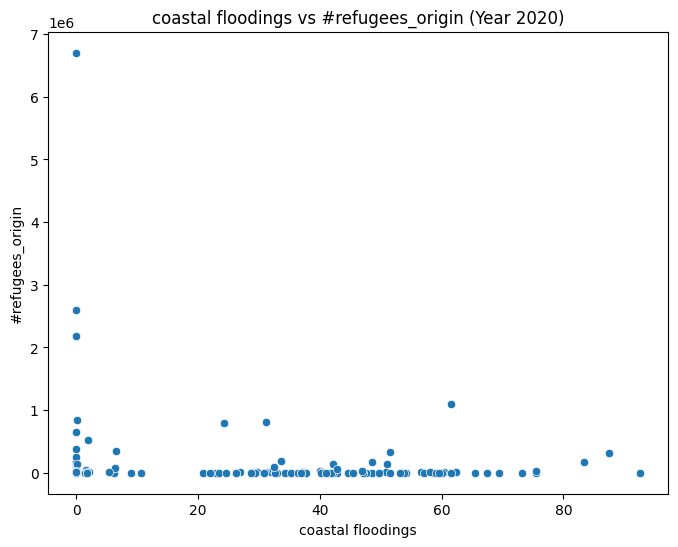

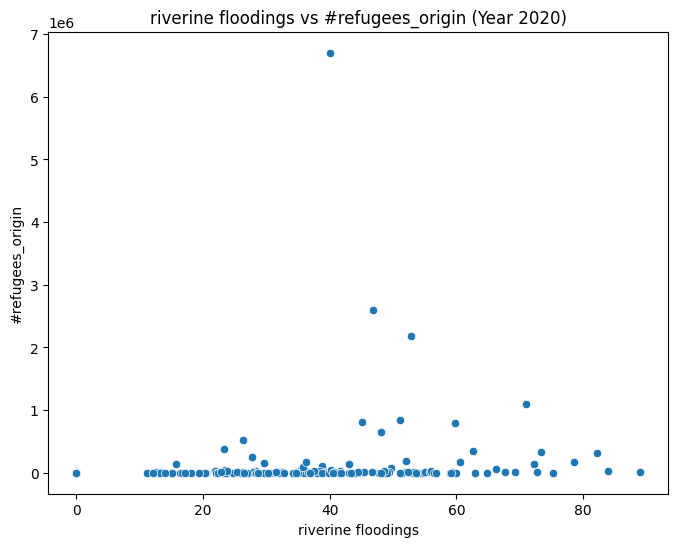

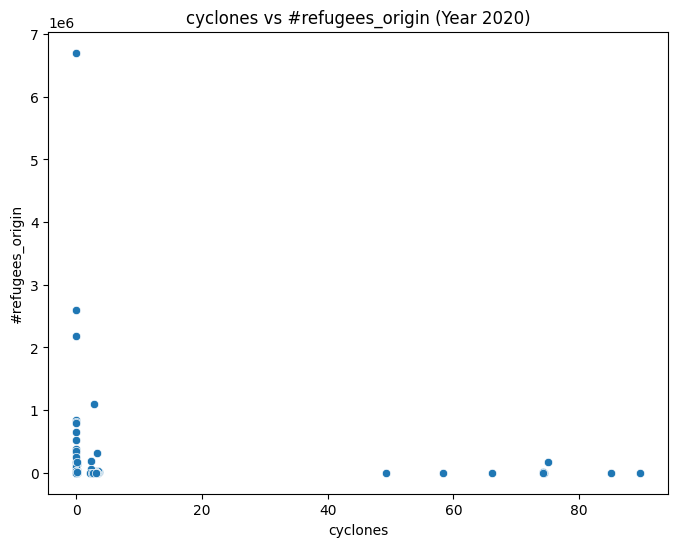

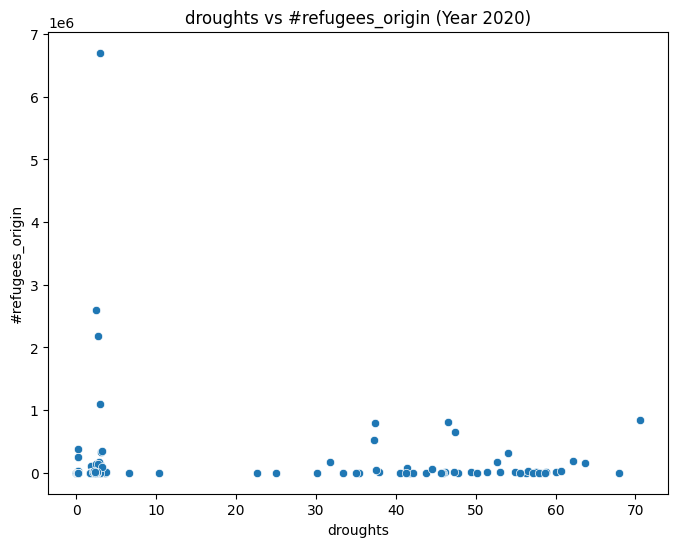

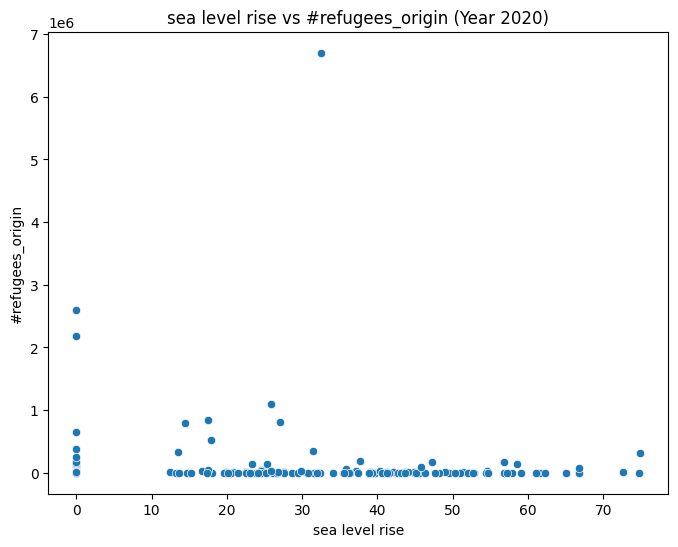

...

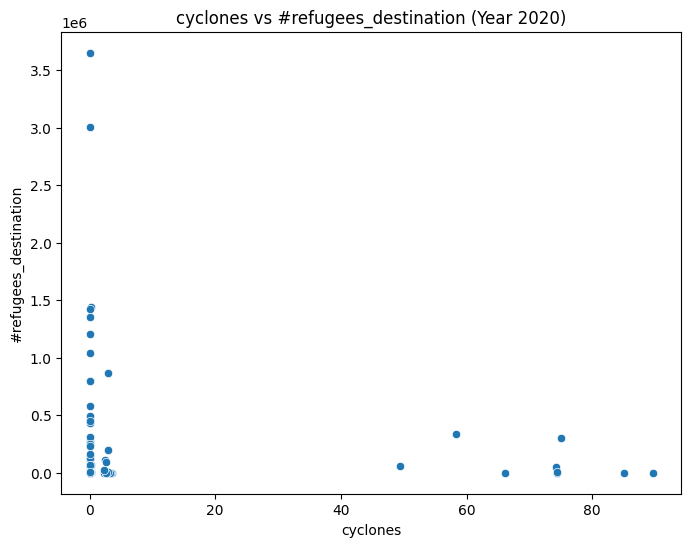

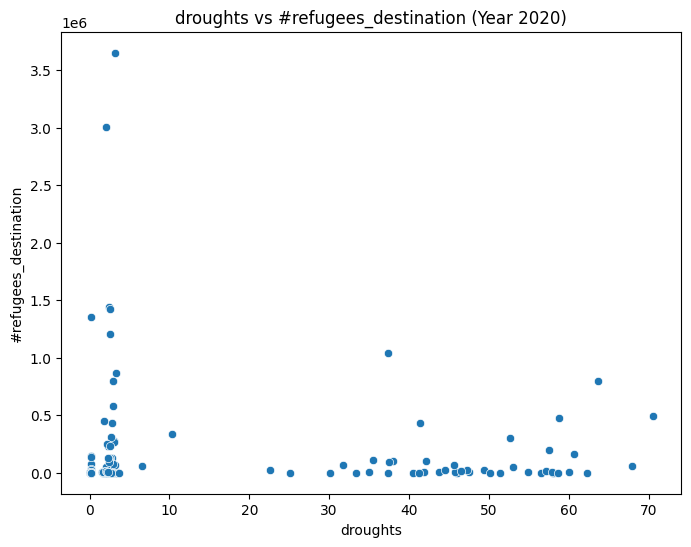

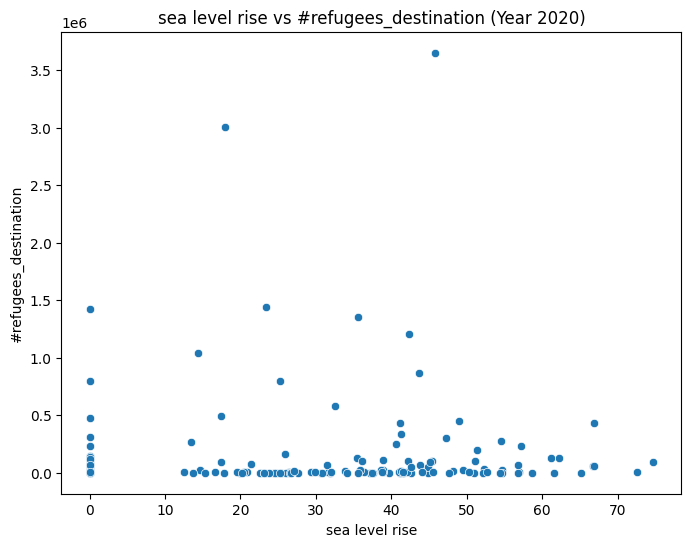

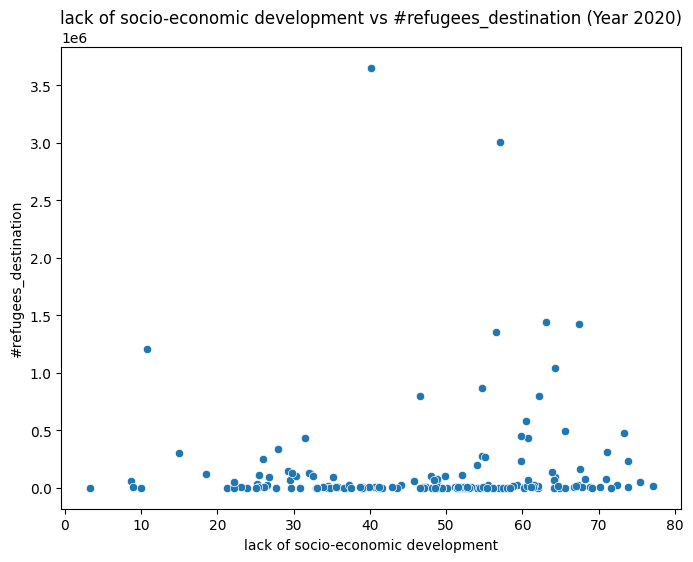

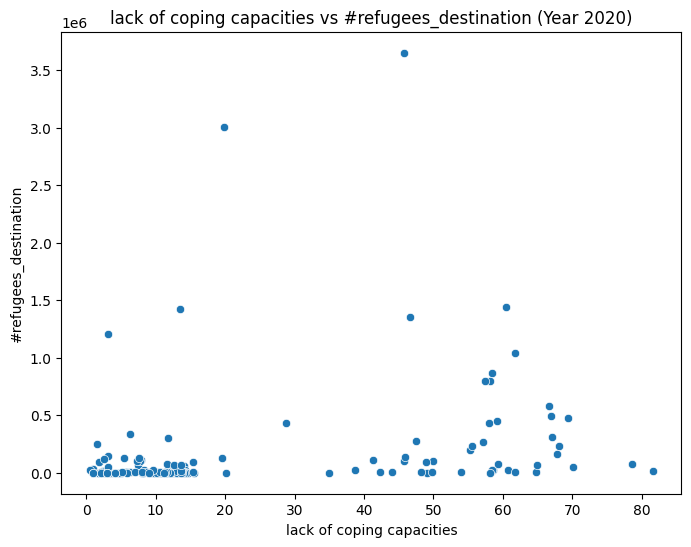

In [146]:
import statsmodels.api as sm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Function to perform simple linear regression and store results
def run_simple_regression_and_store(df, dependent_var):
    results = []
    performance_metrics = []
    plots = []  # List to store plots
    
    # Get unique indicators excluding the dependent variable
    indicators = [col for col in df.columns if col in ['droughts', 'cyclones', 'sea level rise', 'riverine floodings', 'coastal floodings', 
                                 'lack of socio-economic development', 'lack of coping capacities']]

    years = df['Year'].unique()

    for year in years:
        data_year = df[df['Year'] == year]

        for indicator in indicators:
            X = data_year[indicator].values.reshape(-1, 1)
            y = data_year[dependent_var].values.reshape(-1, 1)

            # Add a constant to the model (intercept)
            X = sm.add_constant(X)

            # Fit the model
            model = sm.OLS(y, X).fit()

            # Predictions
            predictions = model.predict(X)

            # Calculate performance metrics
            r_squared = model.rsquared
            adj_r_squared = model.rsquared_adj
            mae = mean_absolute_error(y, predictions)
            mse = mean_squared_error(y, predictions)
            rmse = np.sqrt(mse)
            
            # Store the performance metrics
            performance_metrics.append({
                'Year': year,
                'Variable': indicator,
                'R_squared': r_squared,
                'Adjusted_R_squared': adj_r_squared,
                'MAE': mae,
                'MSE': mse,
                'RMSE': rmse
            })

            # Store the results
            coef = model.params[1]  # Coefficient of the indicator
            p_value = model.pvalues[1]  # p-value of the indicator
            conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
            direction = 'Positive' if coef > 0 else 'Negative'
            results.append({
                'Year': year, 
                'Variable': indicator, 
                'Coefficient': coef, 
                'P-value': p_value, 
                'Conclusion': conclusion,
                'Direction': direction
            })
            
            # Plotting for the year 2020
            if year == 2020:
                if indicator in ['droughts', 'cyclones', 'sea level rise', 'riverine floodings', 'coastal floodings', 
                                 'lack of socio-economic development', 'lack of coping capacities']:
                    plt.figure(figsize=(8, 6))
                    sns.scatterplot(x=data_year[indicator], y=data_year[dependent_var])
                    plt.title(f'{indicator} vs {dependent_var} (Year {year})')
                    plt.xlabel(indicator)
                    plt.ylabel(dependent_var)
                    plots.append(plt)
            
    return pd.DataFrame(results), pd.DataFrame(performance_metrics), plots

# Run regression for origin and destination
origin_results_df, origin_performance_df, origin_plots = run_simple_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin')
destination_results_df, destination_performance_df, destination_plots = run_simple_regression_and_store(refugeedestination_worldrisk, '#refugees_destination')

# Show or save the plots
for idx, plot in enumerate(origin_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'origin_{idx}.png')

for idx, plot in enumerate(destination_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'destination_{idx}.png')

In [147]:
origin_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,-424.038222,4.629423e-01,Not Significant,Negative
1,2003,riverine floodings,1561.054426,1.804658e-02,Significant,Positive
2,2003,cyclones,-544.161908,5.396629e-01,Not Significant,Negative
3,2003,droughts,663.779589,3.184945e-01,Not Significant,Positive
4,2003,sea level rise,-1464.115761,2.984222e-02,Significant,Negative
...,...,...,...,...,...,...
135,2022,cyclones,-2302.044400,5.401264e-01,Not Significant,Negative
136,2022,droughts,-1178.733817,6.725284e-01,Not Significant,Negative
137,2022,sea level rise,-3116.095725,2.648861e-01,Not Significant,Negative
138,2022,lack of socio-economic development,9214.870100,1.845775e-02,Significant,Positive


In [148]:
origin_performance_df

,Year,Variable,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,coastal floodings,0.003100,-0.002629,76537.492567,3.470538e+10,186293.793288
1,2003,riverine floodings,0.031714,0.026149,72023.925331,3.370924e+10,183600.759832
2,2003,cyclones,0.002166,-0.003569,76381.867820,3.473792e+10,186381.111872
3,2003,droughts,0.005719,0.000005,75331.834881,3.461421e+10,186048.956820
4,2003,sea level rise,0.026828,0.021235,74993.537472,3.387933e+10,184063.384732
...,...,...,...,...,...,...,...
135,2022,cyclones,0.002100,-0.003475,270669.806020,6.233021e+11,789494.856573
136,2022,droughts,0.001000,-0.004581,271812.619577,6.239892e+11,789929.853011
137,2022,sea level rise,0.006940,0.001392,266189.134954,6.202795e+11,787578.230810
138,2022,lack of socio-economic development,0.030626,0.025210,274191.431340,6.054849e+11,778129.106703


In [149]:
destination_results_df

,Year,Variable,Coefficient,P-value,Conclusion,Direction
0,2003,coastal floodings,862.431601,0.247081,Not Significant,Positive
1,2003,riverine floodings,887.056732,0.385244,Not Significant,Positive
2,2003,cyclones,207.179788,0.860233,Not Significant,Positive
3,2003,droughts,-571.065187,0.501795,Not Significant,Negative
4,2003,sea level rise,374.474634,0.665925,Not Significant,Positive
...,...,...,...,...,...,...
135,2022,cyclones,-2238.225069,0.415204,Not Significant,Negative
136,2022,droughts,-1473.714663,0.470698,Not Significant,Negative
137,2022,sea level rise,863.106915,0.676172,Not Significant,Positive
138,2022,lack of socio-economic development,40.476779,0.988080,Not Significant,Positive


In [150]:
destination_performance_df

,Year,Variable,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,coastal floodings,0.009423,0.002447,112850.661216,4.825581e+10,219672.050955
1,2003,riverine floodings,0.005314,-0.001691,112734.335981,4.845601e+10,220127.253360
2,2003,cyclones,0.000219,-0.006822,114708.935797,4.870419e+10,220690.263572
3,2003,droughts,0.003183,-0.003837,115962.837846,4.855980e+10,220362.877716
4,2003,sea level rise,0.001316,-0.005717,114264.985274,4.865073e+10,220569.110834
...,...,...,...,...,...,...,...
135,2022,cyclones,0.004233,-0.002110,283140.334707,2.950348e+11,543171.022340
136,2022,droughts,0.003319,-0.003029,284046.715832,2.953054e+11,543420.128727
137,2022,sea level rise,0.001114,-0.005248,283514.576001,2.959588e+11,544020.944727
138,2022,lack of socio-economic development,0.000001,-0.006368,284125.136017,2.962885e+11,544323.877531


With log shift in y.

In [151]:
independent_vars = ['coastal floodings', 'riverine floodings',
       'cyclones', 'droughts', 'sea level rise', 'lack of socio-economic development',
       'lack of coping capacities',
       'coastal floodings * riverine floodings',
       'coastal floodings * cyclones', 'coastal floodings * droughts',
       'coastal floodings * lack of socio-economic development',
       'coastal floodings * lack of coping capacities',
       'coastal floodings * sea level rise', 'riverine floodings * cyclones',
       'riverine floodings * droughts',
       'riverine floodings * lack of socio-economic development',
       'riverine floodings * lack of coping capacities',
       'riverine floodings * sea level rise', 'cyclones * droughts',
       'cyclones * lack of socio-economic development',
       'cyclones * lack of coping capacities', 'cyclones * sea level rise',
       'droughts * lack of socio-economic development',
       'droughts * lack of coping capacities', 'droughts * sea level rise',
       'lack of socio-economic development * lack of coping capacities',
       'lack of socio-economic development * sea level rise',
       'lack of coping capacities * sea level rise', 'coastal floodings^2',
       'riverine floodings^2', 'cyclones^2', 'droughts^2',
       'lack of socio-economic development^2', 'lack of coping capacities^2',
       'sea level rise^2', 'coastal floodings^3', 'riverine floodings^3',
       'cyclones^3', 'droughts^3', 'lack of socio-economic development^3',
       'lack of coping capacities^3', 'sea level rise^3']

In [152]:
independent_vars = ['droughts', 'cyclones', 'sea level rise', 'riverine floodings', 'coastal floodings', 
                                 'lack of socio-economic development', 'lack of coping capacities']

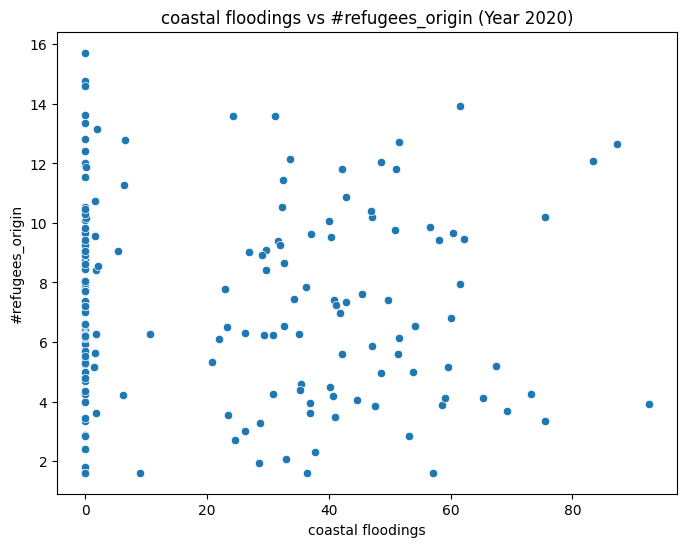

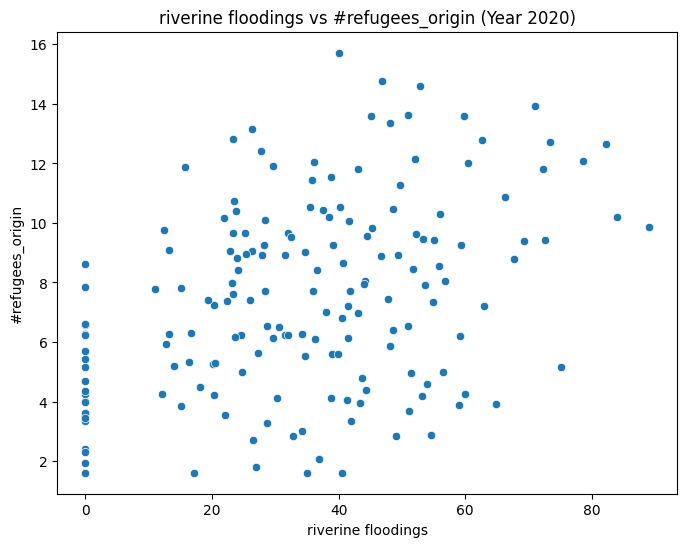

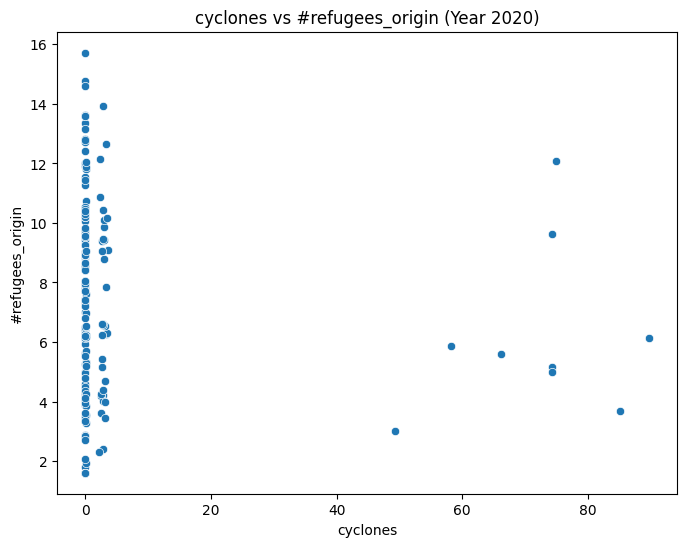

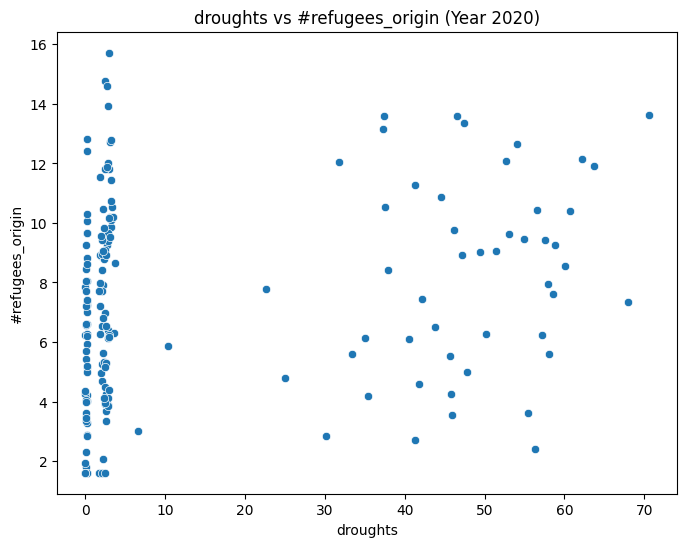

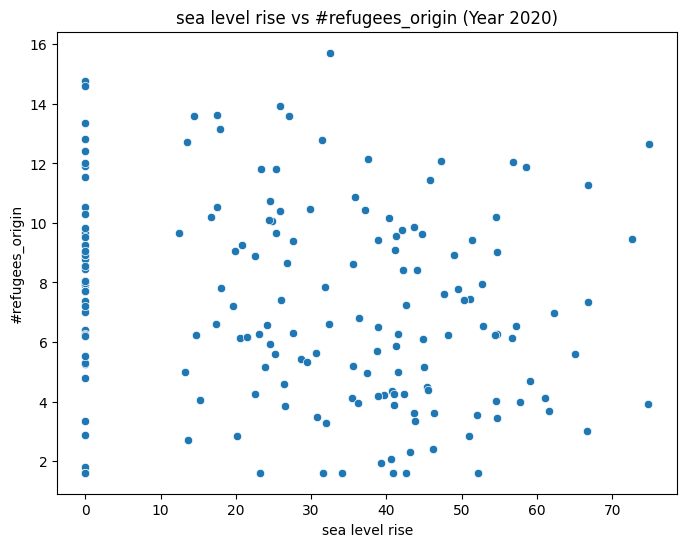

...

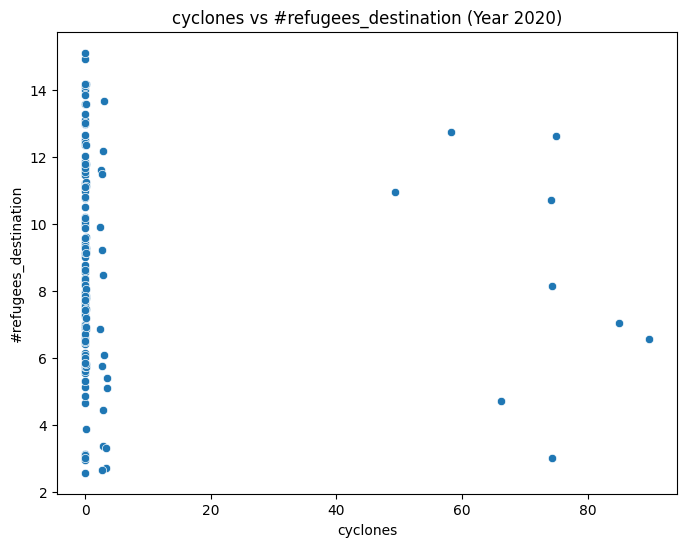

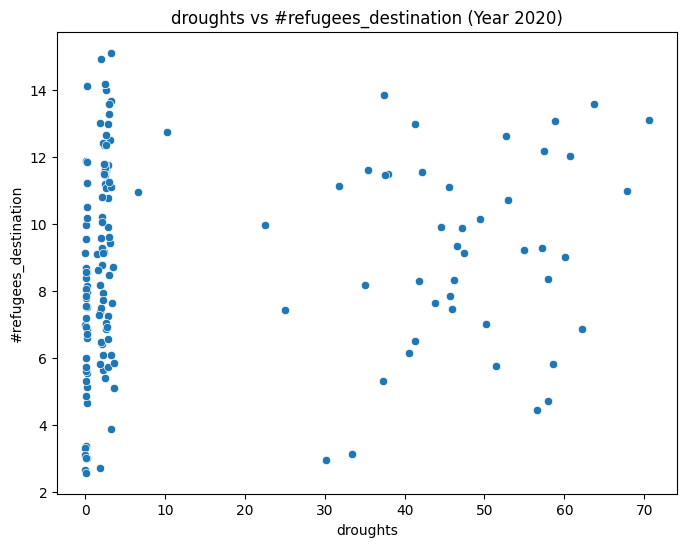

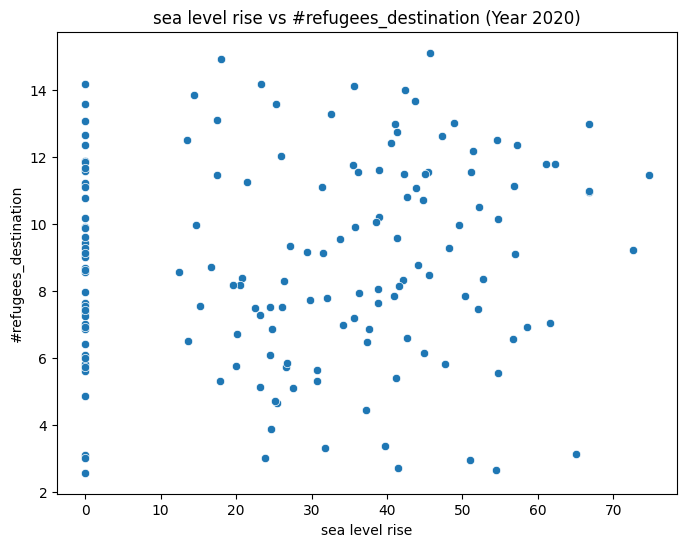

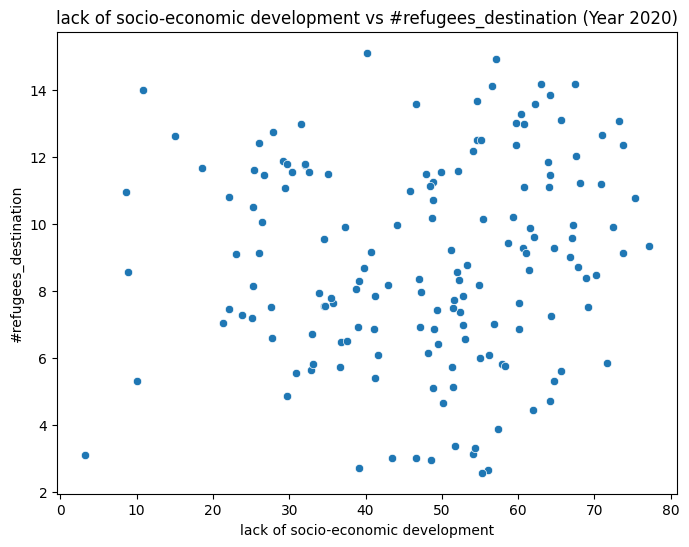

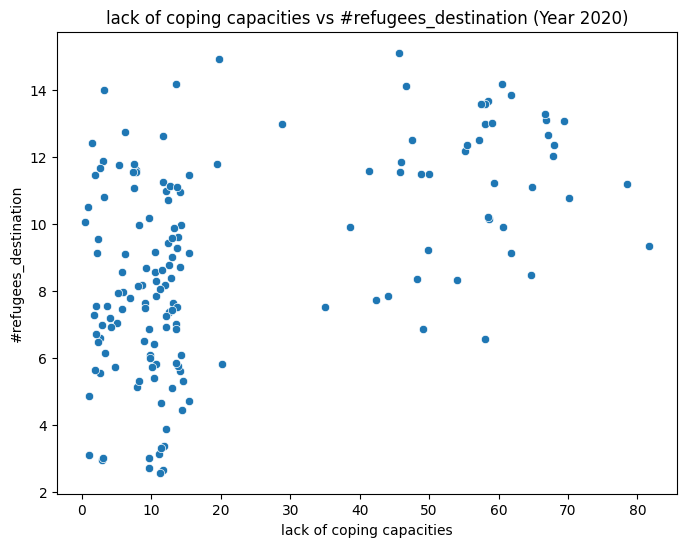

In [153]:
import statsmodels.api as sm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Function to perform simple linear regression and store results
def run_simple_regression_and_store(df, dependent_var):
    results = []
    performance_metrics = []
    plots = []  # List to store plots
    
    # Get unique indicators excluding the dependent variable
    indicators = [col for col in df.columns if col in independent_vars]

    years = df['Year'].unique()

    for year in years:
        data_year = df[df['Year'] == year]

        for indicator in indicators:
            X = data_year[indicator].values.reshape(-1, 1)
            y = np.log(data_year[dependent_var].values.reshape(-1, 1))

            # Add a constant to the model (intercept)
            X = sm.add_constant(X)

            # Fit the model
            model = sm.OLS(y, X).fit()
            
            # Predictions
            predictions = model.predict(X)

            # Calculate performance metrics
            r_squared = model.rsquared
            adj_r_squared = model.rsquared_adj
            mae = mean_absolute_error(y, predictions)
            mse = mean_squared_error(y, predictions)
            rmse = np.sqrt(mse)

            # Store the performance metrics
            performance_metrics.append({
                'Year': year,
                'Variable': indicator,
                'R_squared': r_squared,
                'Adjusted_R_squared': adj_r_squared,
                'MAE': mae,
                'MSE': mse,
                'RMSE': rmse
            })

            # Store the results
            coef = model.params[1]  # Coefficient of the indicator
            p_value = model.pvalues[1]  # p-value of the indicator
            conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
            direction = 'Positive' if coef > 0 else 'Negative'
            results.append({
                'Year': year, 
                'Variable': indicator, 
                'Coefficient': coef, 
                'P-value': p_value, 
                'Conclusion': f'{conclusion}'
            })
            
            # Plotting for the year 2020
            if year == 2020:
                if indicator in ['droughts', 'cyclones', 'sea level rise', 'riverine floodings', 'coastal floodings', 
                                 'lack of socio-economic development', 'lack of coping capacities']:
                    plt.figure(figsize=(8, 6))
                    sns.scatterplot(x=data_year[indicator], y=np.log(data_year[dependent_var]))
                    plt.title(f'{indicator} vs {dependent_var} (Year {year})')
                    plt.xlabel(indicator)
                    plt.ylabel(dependent_var)
                    plots.append(plt)
            
    return pd.DataFrame(results), pd.DataFrame(performance_metrics), plots

# Run regression for origin and destination
origin_results_df, origin_performance_df, origin_plots = run_simple_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin')
destination_results_df, destination_performance_df, destination_plots = run_simple_regression_and_store(refugeedestination_worldrisk, '#refugees_destination')

# Show or save the plots
for idx, plot in enumerate(origin_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'origin_{idx}.png')

for idx, plot in enumerate(destination_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'destination_{idx}.png')

In [154]:
origin_results_df

,Year,Variable,Coefficient,P-value,Conclusion
0,2003,coastal floodings,-0.004506,6.613640e-01,Not Significant
1,2003,riverine floodings,0.077782,1.896066e-12,Significant
2,2003,cyclones,-0.019168,2.240467e-01,Not Significant
3,2003,droughts,0.030870,8.564215e-03,Significant
4,2003,sea level rise,-0.042213,3.720270e-04,Significant
...,...,...,...,...,...
135,2022,cyclones,-0.012475,4.322218e-01,Not Significant
136,2022,droughts,0.035668,2.184245e-03,Significant
137,2022,sea level rise,-0.029453,1.207551e-02,Significant
138,2022,lack of socio-economic development,0.113340,2.530041e-13,Significant


In [155]:
origin_performance_df

,Year,Variable,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,coastal floodings,0.001105,-0.004636,2.806873,11.014721,3.318843
1,2003,riverine floodings,0.248582,0.244263,2.383478,8.285821,2.878510
2,2003,cyclones,0.008484,0.002786,2.788072,10.933357,3.306563
3,2003,droughts,0.039052,0.033530,2.785367,10.596283,3.255193
4,2003,sea level rise,0.070409,0.065067,2.665846,10.250510,3.201642
...,...,...,...,...,...,...,...
135,2022,cyclones,0.003450,-0.002118,2.775092,11.128958,3.336009
136,2022,droughts,0.051233,0.045933,2.713640,10.595336,3.255048
137,2022,sea level rise,0.034677,0.029284,2.706371,10.780231,3.283326
138,2022,lack of socio-economic development,0.259136,0.254997,2.254411,8.273586,2.876384


In [156]:
origin_performance_df[origin_performance_df['Variable']=='lack of coping capacities']

,Year,Variable,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
6,2003,lack of coping capacities,0.342071,0.338290,2.212510,7.254918,2.693495
13,2004,lack of coping capacities,0.338439,0.334548,2.140919,6.880622,2.623094
20,2005,lack of coping capacities,0.358016,0.354283,2.067461,6.409478,2.531695
27,2006,lack of coping capacities,0.359515,0.355897,2.043889,6.143796,2.478668
34,2007,lack of coping capacities,0.427575,0.424304,1.868672,5.252788,2.291896
41,2008,lack of coping capacities,0.367187,0.363592,2.012015,5.929635,2.435084
48,2009,lack of coping capacities,0.342449,0.338713,2.089324,6.263153,2.502629
55,2010,lack of coping capacities,0.327602,0.323803,2.126680,6.420570,2.533884
62,2011,lack of coping capacities,0.354076,0.350447,2.057004,6.128834,2.475648
69,2012,lack of coping capacities,0.396542,0.393171,1.979913,5.698915,2.387240


In [157]:
destination_results_df

,Year,Variable,Coefficient,P-value,Conclusion
0,2003,coastal floodings,0.009086,3.443626e-01,Not Significant
1,2003,riverine floodings,0.034119,8.803443e-03,Significant
2,2003,cyclones,-0.007078,6.405490e-01,Not Significant
3,2003,droughts,0.010195,3.517608e-01,Not Significant
4,2003,sea level rise,0.005271,6.372141e-01,Not Significant
...,...,...,...,...,...
135,2022,cyclones,-0.013135,4.128252e-01,Not Significant
136,2022,droughts,-0.002172,8.556334e-01,Not Significant
137,2022,sea level rise,0.004559,7.055634e-01,Not Significant
138,2022,lack of socio-economic development,-0.010549,5.045482e-01,Not Significant


In [158]:
destination_performance_df

,Year,Variable,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,coastal floodings,0.006299,-0.000699,2.329452,8.038742,2.835268
1,2003,riverine floodings,0.047339,0.040630,2.253375,7.706744,2.776102
2,2003,cyclones,0.001540,-0.005492,2.345820,8.077244,2.842049
3,2003,droughts,0.006109,-0.000890,2.335991,8.040278,2.835538
4,2003,sea level rise,0.001571,-0.005461,2.344218,8.076994,2.842005
...,...,...,...,...,...,...,...
135,2022,cyclones,0.004276,-0.002066,2.619056,10.056951,3.171270
136,2022,droughts,0.000211,-0.006157,2.625827,10.098005,3.177736
137,2022,sea level rise,0.000912,-0.005452,2.626005,10.090932,3.176623
138,2022,lack of socio-economic development,0.002842,-0.003510,2.624404,10.071439,3.173553


With both x and y being log scaled.

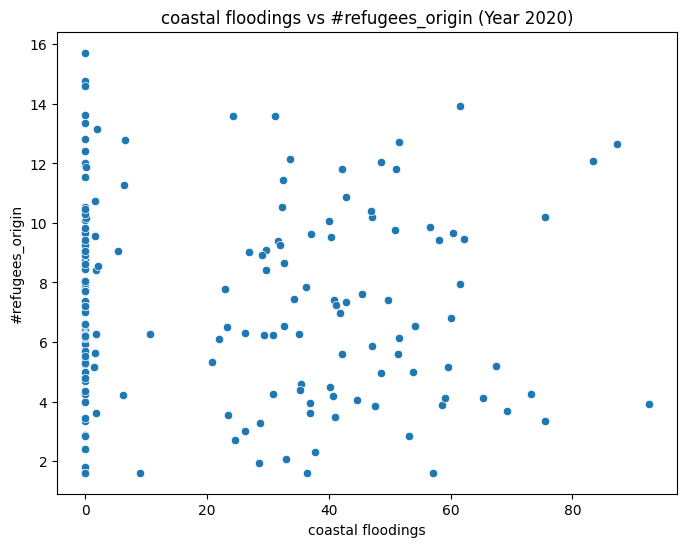

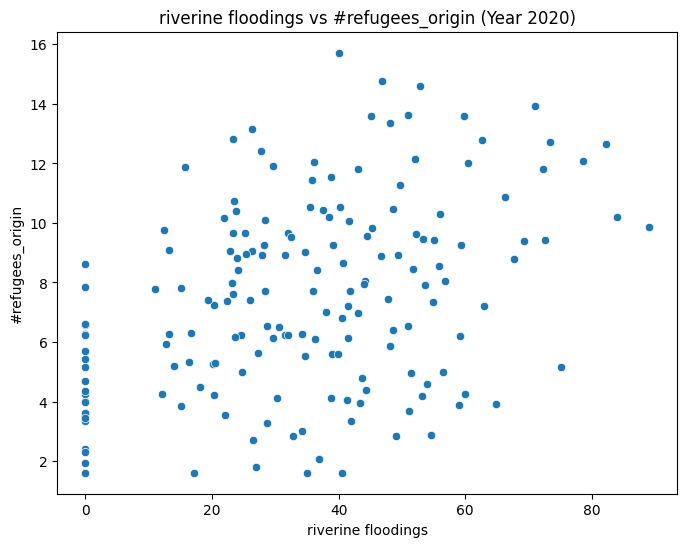

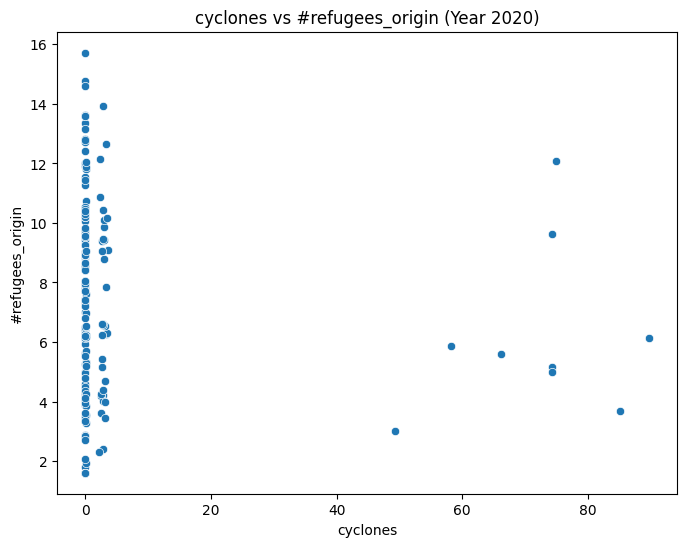

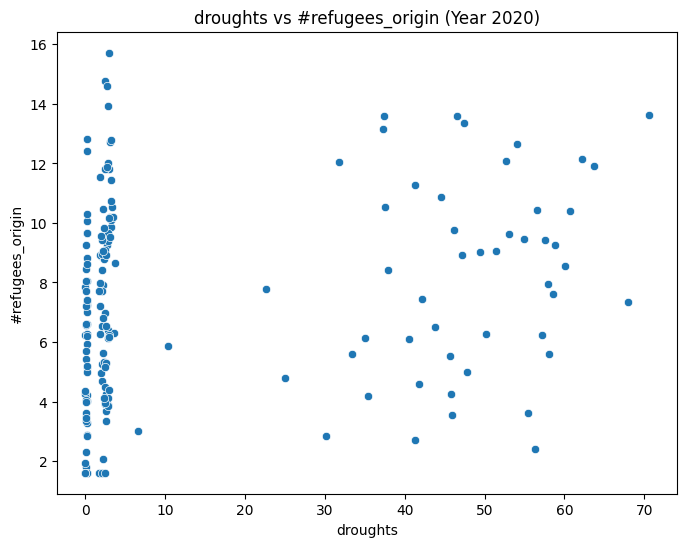

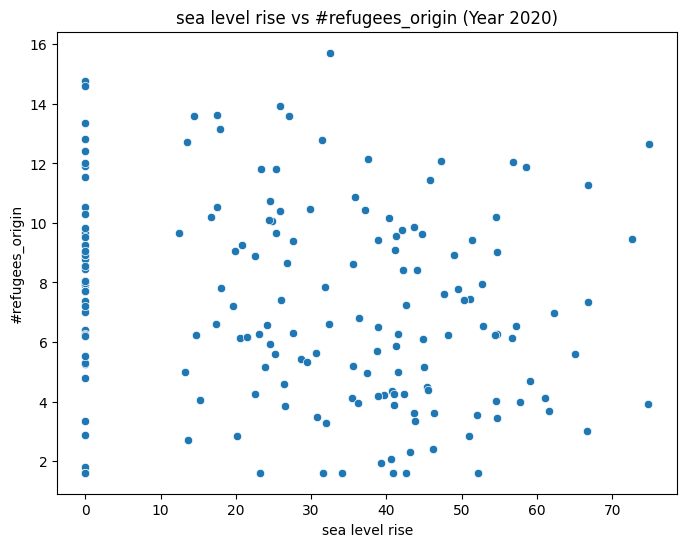

...

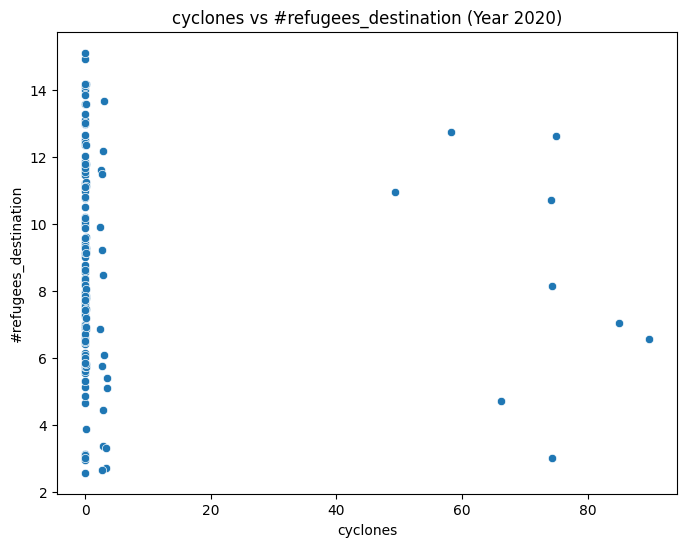

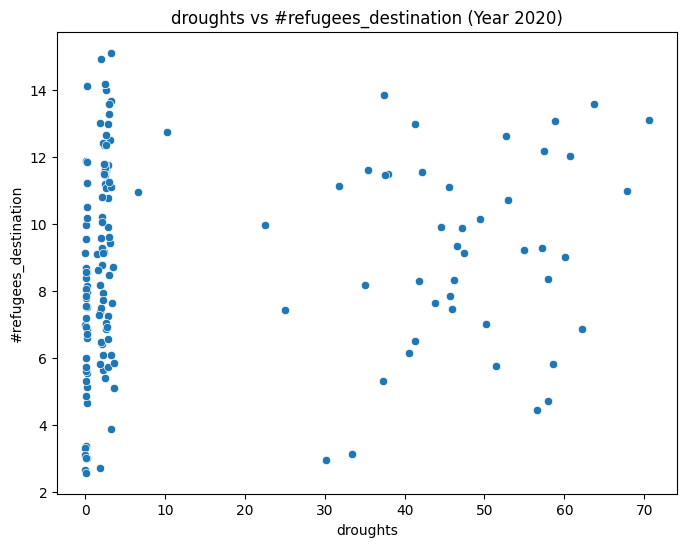

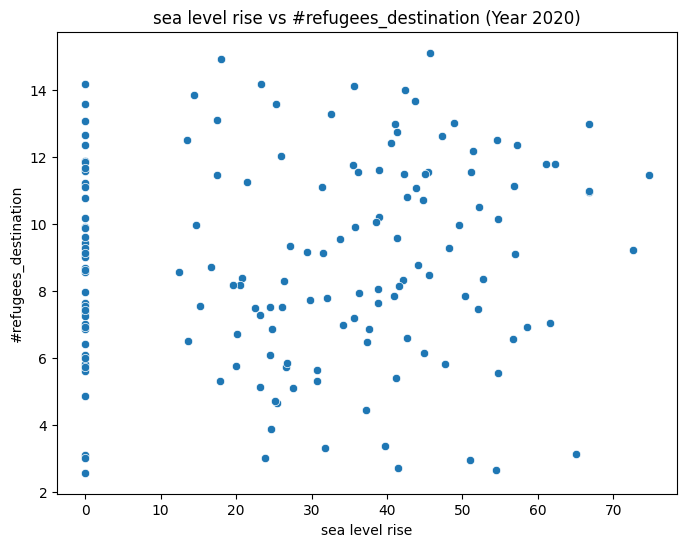

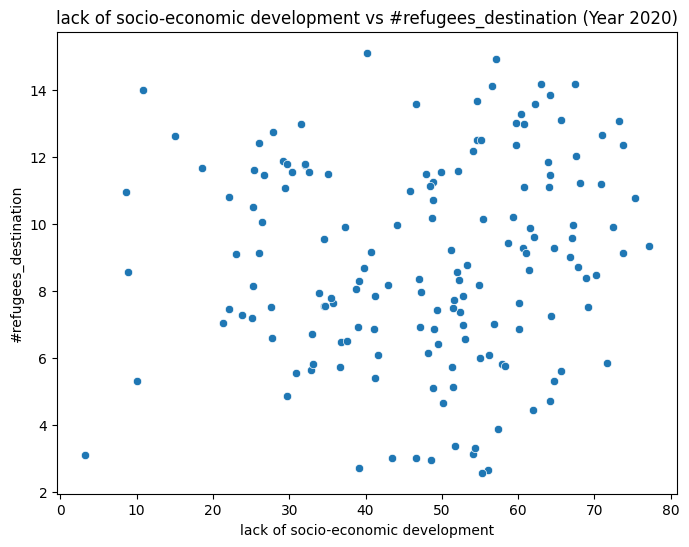

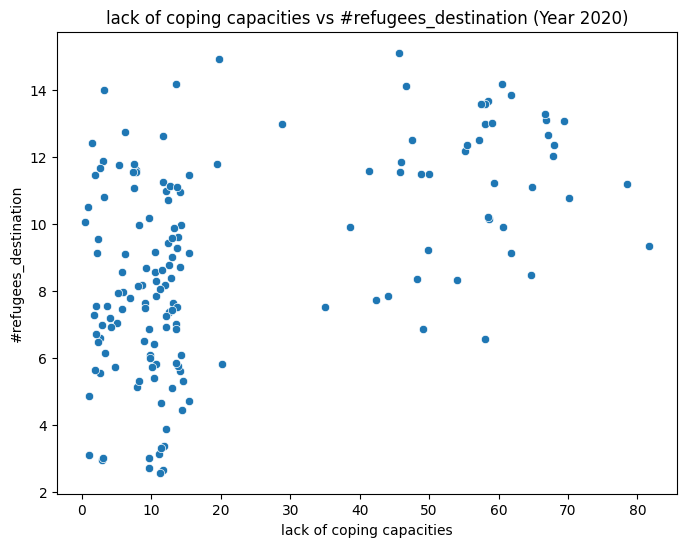

In [159]:
import statsmodels.api as sm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Function to perform simple linear regression and store results
def run_simple_regression_and_store(df, dependent_var):
    results = []
    performance_metrics = []
    plots = []  # List to store plots
    
    # Get unique indicators excluding the dependent variable
    indicators = [col for col in df.columns if col in independent_vars]

    years = df['Year'].unique()

    for year in years:
        data_year = df[df['Year'] == year]

        for indicator in indicators:
            X = np.log(data_year[indicator].values.reshape(-1, 1))
            y = np.log(data_year[dependent_var].values.reshape(-1, 1))

            # Add a constant to the model (intercept)
            X = sm.add_constant(X)

            # Fit the model
            model = sm.OLS(y, X).fit()
            
            # Predictions
            predictions = model.predict(X)

            # Calculate performance metrics
            r_squared = model.rsquared
            adj_r_squared = model.rsquared_adj
            mae = mean_absolute_error(y, predictions)
            mse = mean_squared_error(y, predictions)
            rmse = np.sqrt(mse)

            # Store the performance metrics
            performance_metrics.append({
                'Year': year,
                'Variable': indicator,
                'R_squared': r_squared,
                'Adjusted_R_squared': adj_r_squared,
                'MAE': mae,
                'MSE': mse,
                'RMSE': rmse
            })

            # Store the results
            coef = model.params[1]  # Coefficient of the indicator
            p_value = model.pvalues[1]  # p-value of the indicator
            conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
            direction = 'Positive' if coef > 0 else 'Negative'
            results.append({
                'Year': year, 
                'Variable': indicator, 
                'Coefficient': coef, 
                'P-value': p_value, 
                'Conclusion': f'{conclusion}'
            })
            
            # Plotting for the year 2020
            if year == 2020:
                if indicator in ['droughts', 'cyclones', 'sea level rise', 'riverine floodings', 'coastal floodings', 
                                 'lack of socio-economic development', 'lack of coping capacities']:
                    plt.figure(figsize=(8, 6))
                    sns.scatterplot(x=data_year[indicator], y=np.log(data_year[dependent_var]))
                    plt.title(f'{indicator} vs {dependent_var} (Year {year})')
                    plt.xlabel(indicator)
                    plt.ylabel(dependent_var)
                    plots.append(plt)
            
    return pd.DataFrame(results), pd.DataFrame(performance_metrics), plots

# Run regression for origin and destination
origin_results_df, origin_performance_df, origin_plots = run_simple_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin')
destination_results_df, destination_performance_df, destination_plots = run_simple_regression_and_store(refugeedestination_worldrisk, '#refugees_destination')

# Show or save the plots
for idx, plot in enumerate(origin_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'origin_{idx}.png')

for idx, plot in enumerate(destination_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'destination_{idx}.png')

In [160]:
origin_performance_df

,Year,Variable,R_squared,Adjusted_R_squared,MAE,MSE,RMSE
0,2003,coastal floodings,0.004045,-0.001679,2.800608,10.982303,3.313956
1,2003,riverine floodings,0.246960,0.242632,2.355410,8.303703,2.881615
2,2003,cyclones,0.028680,0.023098,2.743579,10.710657,3.272714
3,2003,droughts,0.074924,0.069607,2.758790,10.200733,3.193859
4,2003,sea level rise,0.045528,0.040042,2.709606,10.524878,3.244207
...,...,...,...,...,...,...,...
135,2022,cyclones,0.019766,0.014290,2.724964,10.946742,3.308586
136,2022,droughts,0.115558,0.110617,2.635008,9.876989,3.142768
137,2022,sea level rise,0.015607,0.010107,2.735034,10.993197,3.315599
138,2022,lack of socio-economic development,0.223903,0.219567,2.345159,8.667048,2.943985


Now with higher order effects, x^2 for example plotting against the dependent variable.

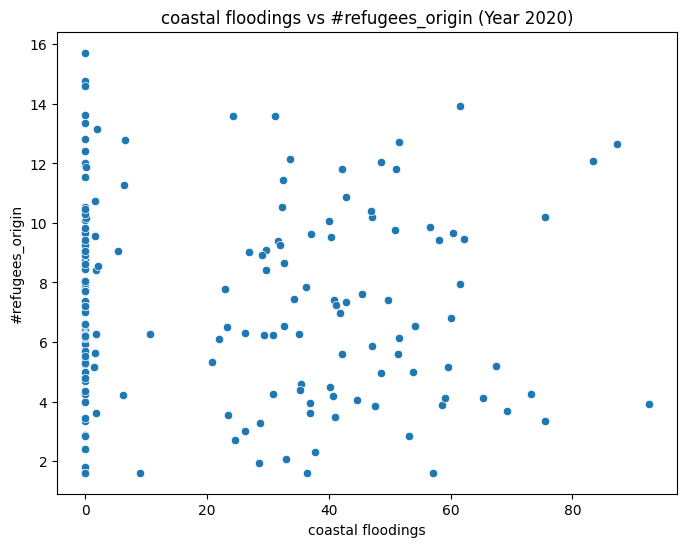

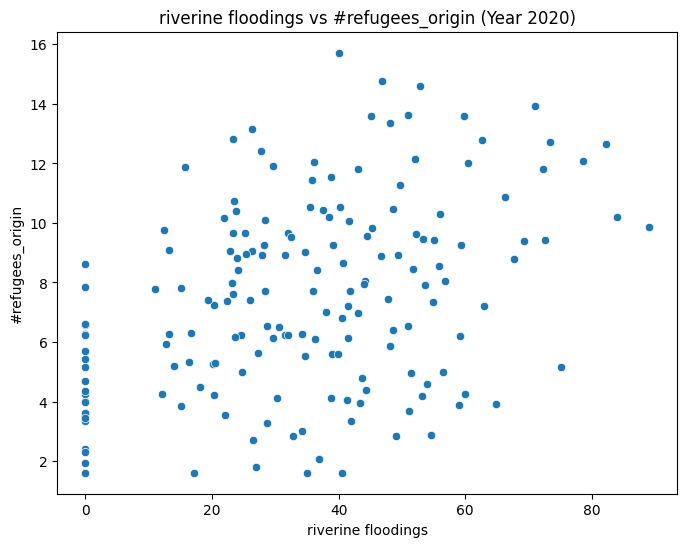

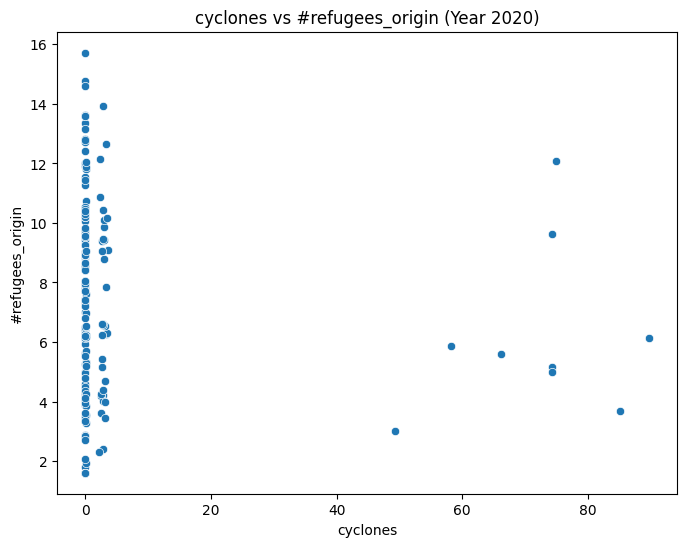

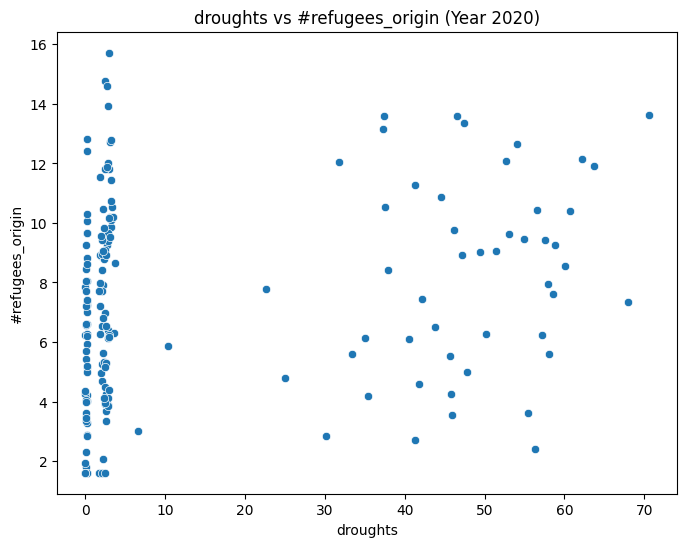

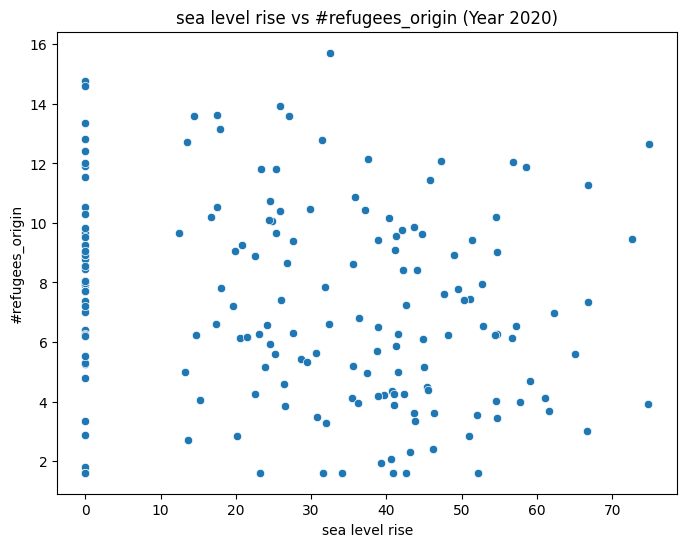

...

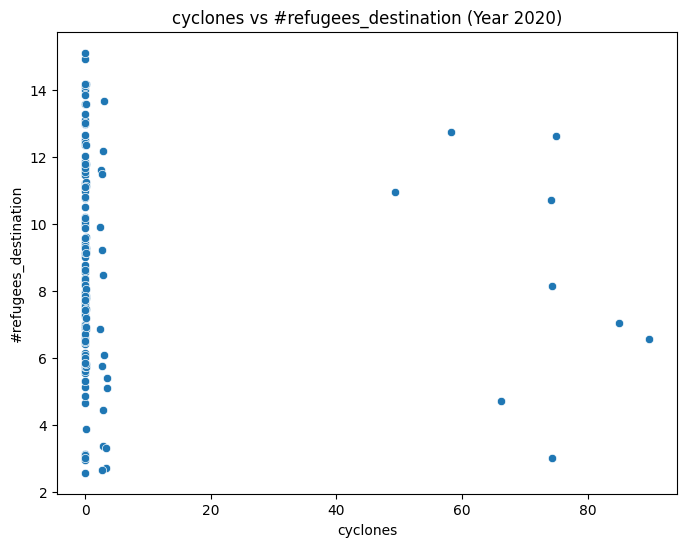

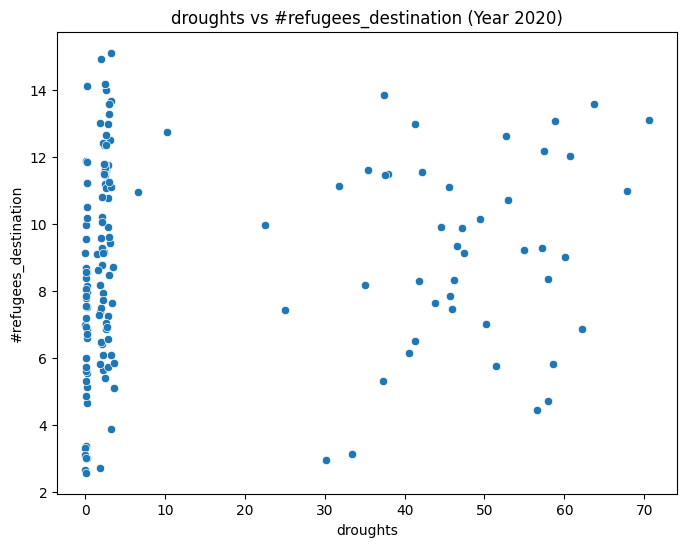

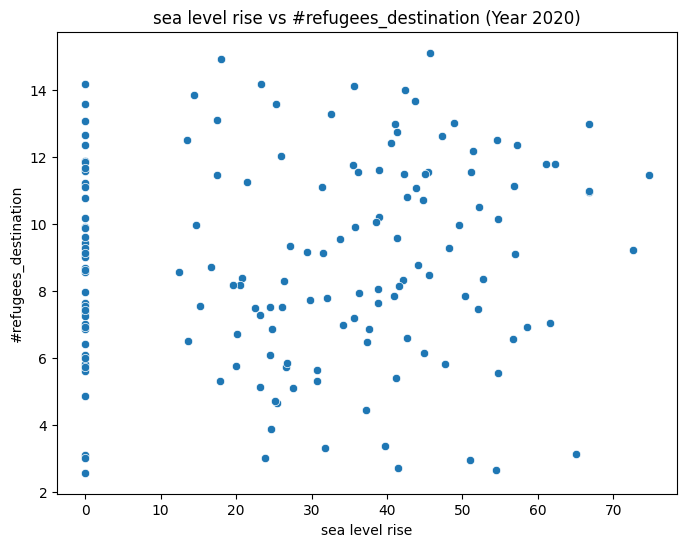

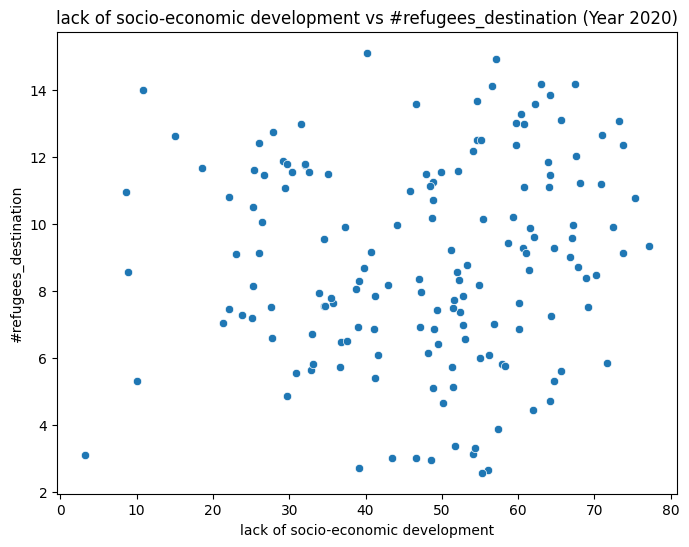

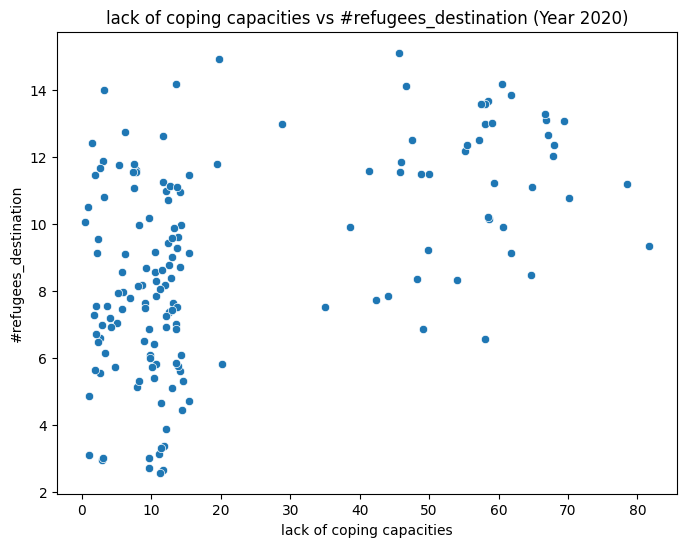

In [161]:
import statsmodels.api as sm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Function to perform simple linear regression and store results
def run_simple_regression_and_store(df, dependent_var):
    results = []
    performance_metrics = []
    plots = []  # List to store plots
    
    # Get unique indicators excluding the dependent variable
    indicators = [col for col in df.columns if col in independent_vars]

    years = df['Year'].unique()

    for year in years:
        data_year = df[df['Year'] == year]

        for indicator in indicators:
            X = np.power(data_year[indicator].values.reshape(-1, 1), 2) # CHANGE POWER BOTH HERE AND IN PLOT LINE BELOW.
            y = np.log(data_year[dependent_var].values.reshape(-1, 1)) 
            #print('big X', X)

            # Add a constant to the model (intercept)
            X = sm.add_constant(X)

            # Fit the model
            model = sm.OLS(y, X).fit()
            
            # Predictions
            predictions = model.predict(X)

            # Calculate performance metrics
            r_squared = model.rsquared
            adj_r_squared = model.rsquared_adj
            mae = mean_absolute_error(y, predictions)
            mse = mean_squared_error(y, predictions)
            rmse = np.sqrt(mse)

            # Store the performance metrics
            performance_metrics.append({
                'Year': year,
                'Variable': indicator,
                'R_squared': r_squared,
                'Adjusted_R_squared': adj_r_squared,
                'MAE': mae,
                'MSE': mse,
                'RMSE': rmse
            })

            # Store the results
            coef = model.params[1]  # Coefficient of the indicator
            p_value = model.pvalues[1]  # p-value of the indicator
            conclusion = 'Significant' if p_value < 0.05 else 'Not Significant'
            direction = 'Positive' if coef > 0 else 'Negative'
            results.append({
                'Year': year, 
                'Variable': indicator, 
                'Coefficient': coef, 
                'P-value': p_value, 
                'Conclusion': f'{conclusion}'
            })
            
            # Plotting for the year 2020
            if year == 2020:
                if indicator in ['droughts', 'cyclones', 'sea level rise', 'riverine floodings', 'coastal floodings', 
                                 'lack of socio-economic development', 'lack of coping capacities']:
                    plt.figure(figsize=(8, 6))
                    sns.scatterplot(x=np.power(data_year[indicator],1), y=np.log(data_year[dependent_var]))
                    #print('small x', np.power(data_year[indicator],1))
                    plt.title(f'{indicator} vs {dependent_var} (Year {year})')
                    plt.xlabel(indicator)
                    plt.ylabel(dependent_var)
                    plots.append(plt)
            
    return pd.DataFrame(results), pd.DataFrame(performance_metrics), plots

# Run regression for origin and destination
origin_results_df, origin_performance_df, origin_plots = run_simple_regression_and_store(refugeeorigin_worldrisk, '#refugees_origin')
destination_results_df, destination_performance_df, destination_plots = run_simple_regression_and_store(refugeedestination_worldrisk, '#refugees_destination')

# Show or save the plots
for idx, plot in enumerate(origin_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'origin_{idx}.png')

for idx, plot in enumerate(destination_plots):
    plot.show()
    # Save plots if needed
    # plot.savefig(f'destination_{idx}.png')